In [2]:
import dtw
import scanpy as sc
import numpy as np
import scanpy.external as sce
import pandas as pd
import scvelo as scv
import seaborn as sns
import matplotlib.pyplot as plt
import importlib
import sys
import symphonypy as sp
import palantir
import scFates as scf

%matplotlib inline

sys.path.append("/home/sergey/tools/sclitr/")
import sclitr as sl

# Pathes
DATA_PATH = "/home/sergey/data/clonal_project"
HOME_PATH = "/home/sergey/projects/clonal_project"

# Additional functions
exec(open(f"{HOME_PATH}/tools/tools.py").read())

sys.path.append("/home/sergey/tools/mmbench/")
import mmbench as mb

import warnings
warnings.filterwarnings("ignore")

import matplotlib

matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42

sc.set_figure_params(dpi=150, dpi_save=300)
sns.set_style("ticks")

In [9]:
pert_trunk = sc.read_h5ad("/home/sergey/data/clonal_project/cellxgene/clonal_clusters/whole_clonal_embedding.h5ad")
pert_face = sc.read_h5ad("/home/sergey/data/clonal_project/cellxgene/clonal_clusters/whole_clonal_embedding_face.h5ad")

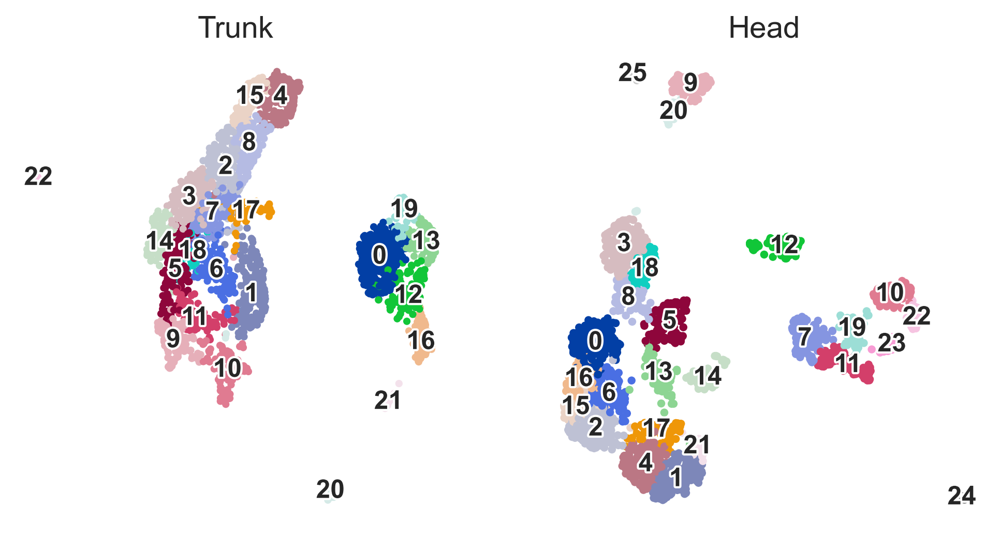

In [3]:
fig, axes = plt.subplots(ncols=2, figsize=(8, 4))

sc.pl.umap(pert_trunk, color="leiden_2", legend_loc="on data", legend_fontoutline=2, legend_fontsize=12,
           ax=axes[0], show=False, frameon=False, title="Trunk")
sc.pl.umap(pert_face, color="leiden_2", legend_loc="on data", legend_fontoutline=2, legend_fontsize=12,
           ax=axes[1], show=False, frameon=False, title="Head")

plt.savefig("../figures/fig6/clonal_clusters.pdf", bbox_inches="tight")

In [4]:
gRNAs = np.array(list(set(pert_trunk.obs.perturbation).union(set(pert_face.obs.perturbation))))
gRNAs_colors = dict(zip(gRNAs, sns.color_palette()[:len(gRNAs)]))
gRNAs_colors["NA"] = "#CCCCCC"

pert_trunk.uns["perturbation_colors"] = [gRNAs_colors[i] for i in pert_trunk.obs.perturbation.cat.categories]
pert_face.uns["perturbation_colors"] = [gRNAs_colors[i] for i in pert_face.obs.perturbation.cat.categories]

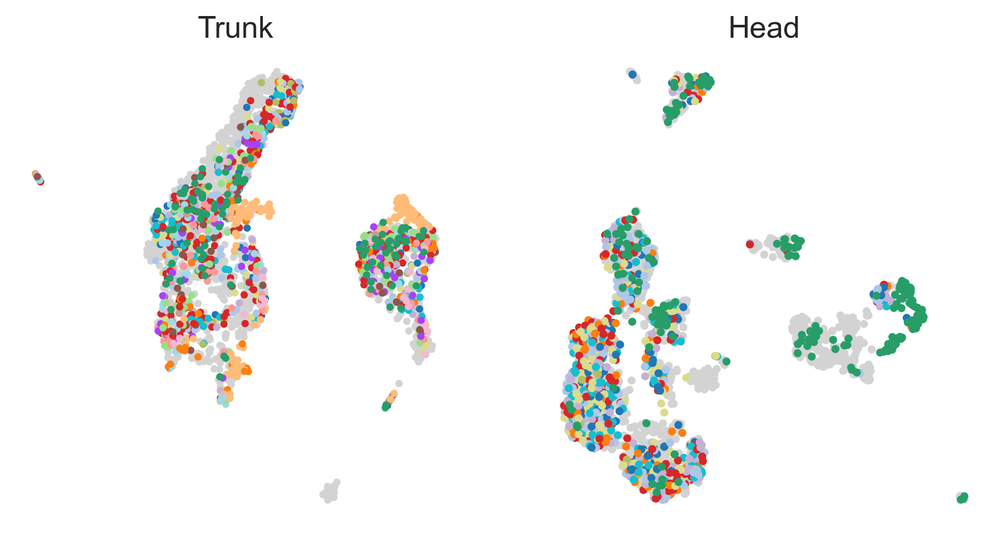

In [137]:
fig, axes = plt.subplots(ncols=2, figsize=(8, 4))

sc.pl.umap(pert_trunk, color="perturbation", groups=[i for i in set(pert_trunk.obs.perturbation) if i != "NA"],
           ax=axes[0], show=False, frameon=False, title="Trunk", na_in_legend=False, legend_loc=None)
sc.pl.umap(pert_face, color="perturbation", groups=[i for i in set(pert_face.obs.perturbation) if i != "NA"],
           ax=axes[1], show=False, frameon=False, title="Head", na_in_legend=False, legend_loc=None)

plt.savefig("../figures/fig6/perturbation_umap.pdf", bbox_inches="tight")

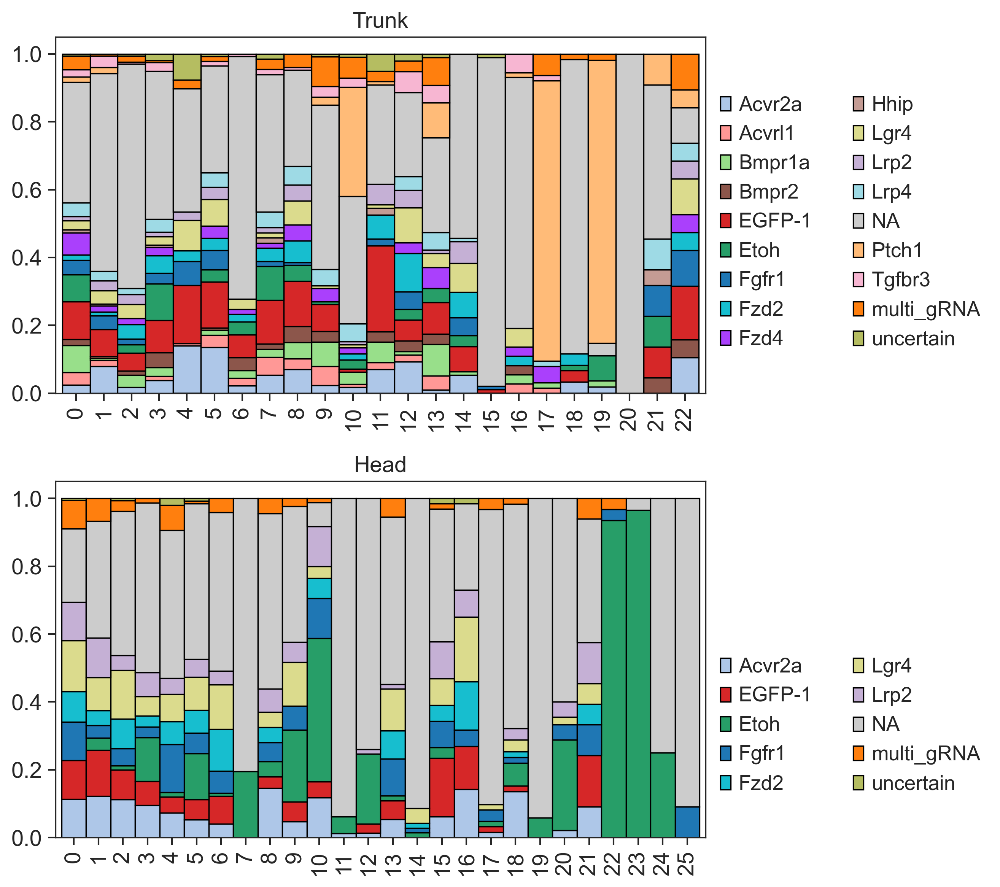

In [113]:
trunk_proportions = pert_trunk.obs[["leiden_2", "perturbation"]].groupby(["leiden_2", "perturbation"]).size().unstack()
trunk_proportions = (trunk_proportions.T / trunk_proportions.sum(axis=1)).T

head_proportions = pert_face.obs[["leiden_2", "perturbation"]].groupby(["leiden_2", "perturbation"]).size().unstack()
head_proportions = (head_proportions.T / head_proportions.sum(axis=1)).T

fig, axes = plt.subplots(nrows=2, figsize=(9, 8))
trunk_proportions.plot(kind="bar", stacked=True, ax=axes[0], edgecolor="black", width=1, color=gRNAs_colors)
axes[0].legend(ncols=2, loc=(1.01, 0.1), edgecolor="white")
axes[0].set_xlabel("")
axes[0].set_title("Trunk")

head_proportions.plot(kind="bar", stacked=True, ax=axes[1], edgecolor="black", width=1, color=gRNAs_colors)
axes[1].legend(ncols=2, loc=(1.01, 0.1), edgecolor="white")
axes[1].set_xlabel("")
axes[1].set_title("Head")

plt.tight_layout()

plt.savefig("../figures/fig6/barplots.pdf", bbox_inches="tight")

In [7]:
adata_trunk_crispr = sc.read_h5ad(f"/home/sergey/data/clonal_project/anndatas/perturbations/trunk_E13.h5ad")
adata_face_crispr = sc.read_h5ad(f"/home/sergey/data/clonal_project/anndatas/perturbations/face_E13.h5ad")

In [8]:
adata_trunk = sc.read_h5ad(f"{DATA_PATH}/anndatas/trunk_E13_reference.h5ad")
adata_trunk = adata_trunk[~adata_trunk.obs.celltype_l2.isin(["Doublets", "Doublet"])]
adata_trunk.obs["perturbation"] = "False"

In [9]:
adata_trunk = adata_trunk.raw.to_adata().concatenate(adata_trunk_crispr, batch_key=None, join="outer", fill_value=0, index_unique=None)
adata_trunk.var = pd.DataFrame(index=adata_trunk.var_names)
adata_trunk.obs["E7.5:clones"] = adata_trunk.obs["E7.5:clones"].fillna("NA").astype(str)
adata_trunk.obs["E8.5:clones"] = adata_trunk.obs["E8.5:clones"].fillna("NA").astype(str)

In [10]:
adata_face = sc.read_h5ad(f"{DATA_PATH}/anndatas/face_E13_reference.h5ad")
adata_face = adata_face[~adata_face.obs.celltype_l2.isin(["Doublets", "Doublet"])]
adata_face.obs["perturbation"] = "False"

In [11]:
adata_face = adata_face.raw.to_adata().concatenate(adata_face_crispr, batch_key=None, join="outer", fill_value=0, index_unique=None)
adata_face.var = pd.DataFrame(index=adata_face.var_names)
adata_face.obs["E7.5:clones"] = adata_face.obs["E7.5:clones"].fillna("NA").astype(str)
adata_face.obs["E8.5:clones"] = adata_face.obs["E8.5:clones"].fillna("NA").astype(str)

In [12]:
reannotation = []

for i, row in adata_trunk.obs.iterrows():
    if row.celltype_l0 in ["Mesenchyme", "Other"]:
        reannotation.append(row.celltype_l0)
    elif (row.celltype_l0 == "Glia") and (row.celltype_l2 == "Glia"):
        reannotation.append("PNS Glia")
    elif (row.celltype_l0 == "Glia") and (row.celltype_l2 != "Glia"):
        reannotation.append("PNS Neurons")
    elif row.celltype_l2 == "Melanocytes":
        reannotation.append("Other")
    elif row.celltype_l2 == "Sensory":
        reannotation.append("PNS Neurons")
    elif row.celltype_l2 in [
        "Ventral progenitors",
        "Dorsal progenitor medial",
        "CNS progenitor",
        "Ventral motor progenitor",
    ]:
        reannotation.append("CNS Progenitors")
    else:
        reannotation.append("CNS Neurons")
        
adata_trunk.obs["reannotation"] = reannotation

In [114]:
clone_sizes = {
    "gRNA": [],
    "cell_type": [],
    "clone_size": [],
}
cts = list(set(reannotation))
stage = "E8.5"

for gRNA in set(adata_trunk.obs["CRISPR:predicted"]):
    if (str(gRNA) != "nan") and ("|" not in gRNA) and (gRNA != "NA") and (gRNA != "uncertain"):
        df = adata_trunk[adata_trunk.obs["CRISPR:predicted"] == gRNA].obs[[
            "reannotation",
            f"{stage}:clones",
        ]]
        if len(set(df[f"{stage}:clones"])) > 1:
            df = df.groupby(["reannotation", f"{stage}:clones"]).size()
            for ct in cts:
                clone_sizes["clone_size"] += list(df[ct].values)
                clone_sizes["gRNA"] += [gRNA] * len(df[ct].values)
                clone_sizes["cell_type"] += [ct] * len(df[ct].values)
            
clone_sizes = pd.DataFrame(clone_sizes)
clone_sizes = clone_sizes[clone_sizes.clone_size > 0]
clone_sizes["gRNA"] = ["Control" if i == "EGFP-1" else i for i in clone_sizes.gRNA]
gRNAs_colors["Control"] = gRNAs_colors["NA"]

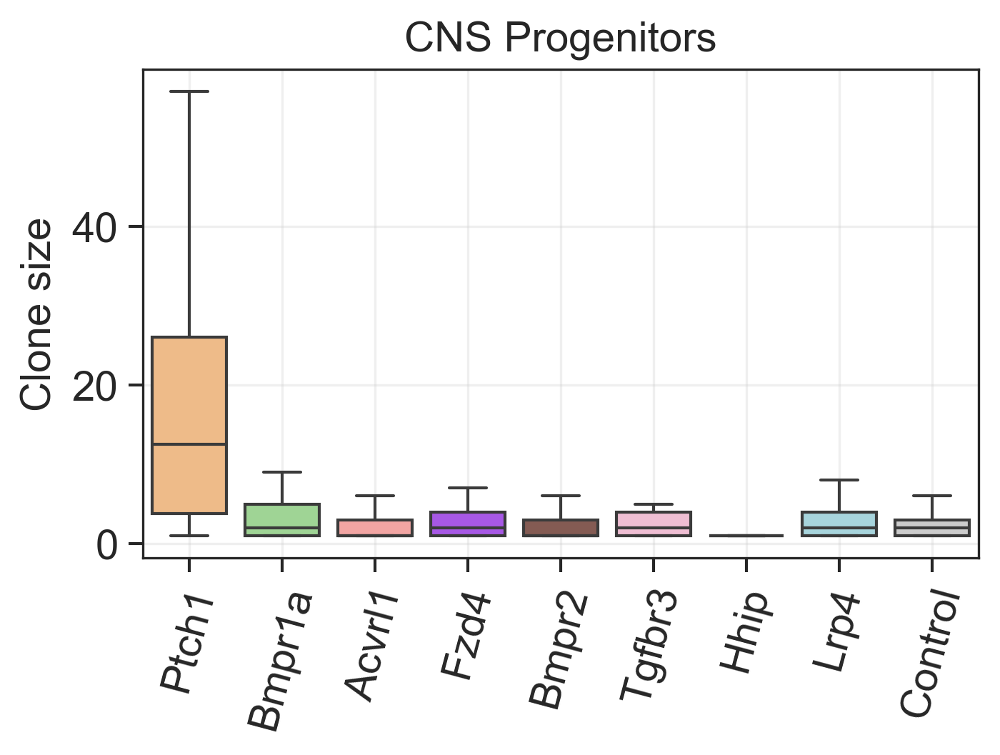

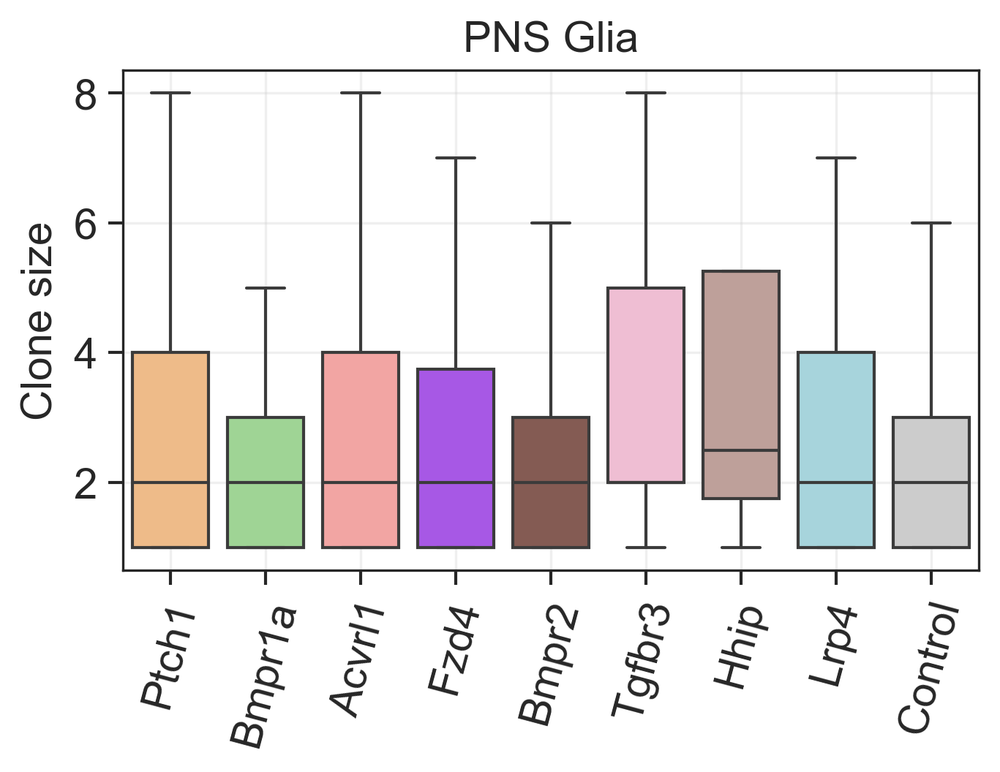

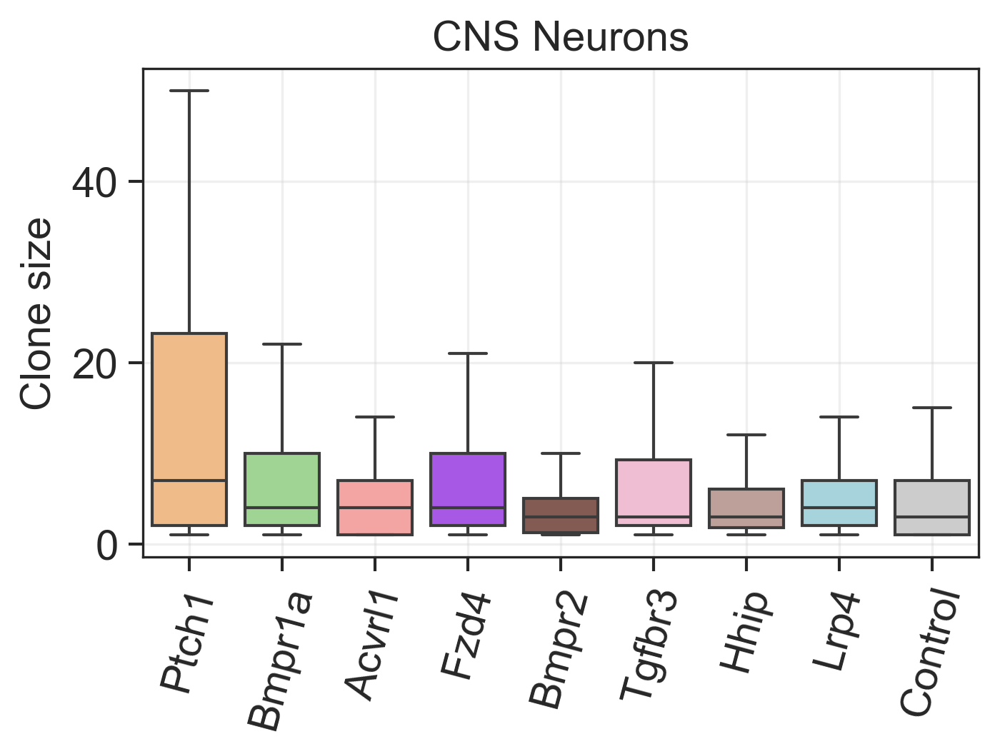

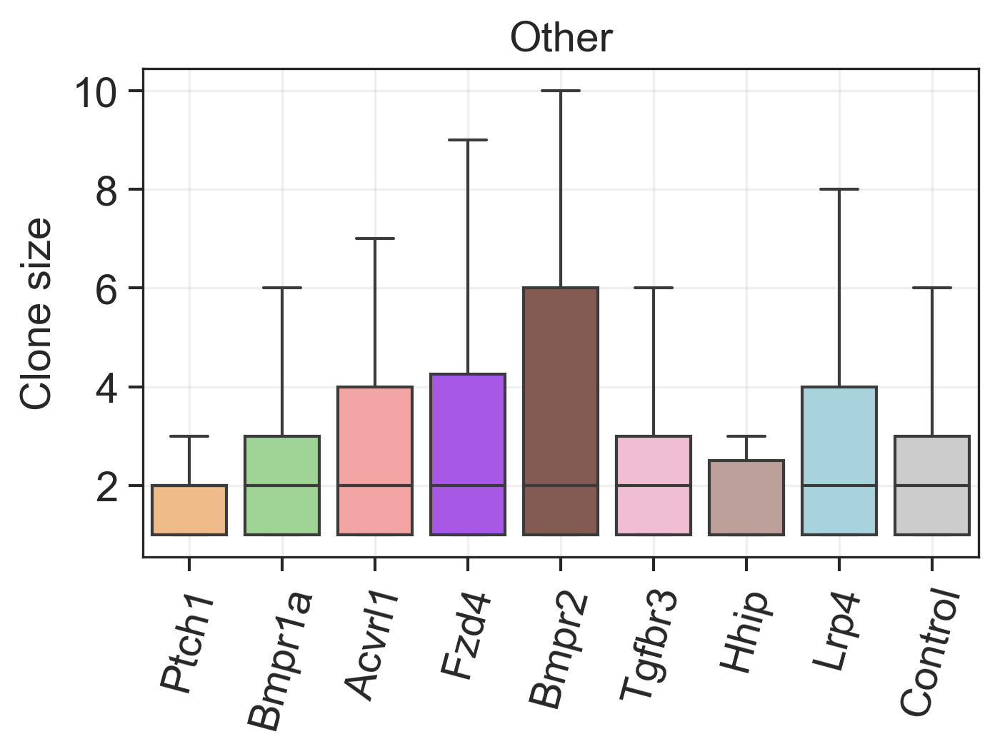

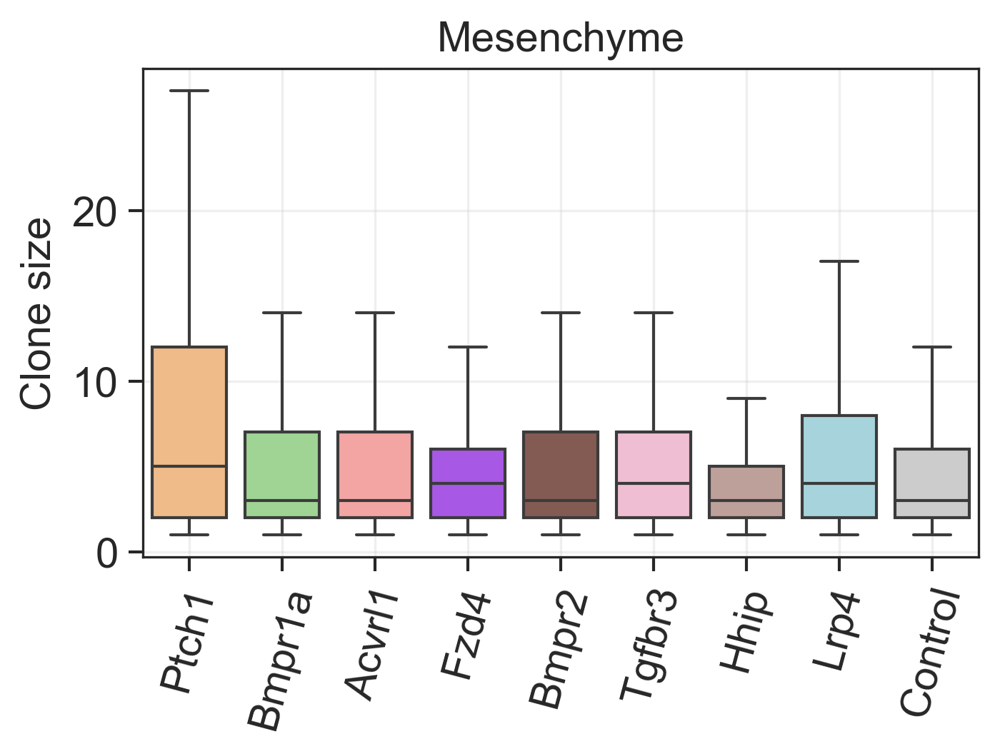

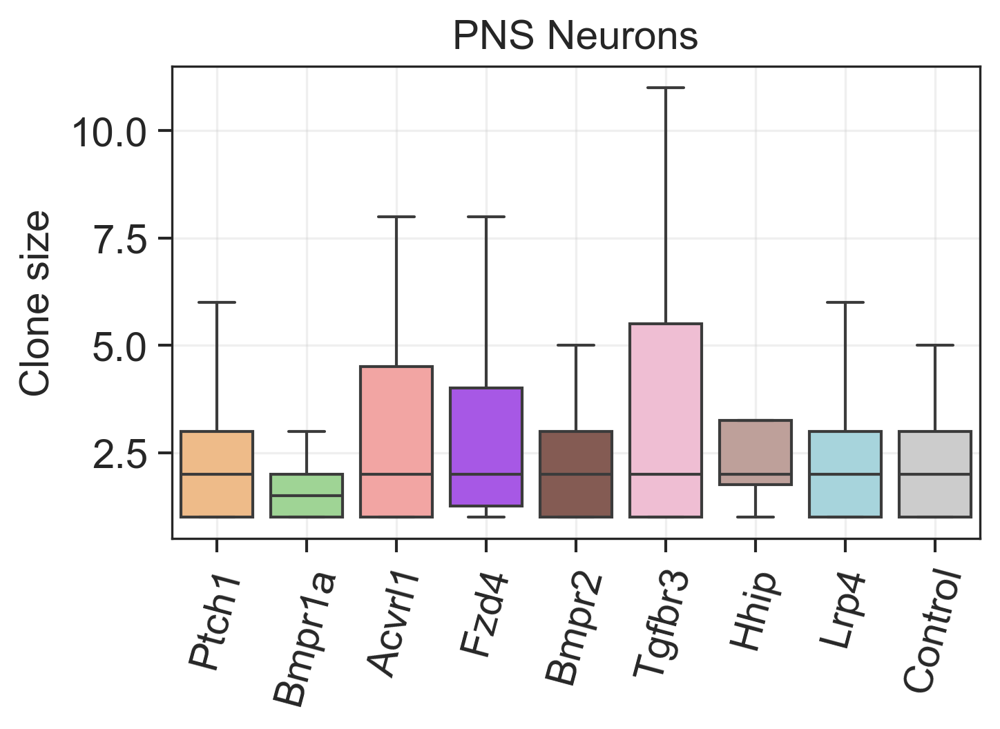

In [115]:
order = [i for i in set(clone_sizes.gRNA) if i != "Control"] + ["Control"]
for ct in cts:
    fig, ax = plt.subplots(figsize=(5, 3))
    
    sns.boxplot(
        x="gRNA",
        y="clone_size",
        data=clone_sizes[clone_sizes.cell_type == ct],
        ax=ax,
        showfliers=False,
        palette=gRNAs_colors,
        order=order,
    )

    ax.set_xticklabels(ax.get_xticklabels(), rotation=75, ha="center")
    ax.set_ylabel("Clone size")
    ax.set_xlabel("")
    ax.grid(alpha=0.3)
    ax.set_title(ct)

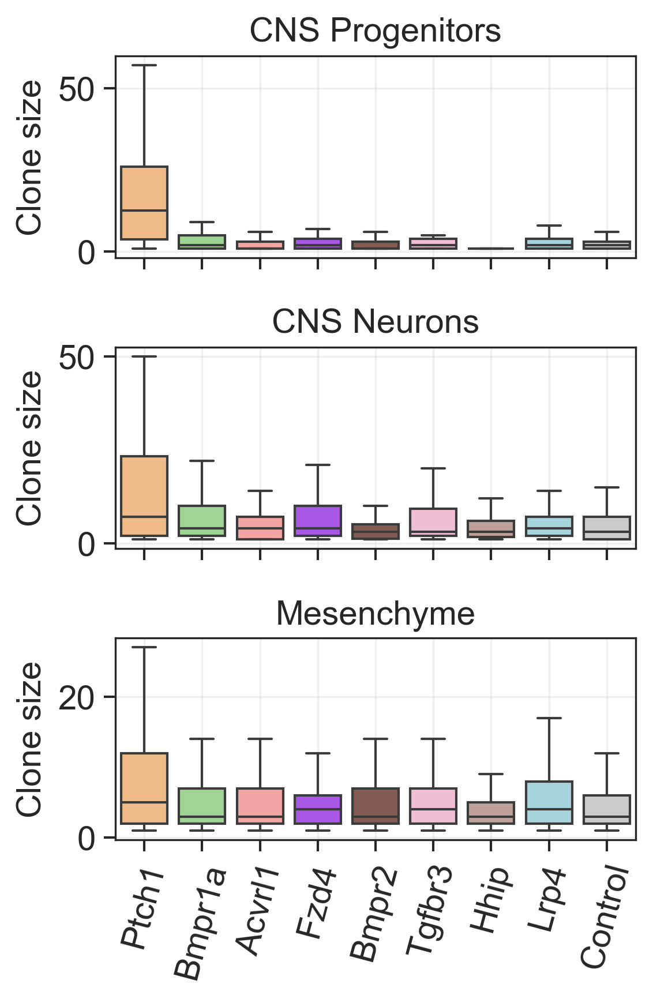

In [116]:
import matplotlib.ticker as ticker

fig, axes = plt.subplots(figsize=(4, 6), nrows=3)

for i, ct in enumerate(["CNS Progenitors", "CNS Neurons", "Mesenchyme"]):
    ax = axes[i]
    
    sns.boxplot(
        x="gRNA",
        y="clone_size",
        data=clone_sizes[clone_sizes.cell_type == ct],
        ax=ax,
        showfliers=False,
        palette=gRNAs_colors,
        order=order,
    )

    if i != 2:
        ax.set_xticklabels([])
    else:
        ax.set_xticklabels(ax.get_xticklabels(), rotation=75, ha="center")
        
    ax.set_ylabel("Clone size")
    ax.set_xlabel("")
    ax.grid(alpha=0.3)
    ax.set_title(ct)
    
plt.tight_layout()
plt.savefig("../figures/fig6/boxplots_trunk.pdf", bbox_inches="tight")

In [200]:
E8_gRNAs = list(set(clone_sizes.gRNA))

In [154]:
adata_trunk_neur = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/perturbations/merged/trunk_E13_neurons.h5ad")
adata_trunk_mes = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/perturbations/merged/trunk_E13_mesenchyme.h5ad")

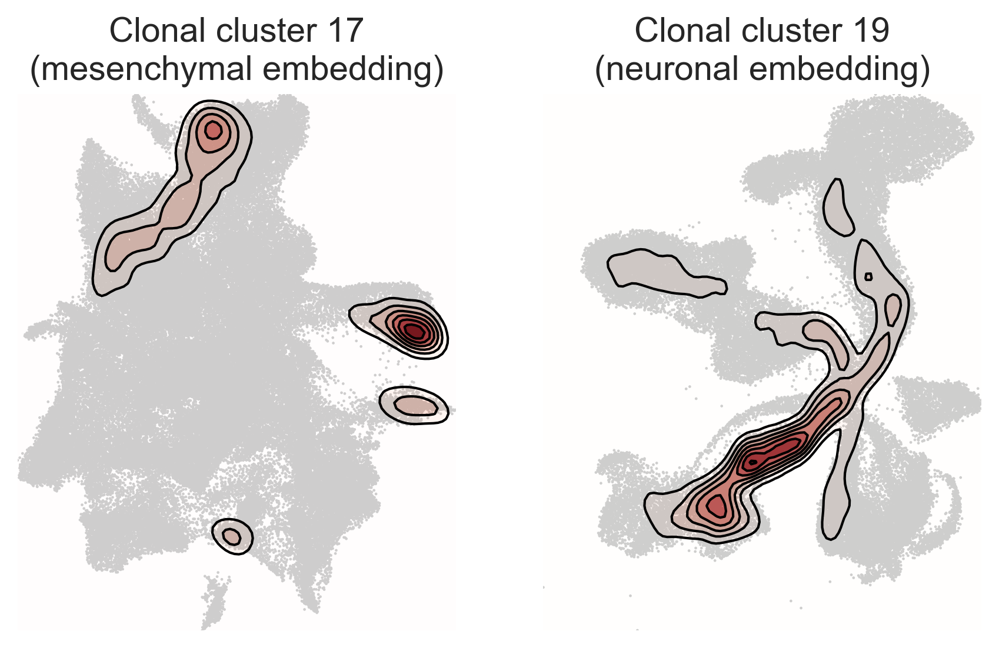

In [192]:
target_cts = [
    "Dorsal excitatory", "Dorsal excitatory lateral", "Dorsal inhibitory",
    "CNS progenitor", "Dorsal inhibitory lateral", "Ventral motor progenitor",
    "Ventral neurons", "Dorsal progenitor medial", "Ventral progenitors"
]

fig, axes = plt.subplots(figsize=(7, 4), ncols=2)

sl.pl.kde(
    adata_trunk_neur[adata_trunk_neur.obs.celltype_l2.isin(target_cts)],
    groupby="clones_clusters_2",
    group="19",
    ax=axes[1],
    title="Clonal cluster 19\n(neuronal embedding)"
)

sl.pl.kde(
    adata_trunk_mes,
    groupby="clones_clusters_2",
    group="17",
    ax=axes[0],
    title="Clonal cluster 17\n(mesenchymal embedding)",
)

plt.savefig("../figures/fig6/kde_trunk.pdf", bbox_inches="tight")

In [237]:
perturbations = trunk_proportions.columns[:-2]
perturbations = perturbations[perturbations != "NA"]

adata_subset = adata_trunk_neur[adata_trunk_neur.obs.celltype_l2 == "CNS progenitor"]
adata_subset.obs["CRISPR:predicted"] = [
    i if b != "injection19" else "Etoh"
    for i, b in zip(adata_subset.obs["CRISPR:predicted"], adata_subset.obs["batch"])
]
adata_subset = adata_subset[adata_subset.obs["CRISPR:predicted"].isin(perturbations)]
adata_subset.layers["scaled"] = sc.pp.scale(adata_subset, max_value=10, copy=True).X

sc.tl.rank_genes_groups(
    adata_subset,
    groupby="CRISPR:predicted",
    reference="EGFP-1",
    groups=["Ptch1"]
)

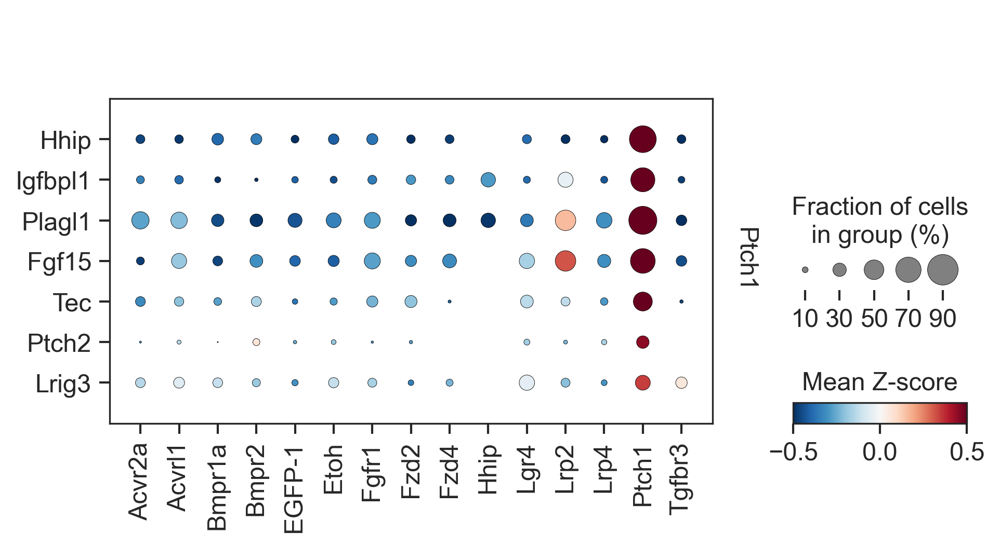

In [242]:
sc.pl.rank_genes_groups_dotplot(
    adata_subset,
    n_genes=7,
    dendrogram=False,
    min_logfoldchange=2,
    layer="scaled",
    vmin=-0.5,
    vmax=0.5,
    cmap="RdBu_r",
    swap_axes=True,
    colorbar_title="Mean Z-score",
    save="CNS_prog.pdf"
)

In [286]:
Shh_signature = pd.read_csv(
    "https://www.gsea-msigdb.org/gsea/msigdb/mouse/download_geneset.jsp?geneSetName=REACTOME_SIGNALING_BY_HEDGEHOG&fileType=TSV",
    sep="\t",
)
Shh_signature = [i for i in Shh_signature[Shh_signature.columns[1]][16].split(",") if i != ""]

sc.tl.score_genes(adata_subset, gene_list=Shh_signature, score_name="Shh_score")

Text(0.5, 0, '')

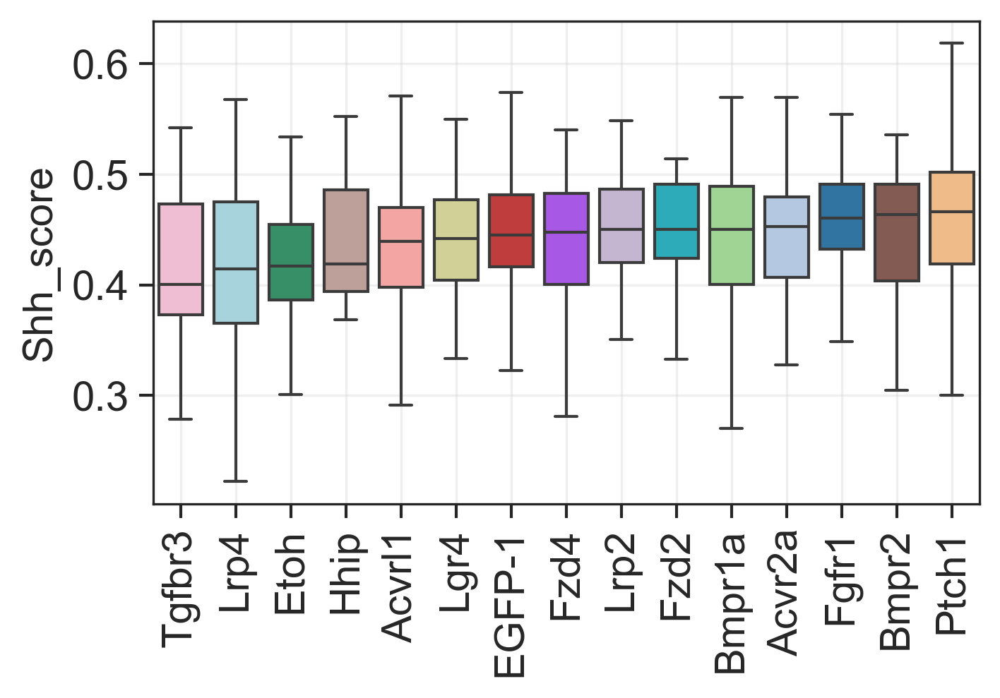

In [287]:
fig, ax = plt.subplots(figsize=(5, 3))

order = adata_subset.obs.groupby("CRISPR:predicted").median()["Shh_score"].sort_values().index
sns.boxplot(
    x="CRISPR:predicted",
    y="Shh_score",
    data=adata_subset.obs,
    showfliers=False,
    ax=ax,
    palette=gRNAs_colors,
    order=order,
)
ax.grid(alpha=0.3)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90, ha="center")
ax.set_xlabel("")

In [3]:
adata_face_neur = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/perturbations/merged/face_E13_neurons.h5ad")
adata_face_mes = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/perturbations/merged/face_E13_mesenchyme.h5ad")

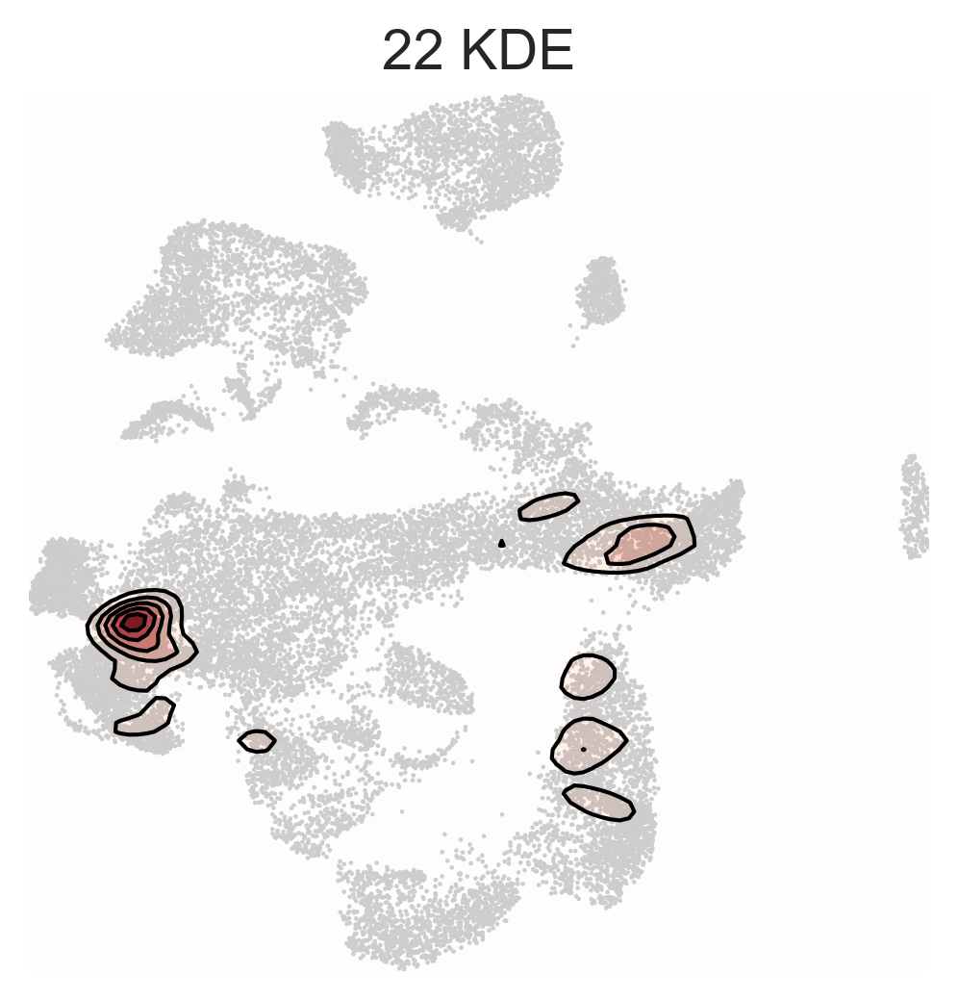

In [293]:
sl.pl.kde(
    adata_face_neur,
    groupby="clones_clusters_2",
    group="22",
)

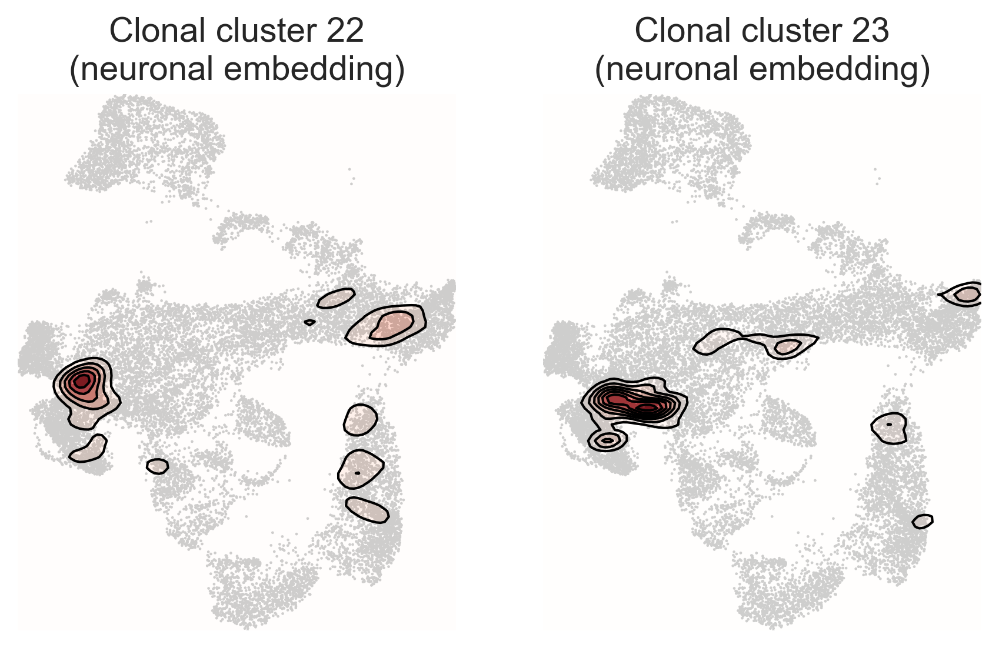

In [32]:
target_cts = [
    "CNS Glu", "CNS Neuron", "CNS progenitors",
    "Chchd10", "Erbb4 Hoxb8", "Neurod6",
    "Rax", "Retinal ganglion", "Pou3f1",
    "Neuroepithelial", "Otp Cartpt"
]


fig, axes = plt.subplots(figsize=(7, 4), ncols=2)

sl.pl.kde(
    adata_face_neur[adata_face_neur.obs.celltype_l2.isin(target_cts)],
    groupby="clones_clusters_2",
    group="22",
    ax=axes[0],
    title="Clonal cluster 22\n(neuronal embedding)"
)

sl.pl.kde(
    adata_face_neur[adata_face_neur.obs.celltype_l2.isin(target_cts)],
    groupby="clones_clusters_2",
    group="23",
    ax=axes[1],
    title="Clonal cluster 23\n(neuronal embedding)",
)

plt.savefig("../figures/fig6/kde_face.pdf", bbox_inches="tight")

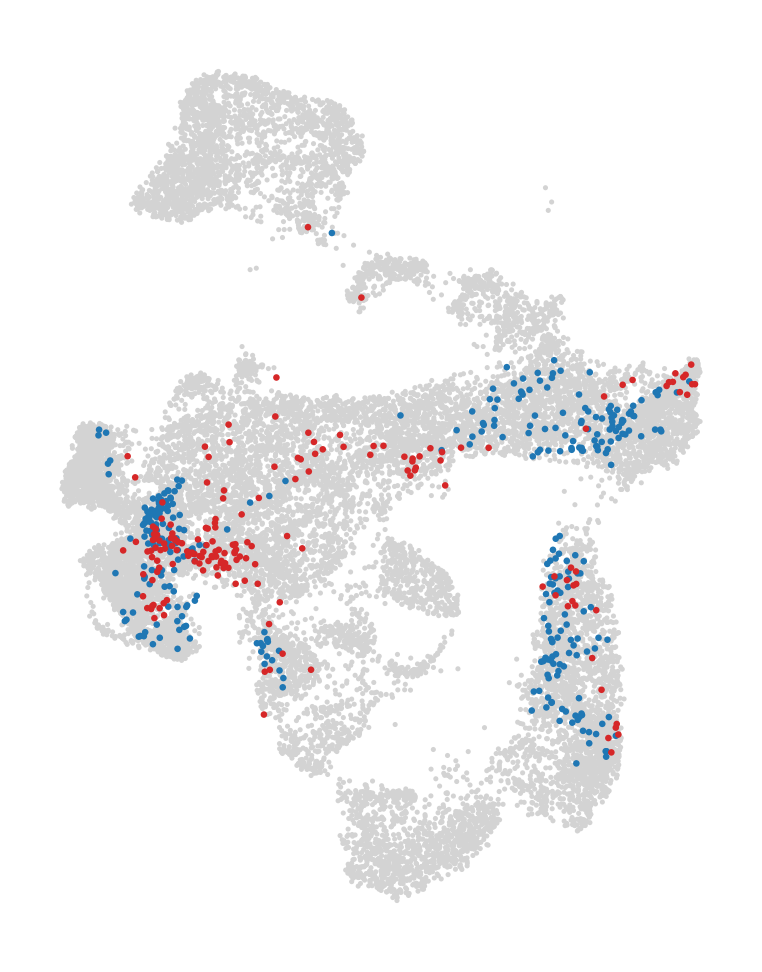

In [35]:
adata_subset_face = adata_face_neur[adata_face_neur.obs.celltype_l2.isin(target_cts)]

fig, ax = plt.subplots(figsize=(3, 4))

sc.pl.umap(adata_subset_face, frameon=False, ax=ax, show=False)
sc.pl.umap(adata_subset_face[adata_subset_face.obs.clones_clusters_2 == "22"], frameon=False, ax=ax,
           show=False, s=10, na_color=sns.color_palette()[0])
sc.pl.umap(adata_subset_face[adata_subset_face.obs.clones_clusters_2 == "23"], frameon=False, ax=ax,
           show=False, s=10, na_color=sns.color_palette()[3], title="")

plt.savefig("../figures/fig6/umap_selected_face.pdf", bbox_inches="tight")

In [29]:
from scipy.cluster.hierarchy import linkage, dendrogram

pert_face_subset = pert_face[pert_face.obs.leiden_2.isin(["7", "11", "19", "10", "23", "22"])]

clones_to_draw = sc.AnnData(
    X=pert_face_subset.X[:, pert_face_subset.X.sum(axis=0) > 0],
    obs=pert_face_subset.obs,
    var=pert_face_subset.var.loc[pert_face_subset.var_names[pert_face_subset.X.sum(axis=0) > 0]]
)

ct_order = dendrogram(linkage(clones_to_draw.X.T, method="average", metric="correlation"), no_plot=True)["leaves"][::-1]
sc.tl.dendrogram(
    clones_to_draw,
    groupby="leiden_2",
    cor_method="spearman",
    linkage_method="centroid",
    optimal_ordering=True,
    use_rep="X",
)
ax = sc.pl.matrixplot(
    clones_to_draw,
    var_names=clones_to_draw.var_names[ct_order],
    groupby="leiden_2",
    cmap="Reds",
    dendrogram=True,
    figsize=(10, 2),
    #standard_scale="var",
    show=False,
    log=True,
    vmax=0.5,
    colorbar_title="log(Cell counts)",
    save="face_perturb.pdf",
    title="CNS-related clonal clusters composition",
)

In [968]:
clones_trunk = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/E13_clonal_embedding.h5ad")
adata_trunk = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/trunk_E13_clonal_clusters.h5ad")

l0_to_l2 = {}
for l0, l2 in zip(adata_trunk.obs["celltype_l0"], adata_trunk.obs["celltype_l2"]):
    if l0 not in l0_to_l2:
        l0_to_l2[l0] = []
    if l2 not in l0_to_l2[l0]:
        l0_to_l2[l0].append(l2)
        
for l0 in l0_to_l2:
    clones_trunk.obs[f"{l0}_total"] = clones_trunk[:, l0_to_l2[l0]].layers["frequencies"].sum(axis=1)

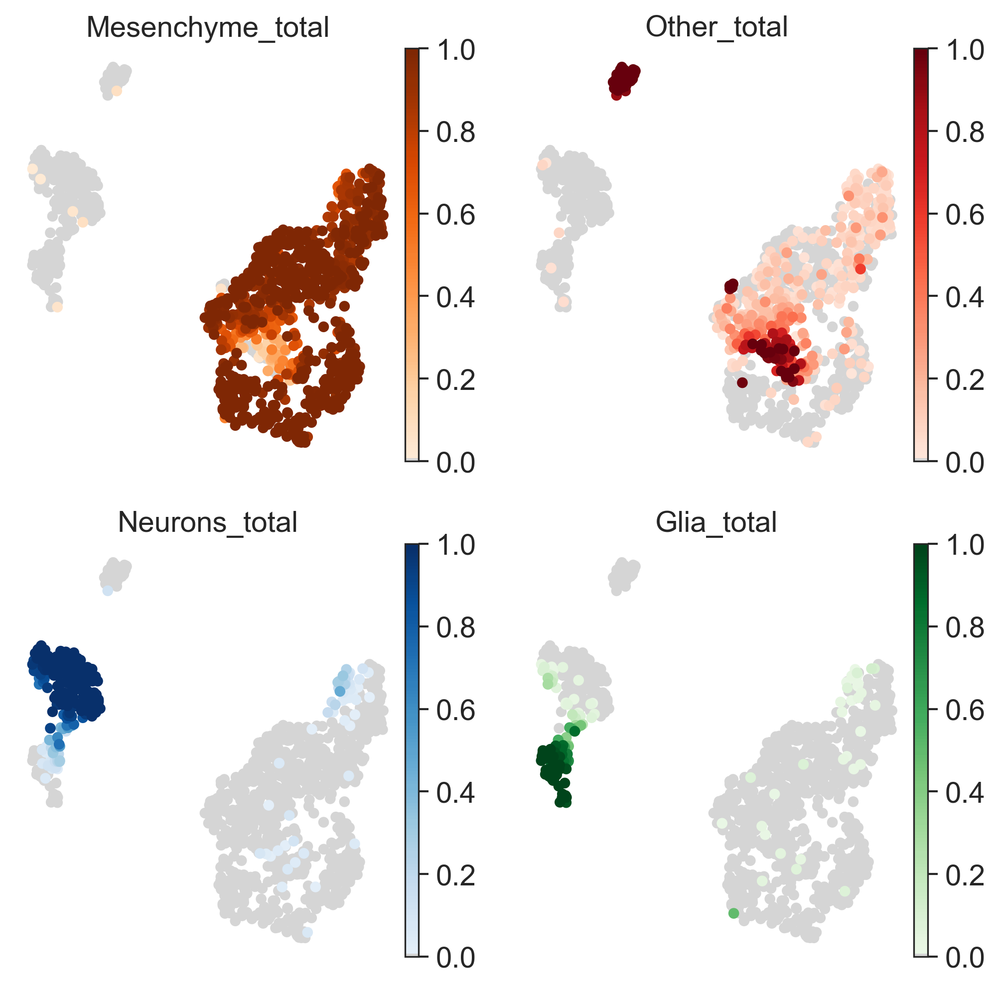

In [75]:
fig, axes = plt.subplots(ncols=2, nrows=2, figsize=(8, 8))

sc.pl.umap(clones_trunk, color="Mesenchyme_total", cmap=mb.pl.beautiful_cmap("Oranges", grey_intensity=0.27),
           frameon=False, show=False, ax=axes[0, 0])
sc.pl.umap(clones_trunk, color="Neurons_total", cmap=mb.pl.beautiful_cmap("Blues", grey_intensity=0.27),
           frameon=False, show=False, ax=axes[1, 0])
sc.pl.umap(clones_trunk, color="Other_total", cmap=mb.pl.beautiful_cmap("Reds", grey_intensity=0.27),
           frameon=False, show=False, ax=axes[0, 1])
sc.pl.umap(clones_trunk, color="Glia_total", cmap=mb.pl.beautiful_cmap("Greens", grey_intensity=0.27),
           frameon=False, show=False, ax=axes[1, 1])

plt.savefig("../figures/fig2/embeddings.pdf", bbox_inches="tight")

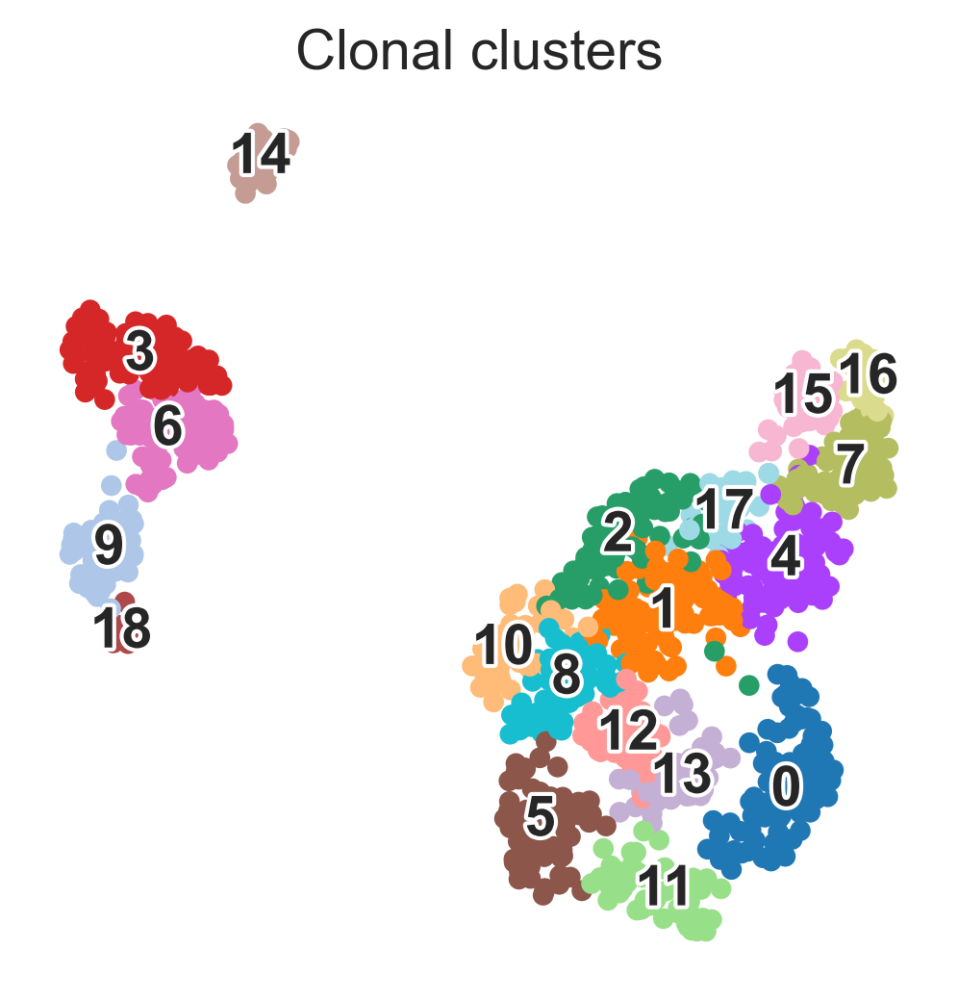

In [145]:
sc.pl.umap(clones_trunk, color="leiden_2", frameon=False, title="Clonal clusters",
           legend_loc="on data", legend_fontoutline=2, save="clonal_clusters.pdf")

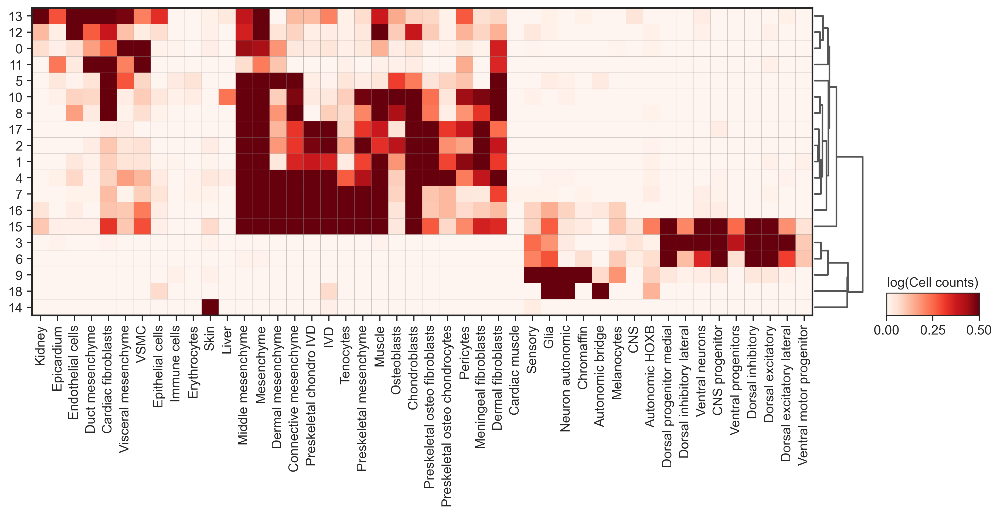

In [78]:
from scipy.cluster.hierarchy import linkage, dendrogram

ct_order = dendrogram(linkage(clones_trunk.X.T, method="average", metric="correlation"), no_plot=True)["leaves"][::-1]
sc.tl.dendrogram(
    clones_trunk,
    groupby="leiden_2",
    cor_method="spearman",
    linkage_method="centroid",
    optimal_ordering=True,
)
ax = sc.pl.matrixplot(
    clones_trunk,
    var_names=clones_trunk.var_names[ct_order],
    groupby="leiden_2",
    cmap="Reds",
    dendrogram=True,
    figsize=(15, 5),
    #standard_scale="var",
    show=False,
    log=True,
    vmax=0.5,
    colorbar_title="log(Cell counts)"
)

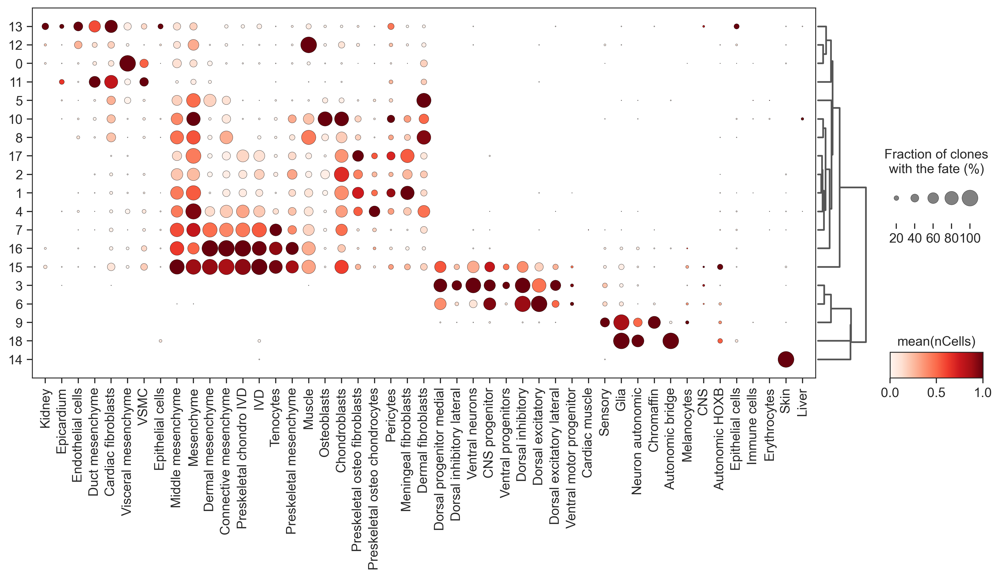

In [430]:
ct_order = [
    'Kidney', 'Epicardium', 'Endothelial cells', 'Duct mesenchyme',
    'Cardiac fibroblasts', 'Visceral mesenchyme', 'VSMC',
    'Epithelial cells', 'Middle mesenchyme', 'Mesenchyme', 'Dermal mesenchyme',
    'Connective mesenchyme', 'Preskeletal chondro IVD', 'IVD', 'Tenocytes',
    'Preskeletal mesenchyme', 'Muscle', 'Osteoblasts', 'Chondroblasts',
    'Preskeletal osteo fibroblasts', 'Preskeletal osteo chondrocytes',
    'Pericytes', 'Meningeal fibroblasts', 'Dermal fibroblasts',
    'Dorsal progenitor medial', 'Dorsal inhibitory lateral',
    'Ventral neurons', 'CNS progenitor', 'Ventral progenitors',
    'Dorsal inhibitory', 'Dorsal excitatory', 'Dorsal excitatory lateral',
    'Ventral motor progenitor', 
    'Cardiac muscle', 'Sensory', 'Glia', 'Neuron autonomic', 'Chromaffin',
    'Autonomic bridge', 'Melanocytes', 'CNS', 'Autonomic HOXB',
    'Epithelial cells', 'Immune cells', 'Erythrocytes', 'Skin', 'Liver'
]

ax = sc.pl.dotplot(
    clones_trunk,
    var_names=ct_order,
    groupby="leiden_2",
    cmap="Reds",
    dendrogram=True,
    figsize=(15, 6),
    standard_scale="var",
    show=True,
    colorbar_title="mean(nCells)",
    size_title="Fraction of clones\nwith the fate (%)",
    save="ct_compos_dotplot.pdf"
)

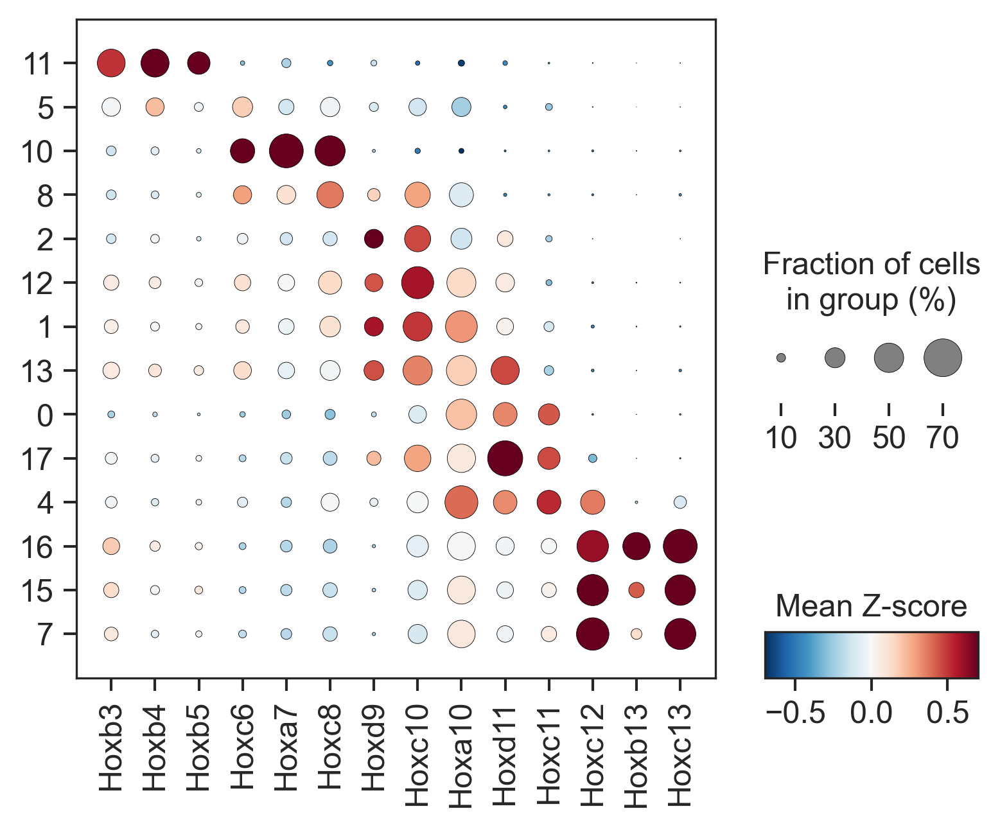

In [121]:
adata_mes = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/trunk_mes_E13_clonal_clusters.h5ad")

genes = np.array([
    "Hoxc13", "Hoxb13", "Hoxc12", "Hoxc11",
    "Hoxd11", "Hoxa10", "Hoxc10", "Hoxd9",
    "Hoxc8", "Hoxa7", "Hoxc6", "Hoxb5",
    "Hoxb4", "Hoxb3"
])

clones_whitelist = list(
    adata_mes.
    obs.
    clones_clusters_2.
    value_counts()[
        adata_mes.obs.clones_clusters_2.value_counts() > 50
    ][1:].
    index
)

adata_plot = adata_mes[
    adata_mes.obs.clones_clusters_2.isin(clones_whitelist),
    genes
]
sc.pp.scale(adata_plot, max_value=10)

adata_plot.obs["clones_clusters_2"] = adata_plot.obs["clones_clusters_2"].cat.reorder_categories(
    ["7", "15", "16", "4", "17", "0", "13", "1", "12", "2", "8", "10", "5", "11"][::-1]
)

sc.pl.dotplot(
    adata_plot,
    var_names=genes[::-1],
    groupby="clones_clusters_2",
    swap_axes=False,
    dendrogram=False,
    cmap="RdBu_r",
    vmax=0.7,
    vmin=-0.7,
    colorbar_title="Mean Z-score",
    dot_max=0.7,
    figsize=(6, 4.5),
    save="hox.pdf",
)

In [965]:
adata_mes = adata_mes.raw.to_adata()

In [966]:
genes = np.array([
    "Hoxc13", "Hoxc12", "Hoxc11",
    "Hoxd11", "Hoxc10", "Hoxd9",
    "Hoxc8", "Hoxa7", "Hoxc6", "Hoxb5",
    "Hoxb4"
])

anterio_posterior_signature = dict(enumerate(genes[::-1]))
anterio_posterior_signature = dict(zip(anterio_posterior_signature.values(), [i + 1 for i in anterio_posterior_signature.keys()]))

adata_mes.obs["Hox_position"] = (
    adata_mes[:, list(anterio_posterior_signature.keys())].X *
    np.array(list(anterio_posterior_signature.values())) / 
    adata_mes[:, list(anterio_posterior_signature.keys())].X.sum(axis=1).T.A
)[0]

adata_mes.obs["Hox_position"] = (
    adata_mes.obs["Hox_position"] - adata_mes.obs["Hox_position"].min()
) / (adata_mes.obs["Hox_position"].max() - adata_mes.obs["Hox_position"].min())

adata_mes.obs["Hox_position"] = [i if str(i) != "nan" else 0.5 for i in adata_mes.obs["Hox_position"]]

In [969]:
expressions = {}
G2M_prop = []
S_prop = []

for clone in clones_trunk.obs_names:
    stage = clone[:4]
    clone_name = clone[5:]
    
    expressions[clone] = adata_trunk[adata_trunk.obs[f"{stage}:clones"] == clone_name].X.mean(axis=0).A[0]
    cycling = adata_trunk[adata_trunk.obs[f"{stage}:clones"] == clone_name].obs["phase"].value_counts()
    total_cells = cycling.sum()
    cycling = dict(cycling)
    if "G2M" not in cycling:
        G2M_prop.append(0)
    else:
        G2M_prop.append(cycling["G2M"] / total_cells)
    if "S" not in cycling:
        S_prop.append(0)
    else:
        S_prop.append(cycling["S"] / total_cells)

expressions = pd.DataFrame(expressions, index=adata_trunk.var_names).T

In [970]:
from scipy.sparse import csr_matrix

clones_trunk_expr = sc.AnnData(
    X=csr_matrix(expressions.values),
    obs=clones_trunk.obs.copy(),
    var=pd.DataFrame(index=expressions.columns),
    obsm=clones_trunk.obsm,
    obsp=clones_trunk.obsp,
)
clones_trunk_expr.obs["S_prop"] = S_prop
clones_trunk_expr.obs["G2M_prop"] = G2M_prop

In [971]:
clones_trunk_expr.obs["Hox_position"] = (
    clones_trunk_expr[:, list(anterio_posterior_signature.keys())].X *
    np.array(list(anterio_posterior_signature.values())) / 
    clones_trunk_expr[:, list(anterio_posterior_signature.keys())].X.sum(axis=1).T.A
)[0]

clones_trunk_expr.obs["Hox_position"] = (
    clones_trunk_expr.obs["Hox_position"] - clones_trunk_expr.obs["Hox_position"].min()
) / (clones_trunk_expr.obs["Hox_position"].max() - clones_trunk_expr.obs["Hox_position"].min())

clones_trunk_expr.obs["Hox_position"] = [i if str(i) != "nan" else 0.5 for i in clones_trunk_expr.obs["Hox_position"]]

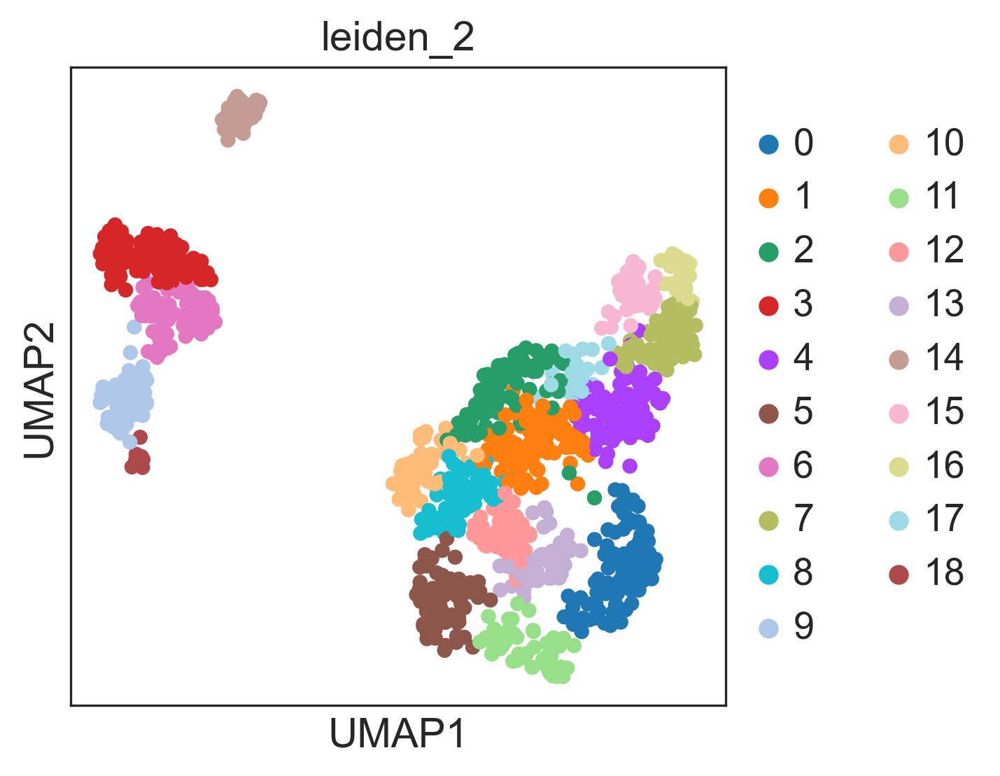

In [202]:
sc.pl.umap(clones_trunk_expr, color="leiden_2")

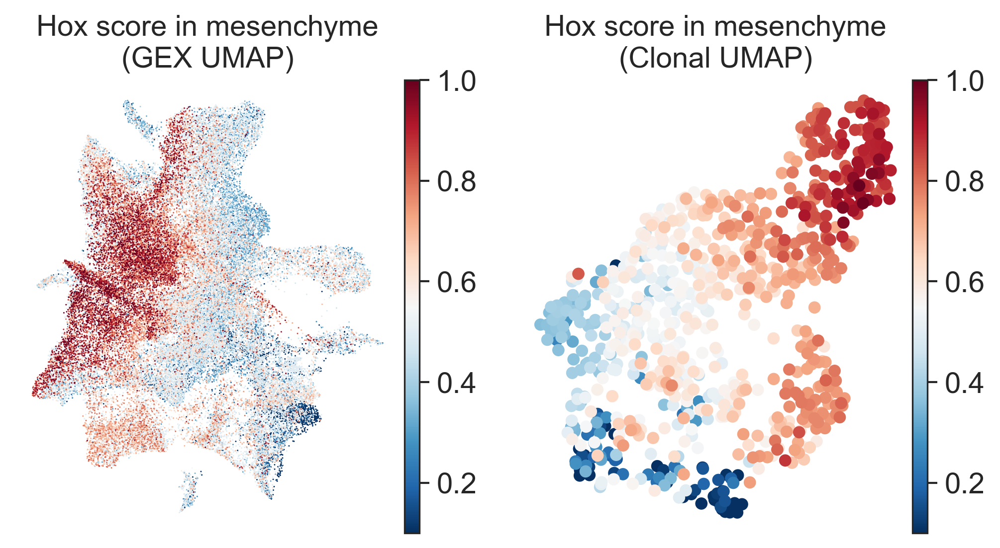

In [177]:
fig, axes = plt.subplots(ncols=2, figsize=(8, 4))

sc.pl.umap(adata_mes, color="Hox_position", cmap="RdBu_r", frameon=False, title="Hox score in mesenchyme\n(GEX UMAP)", s=2,
           vmin=0.1, ax=axes[0], show=False)

sc.pl.umap(clones_trunk_expr[~clones_trunk_expr.obs["leiden_0.5"].isin(["7", "6", "2"])],
           color="Hox_position", cmap="RdBu_r", frameon=False, title="Hox score in mesenchyme\n(Clonal UMAP)", vmin=0.1,
           ax=axes[1], show=False)

plt.savefig("../figures/fig2/Hox_score_UMAPs.pdf", bbox_inches="tight")

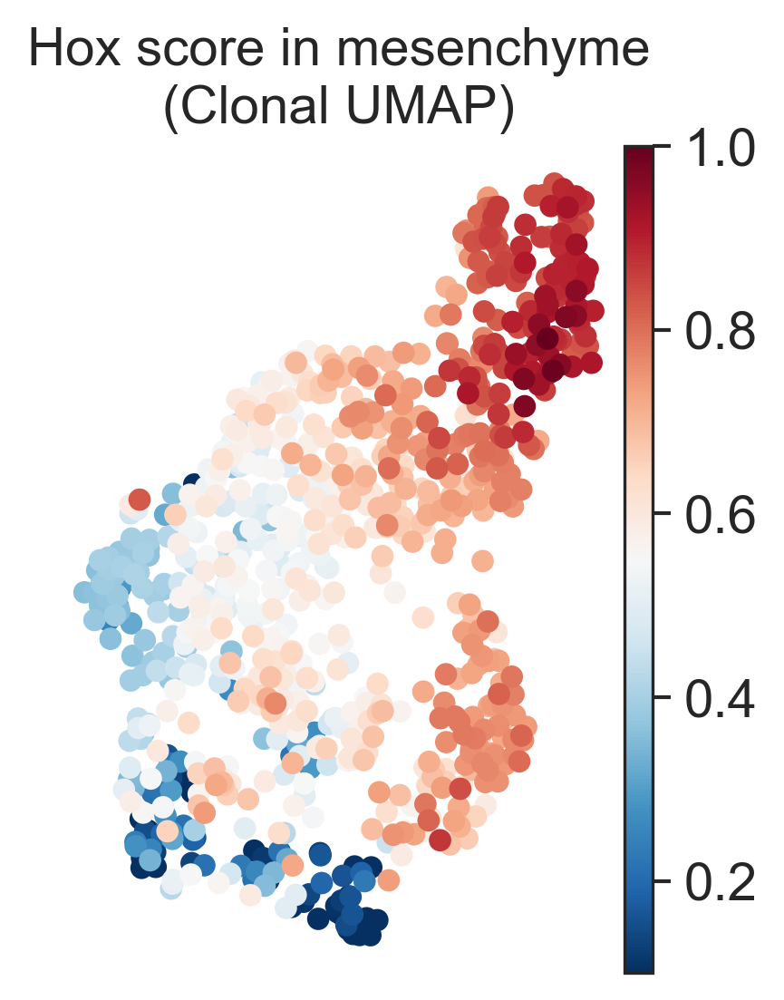

In [980]:
fig, ax = plt.subplots(figsize=(2.9, 4))

sc.pl.umap(clones_trunk_expr[~clones_trunk_expr.obs["leiden_0.5"].isin(["7", "6", "2"])],
           color="Hox_position", cmap="RdBu_r", frameon=False, title="Hox score in mesenchyme\n(Clonal UMAP)", vmin=0.1,
           ax=ax, show=False)

plt.savefig("../figures/fig2/Hox_score_UMAP_clonal.pdf", bbox_inches="tight")

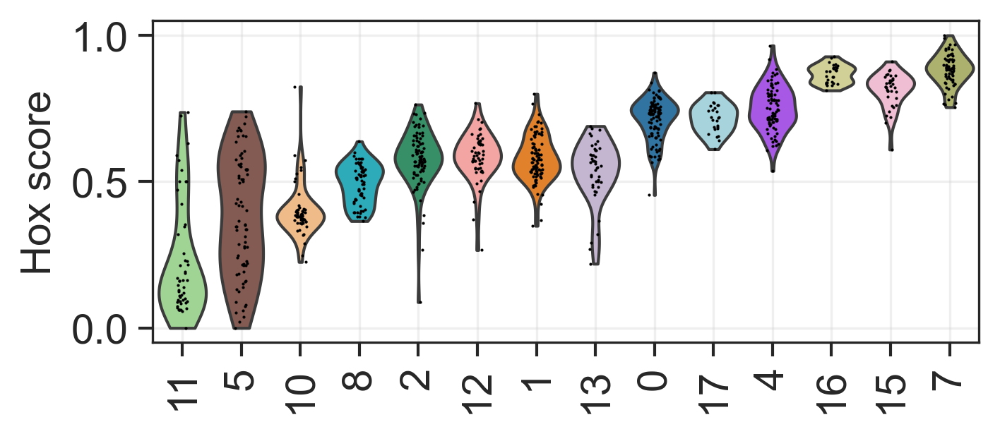

In [180]:
order = ["7", "15", "16", "4", "17", "0", "13", "1", "12", "2", "8", "10", "5", "11"][::-1]

fig, ax = plt.subplots(figsize=(5, 2))

sc.pl.violin(clones_trunk_expr, keys=["Hox_position"], groupby="leiden_2", order=order, ax=ax,
             show=False, xlabel="", ylabel="Hox score", rotation=90)
ax.grid(alpha=0.3)
ax.set_xlabel("")
ax.set_ylabel("Hox score")

plt.savefig("../figures/fig2/Hox_score_violin.pdf", bbox_inches="tight")

In [373]:
adata_subset = adata_mes[adata_mes.obs.batch == "injection6"]
adata_subset = adata_subset[adata_subset.obs.clones_clusters_2.isin(order)]

df = adata_subset.obs.groupby(["clones_clusters_2", "sample_id"]).size().unstack()
df.loc["16"] = [0, 0]
df = (df.T / df.sum(axis=1)).T.loc[order]

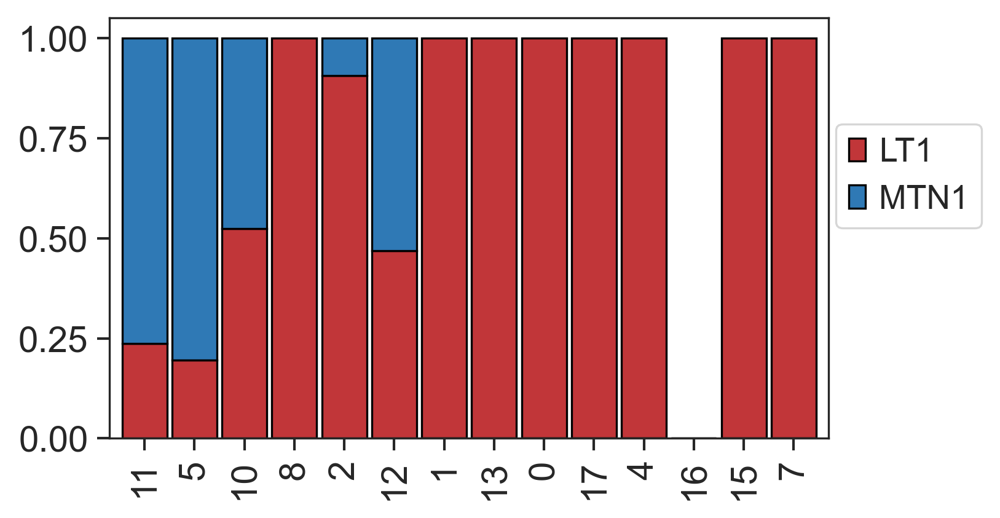

In [376]:
fig, ax = plt.subplots(figsize=(5, 3))

df.plot(kind="bar", stacked=True, width=0.9, edgecolor="black",
        ax=ax, color={"LT1": sns.color_palette("RdBu_r")[-1], "MTN1": sns.color_palette("RdBu_r")[0]})
ax.set_xlabel("")
ax.legend(loc=(1.01, 0.5))

plt.savefig("../figures/fig2/LT1_MTN1_distribution.pdf", bbox_inches="tight")

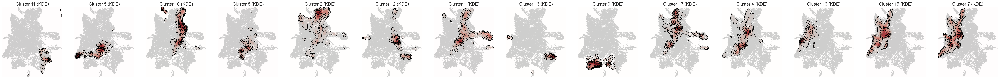

In [187]:
sl.pl.kde_panel(adata_mes, groups=order, obs_name="clones_clusters_2")
plt.savefig("../figures/fig2/supplement_kde.pdf", bbox_inches="tight")

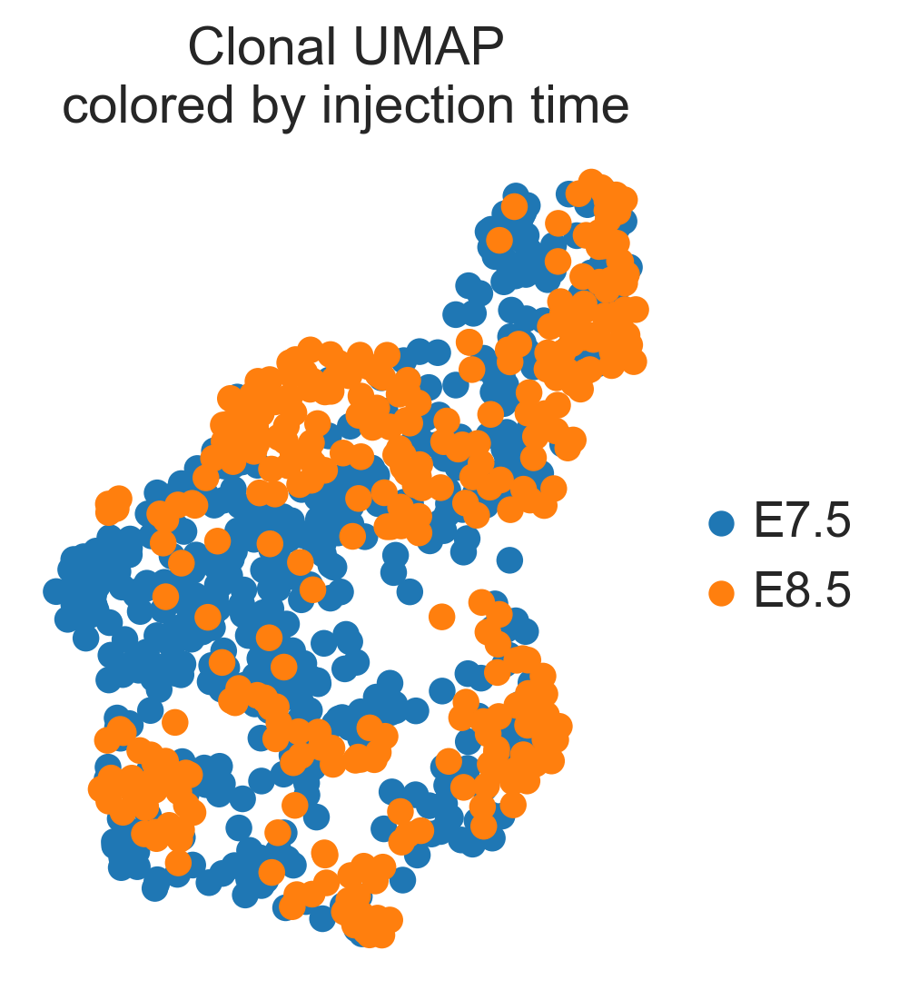

In [242]:
fig, ax = plt.subplots(figsize=(3, 4))

sc.pl.umap(clones_trunk[~clones_trunk.obs["leiden_0.5"].isin(["7", "6", "2"])], ax=ax, show=False,
           color="injection_time", frameon=False, title="Clonal UMAP\ncolored by injection time", s=200)

plt.savefig("../figures/fig2/time_umap.pdf", bbox_inches="tight")

In [208]:
df = clones_trunk[clones_trunk.obs.leiden_2.isin(["15", "7", "16"])].obs[[
    "injection_time", "leiden_2", "Mesenchyme_total", "Neurons_total"
]].groupby(["injection_time", "leiden_2"]).size().unstack()

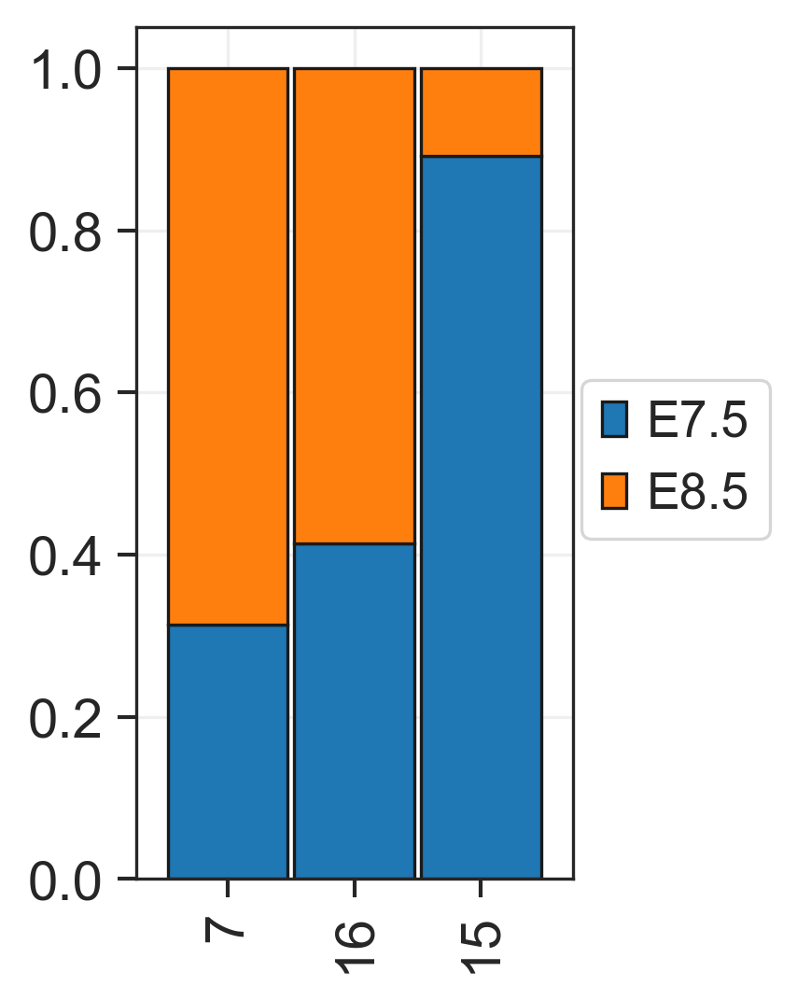

In [241]:
fig, ax = plt.subplots(figsize=(2, 4))
(df / df.sum(axis=0))[["7", "16", "15"]].T.plot(kind="bar", stacked=True, width=0.95, ax=ax, edgecolor="k")
ax.legend(loc=(1.02, 0.4))
ax.set_xlabel("")
ax.set_ylabel("")

ax.grid(alpha=0.3)

plt.savefig("../figures/fig2/time_barplot.pdf", bbox_inches="tight")

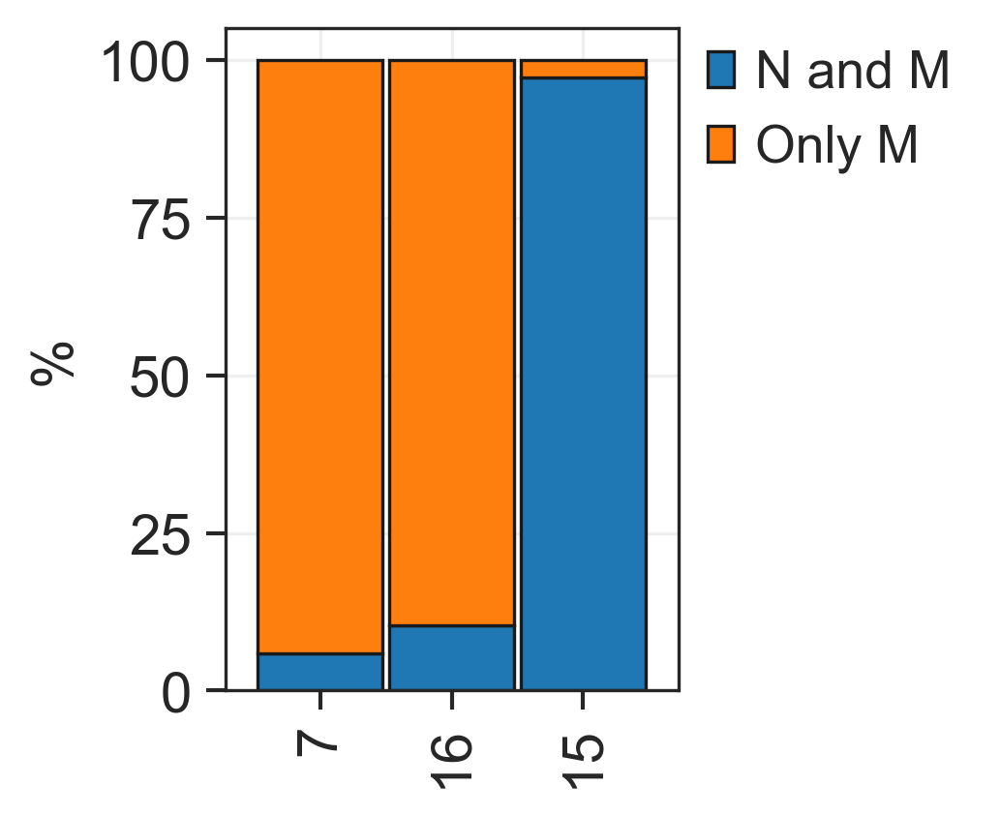

In [424]:
df_tmp = clones_trunk[clones_trunk.obs.leiden_2.isin(["7", "16", "15"])].obs[["Neurons_total", "Mesenchyme_total"]] > 0
df_tmp = pd.DataFrame({
    "type": (df_tmp.Neurons_total * 10 + df_tmp.Mesenchyme_total * 1),
    "cluster": clones_trunk[clones_trunk.obs.leiden_2.isin(["7", "16", "15"])].obs.leiden_2
})

df_tmp["type"] = ["N and M" if i == 11 else "Only M" for i in df_tmp.type]
df_tmp = df_tmp.groupby(["type", "cluster"]).size().unstack()
df_tmp = df_tmp[["7", "16", "15"]]

fig, ax = plt.subplots(figsize=(2, 3))
(df_tmp * 100 / df_tmp.sum(axis=0)).T.plot(kind="bar", stacked=True, ax=ax, width=0.95, edgecolor="k")
ax.legend(loc=(1.02, 0.75), edgecolor="white")
ax.set_xlabel("")
ax.set_ylabel("%")
ax.grid(alpha=0.3)

In [428]:
clones_trunk.obs["injection"] = [i.split(":")[1] for i in clones_trunk.obs_names]

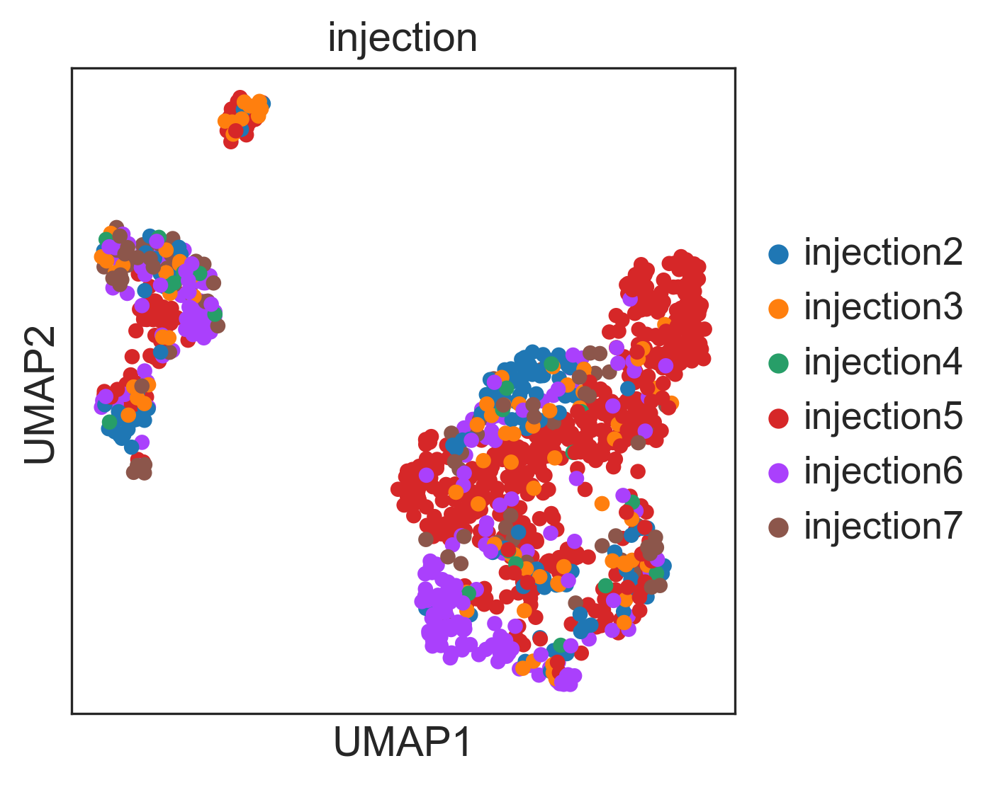

In [429]:
sc.pl.umap(clones_trunk, color="injection")

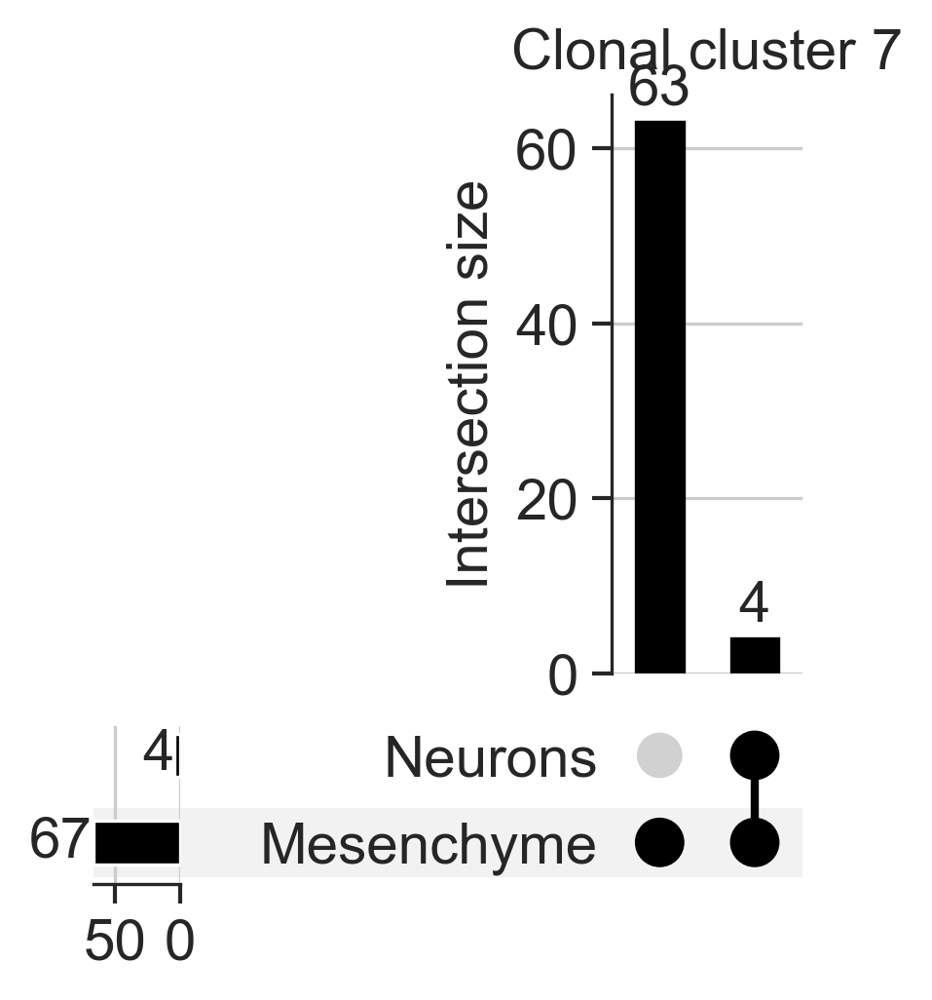

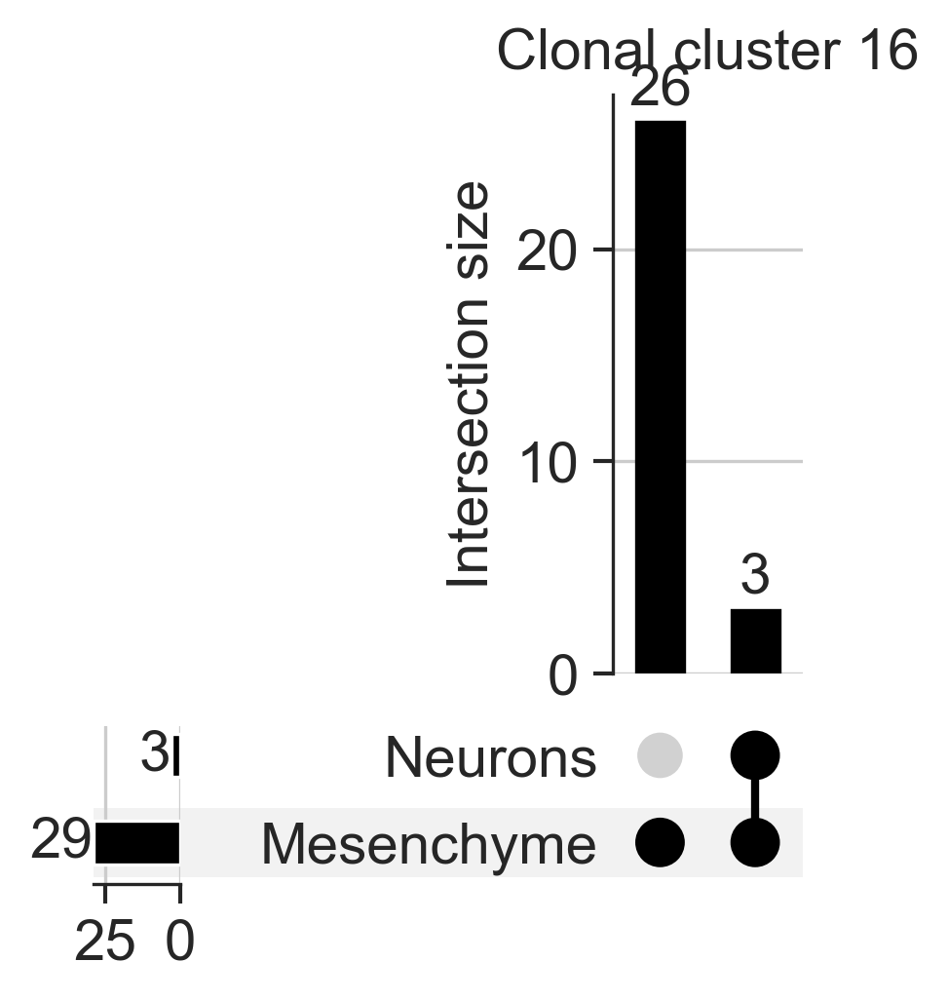

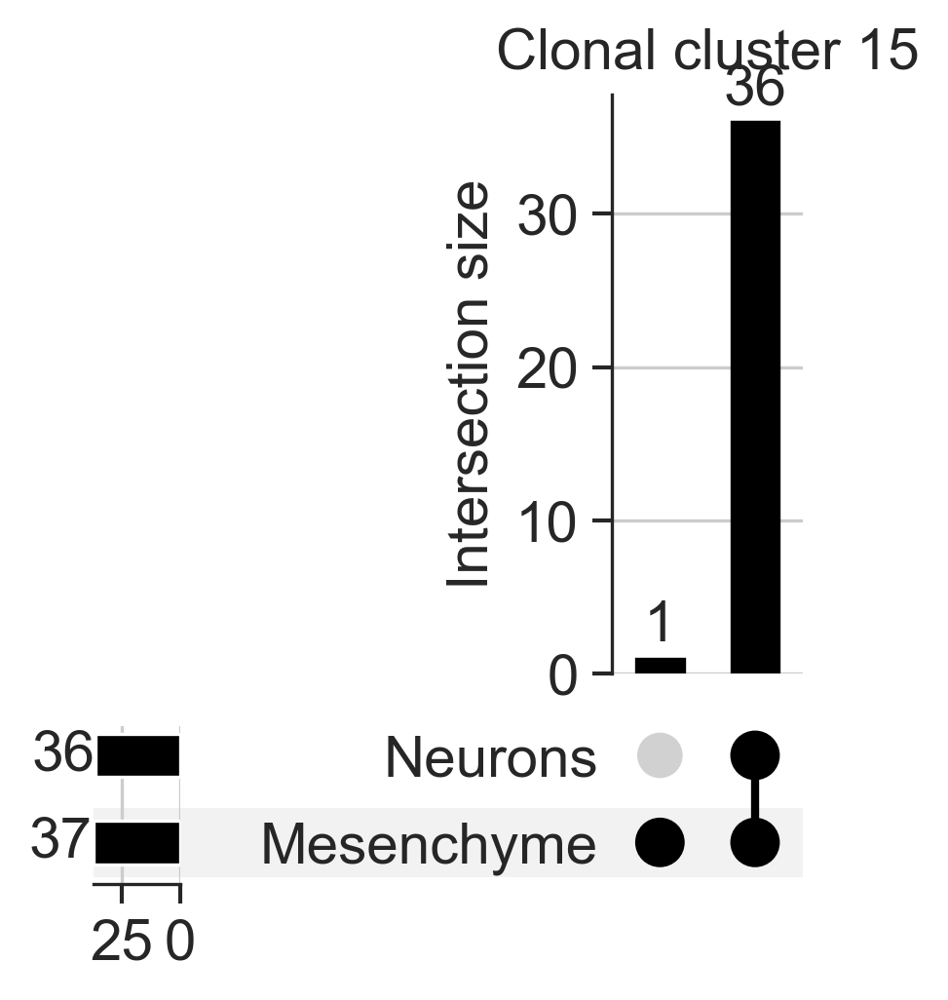

In [307]:
for clonal_cluster in ["7", "16", "15"]:
    df_tmp = clones_trunk[clones_trunk.obs.leiden_2 == clonal_cluster].obs[["Neurons_total", "Mesenchyme_total"]] > 0

    composition = []
    for n, m in zip(df_tmp.Neurons_total, df_tmp.Mesenchyme_total):
        _ = []
        if n:
            _.append("Neurons")
        if m:
            _.append("Mesenchyme")
        composition.append(_)

    composition = upsetplot.from_memberships(composition)
    
    if clonal_cluster == "15":
        sort_by = "degree"
    else:
        sort_by = "cardinality"
    axes = upsetplot.UpSet(composition, subset_size="count", sort_by=sort_by,
                           show_counts=True, min_subset_size=0,
                           totals_plot_elements=1).plot()
    axes["intersections"].set_title(f"Clonal cluster {clonal_cluster}")

    plt.savefig(f"../figures/fig2/UpSet_{clonal_cluster}.pdf", bbox_inches="tight")

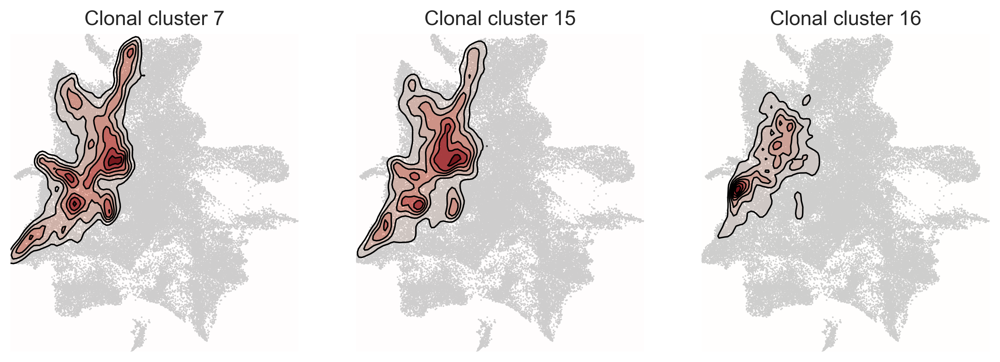

In [314]:
fig, axes = plt.subplots(ncols=3, figsize=(12, 4))

sl.pl.kde(adata_mes, group="7", groupby="clones_clusters_2", ax=axes[0], title="Clonal cluster 7")
sl.pl.kde(adata_mes, group="15", groupby="clones_clusters_2", ax=axes[1], title="Clonal cluster 15")
sl.pl.kde(adata_mes, group="16", groupby="clones_clusters_2", ax=axes[2], title="Clonal cluster 16")

plt.savefig(f"../figures/fig2/kde_tail.pdf", bbox_inches="tight")

In [58]:
adata_all = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/perturbations/merged/trunk_E13.h5ad")

In [545]:
adata_NC = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/trunk_NC_E13_clonal_clusters.h5ad")

adata_NC_pert = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/perturbations/merged/trunk_E13.h5ad")
adata_NC_pert = adata_NC_pert[adata_NC_pert.obs.celltype_l2.isin(adata_NC.obs.celltype_l2)]
adata_NC_pert = adata_NC_pert[~adata_NC_pert.obs_names.isin(adata_NC.obs_names)]

adata_adata_NC_pert_cycling = adata_NC_pert[adata_NC_pert.obs.phase != "G1"]
adata_adata_NC_pert_noncycling = adata_NC_pert[adata_NC_pert.obs.phase == "G1"]

sp.tl.map_embedding(adata_adata_NC_pert_noncycling, adata_NC, key="sample_id")
sp.tl.map_embedding(adata_adata_NC_pert_cycling, adata_NC, key="sample_id")

adata_NC_pert = adata_adata_NC_pert_cycling.concatenate(
    adata_adata_NC_pert_noncycling,
    index_unique=None,
    batch_key=None,
    uns_merge="first",
)

sp.tl.ingest(adata_NC_pert, adata_NC, use_rep="X_pca_harmony")

In [546]:
new_ct_mapping = {
    "Chromaffin": ["Chromaffin cells", "Chromaffin cells"],
    "Chromaffin bridge": ["Chromaffin cells", "Chromaffin cells"],
    "Melanocytes": ["Melanocytes", "Melanocytes"],
    "Glia Cxcl12": ["Nonmyelinating glia", "Glia"],
    "Glia NMJ": ["MNJ glia", "Glia"],
    "Glia Phox2b": ["Autonomic glia", "Autonomic glia"],
    "Glia Schwann": ["Myelinating glia", "Glia"],
    "Glia SCP": ["SCP", "Glia"],
    "Glia sensory BCC": ["BCC", "Sensory glia"],
    "Glia sensory satellite": ["Sensory glia", "Sensory glia"],
    "Glia sensory satellite 2": ["Sensory glia", "Sensory glia"],
    "Neuron autonomic": ["Enteric neurons", "Enteric neurons"],
    "Neuron autonomic parasympathetic": ["Parasympathetic neurons", "Autonomic neurons"],
    "Neuron autonomic sympathetic": ["Sympathetic neurons", "Autonomic neurons"],
    "Autonomic bridge": ["Enteric neurons", "Enteric neurons"],
    "Sensory 1": ["Sensory neurons", "Sensory neurons"],
    "Sensory 2": ["Sensory neurons", "Sensory neurons"],
    "Sensory 3": ["Sensory neurons", "Sensory neurons"],
    "Autonomic HOXB": ["Doublets", "Doublets"],
}

adata_NC.obs["celltype_NC_l1"] = [new_ct_mapping[i][1] for i in adata_NC.obs.celltype_l3]
adata_NC.obs["celltype_NC_l2"] = [new_ct_mapping[i][0] for i in adata_NC.obs.celltype_l3]

sc.tl.leiden(adata_NC)
adata_NC.obs["celltype_NC_l1"] = [j if i != "10" else "Doublets" for i, j in zip(adata_NC.obs.leiden, adata_NC.obs.celltype_NC_l1)]
adata_NC.obs["celltype_NC_l2"] = [j if i != "10" else "Doublets" for i, j in zip(adata_NC.obs.leiden, adata_NC.obs.celltype_NC_l2)]

sp.tl.transfer_labels_kNN(adata_NC_pert, adata_NC, "celltype_NC_l1")
sp.tl.transfer_labels_kNN(adata_NC_pert, adata_NC, "celltype_NC_l2")

adata_NC_pert = adata_NC_pert[adata_NC_pert.obs.celltype_NC_l2 != "Doublets"]
adata_NC = adata_NC[adata_NC.obs.celltype_NC_l2 != "Doublets"]
adata_NC_pert = adata_NC_pert[adata_NC_pert.obs.celltype_NC_l1 != "Doublets"]
adata_NC = adata_NC[adata_NC.obs.celltype_NC_l1 != "Doublets"]

In [8]:
l1_colors = dict(zip(
    adata_NC.obs.celltype_NC_l1.cat.categories,
    sns.color_palette("tab20")[:len(adata_NC.obs.celltype_NC_l1.cat.categories)]
))

l2_colors = dict(zip(
    adata_NC.obs.celltype_NC_l2.cat.categories,
    sns.color_palette("tab20")[:len(adata_NC.obs.celltype_NC_l2.cat.categories)]
))

adata_NC.uns["celltype_NC_l1_colors"] = [l1_colors[i] for i in adata_NC.obs.celltype_NC_l1.cat.categories]
adata_NC.uns["celltype_NC_l2_colors"] = [l2_colors[i] for i in adata_NC.obs.celltype_NC_l2.cat.categories]
adata_NC_pert.uns["celltype_NC_l1_colors"] = [l1_colors[i] for i in adata_NC_pert.obs.celltype_NC_l1.cat.categories]
adata_NC_pert.uns["celltype_NC_l2_colors"] = [l2_colors[i] for i in adata_NC_pert.obs.celltype_NC_l2.cat.categories]

In [10]:
adata_NC.write_h5ad("/home/sergey/data/clonal_project/anndatas/NC/NC.h5ad")
adata_NC_pert.write_h5ad("/home/sergey/data/clonal_project/anndatas/NC/NC_pert.h5ad")

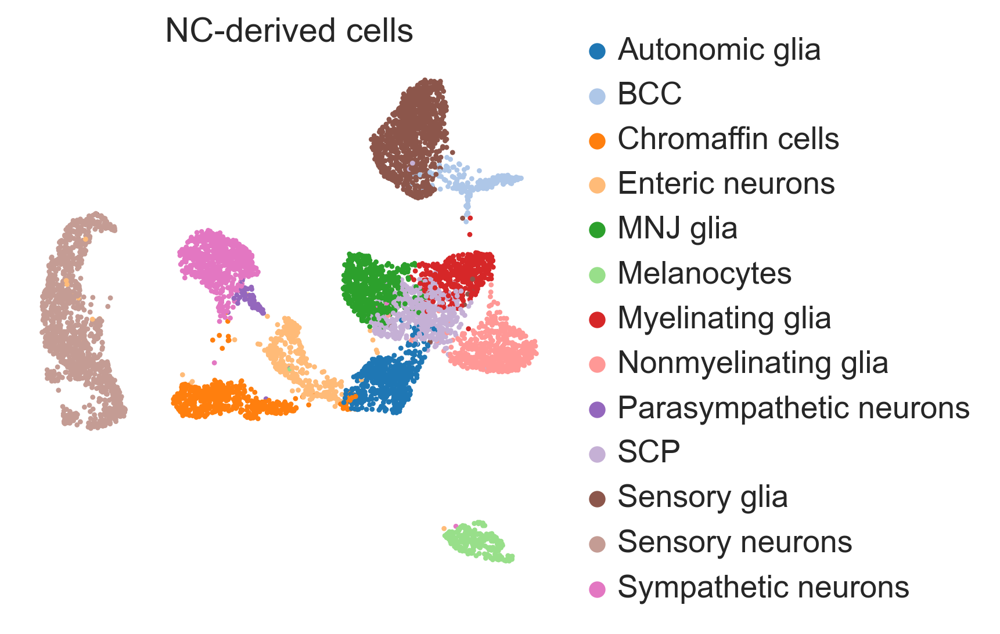

In [13]:
sc.pl.umap(adata_NC, color="celltype_NC_l2", frameon=False, title="NC-derived cells")#, save="NC_GEX.pdf")

In [14]:
clones = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/E13_clonal_embedding.h5ad")
clones_expr = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/E13_clonal_embedding_expr.h5ad")

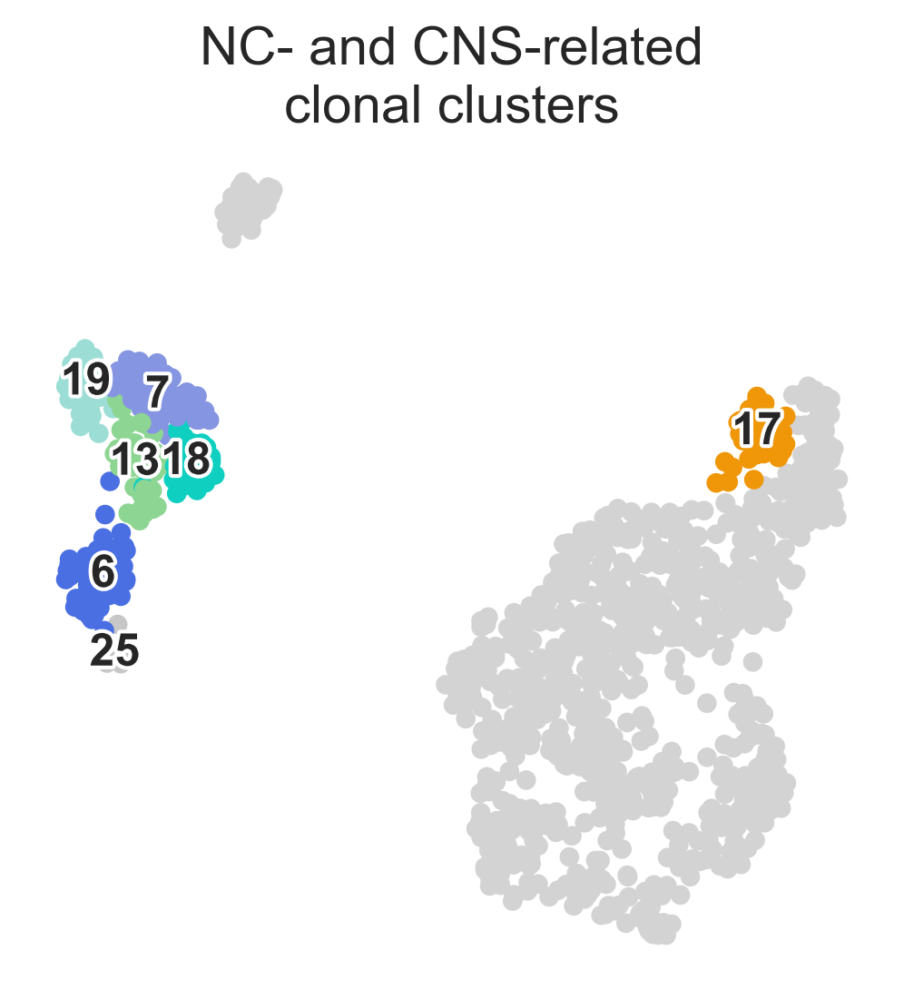

In [44]:
sc.pl.umap(
    clones,
    color="leiden_3",
    groups=["25", "6", "18", "13", "7", "19", "17"],
    legend_loc="on data",
    na_in_legend=False,
    title="NC- and CNS-related\nclonal clusters",
    frameon=False,
    legend_fontoutline=2,
    legend_fontsize=12,
    save="NC_CNS_clonal.pdf"
)

In [210]:
from tqdm import tqdm

l1_NC_clones = {}
l2_NC_clones = {}

for clone in tqdm(clones.obs_names):
    timepoint = clone.split(":")[0]
    clone = ":".join(clone.split(":")[1:])
    
    old_celltypes = adata_all[adata_all.obs[f"{timepoint}:clones"] == clone].obs[["celltype_l0", "celltype_l3"]]
    
    non_NC = old_celltypes[~old_celltypes.index.isin(adata_NC.obs_names)]
    non_NC = list(non_NC.celltype_l0.replace("Neurons", "CNS"))
    non_NC = [i for i in non_NC if i != "Glia"]
    
    NC = old_celltypes[old_celltypes.index.isin(adata_NC.obs_names)]
    l1 = list(adata_NC[NC.index].obs["celltype_NC_l1"])
    l2 = list(adata_NC[NC.index].obs["celltype_NC_l2"])
    
    final_l1 = dict(pd.Series(non_NC + l1).value_counts())
    final_l2 = dict(pd.Series(non_NC + l2).value_counts())
    
    l1_NC_clones[timepoint + ":" + clone] = final_l1.copy()
    l2_NC_clones[timepoint + ":" + clone] = final_l2.copy()

l1_NC_clones = pd.DataFrame(l1_NC_clones).fillna(0).astype(int).T
l2_NC_clones = pd.DataFrame(l2_NC_clones).fillna(0).astype(int).T

l1_NC_clones = sc.AnnData(l1_NC_clones)[clones.obs_names]
l2_NC_clones = sc.AnnData(l2_NC_clones)[clones.obs_names]

l1_NC_clones.obs = clones.obs.copy()
l2_NC_clones.obs = clones.obs.copy()

l1_NC_clones.uns = clones.uns.copy()
l2_NC_clones.uns = clones.uns.copy()

l1_NC_clones.obsm = clones.obsm.copy()
l2_NC_clones.obsm = clones.obsm.copy()

l1_NC_clones.obsp = clones.obsp.copy()
l2_NC_clones.obsp = clones.obsp.copy()

clones_NC_l1 = l1_NC_clones[l1_NC_clones.obs.leiden_3.isin(["25", "6", "18", "13", "7", "19", "17"])]
clones_NC_l2 = l2_NC_clones[l2_NC_clones.obs.leiden_3.isin(["25", "6", "18", "13", "7", "19", "17"])]

100%|██████████| 1116/1116 [00:34<00:00, 32.13it/s]


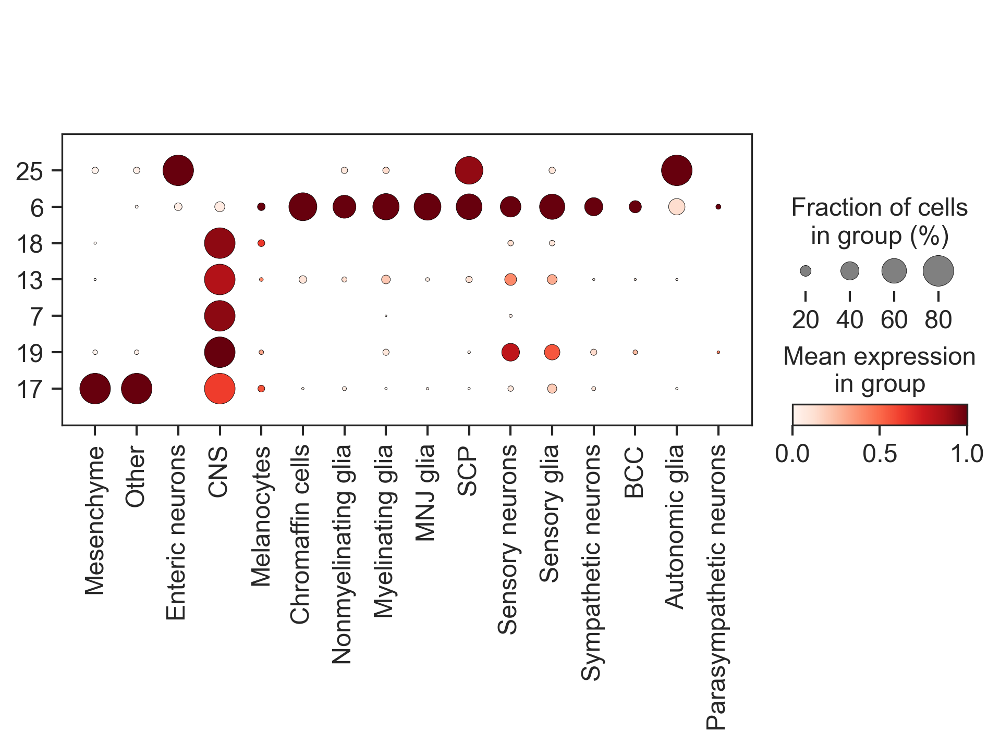

In [211]:
clones_NC_l2.obs["leiden_3"] = (
    clones_NC_l1.obs["leiden_3"]
    .astype("category")
    .cat
    .reorder_categories(["25", "6", "18", "13", "7", "19", "17"])
)

ct_order = [
    "Other", "Mesenchyme", "CNS", "Enteric neurons", 
    "Autonomic glia", "SCP", "Nonmyelinating glia",
    "Myelinating glia", "Chromaffin cells", "MNJ glia",
    "Sensory neurons", "Sensory glia", "BCC", "Sympathetic neurons",
    "Parasympathetic neurons", "Melanocytes", "Glia"
]

sc.pl.dotplot(
    clones_NC_l2,
    var_names=clones_NC_l2.var_names,
    groupby="leiden_3",
    log=True,
    standard_scale="var",
    dot_max=0.8,
)

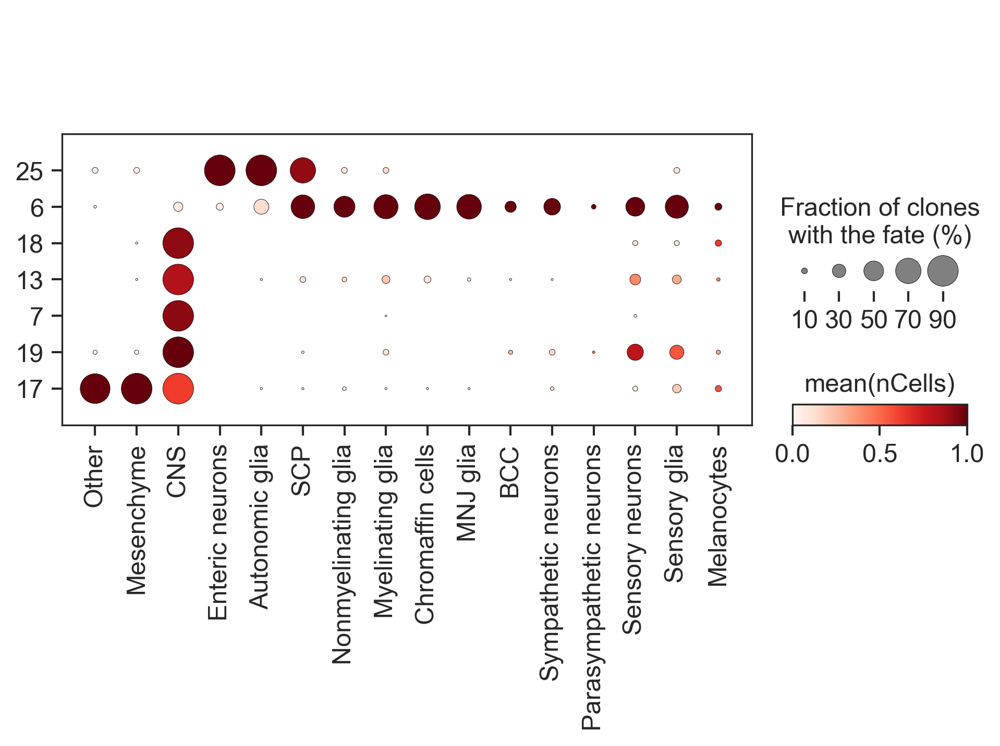

In [213]:
clones_NC_l2.obs["leiden_3"] = (
    clones_NC_l1.obs["leiden_3"]
    .astype("category")
    .cat
    .reorder_categories(["25", "6", "18", "13", "7", "19", "17"])
)

ct_order = [
    "Other", "Mesenchyme", "CNS", "Enteric neurons", 
    "Autonomic glia", "SCP", "Nonmyelinating glia",
    "Myelinating glia", "Chromaffin cells", "MNJ glia",
    "BCC", "Sympathetic neurons", "Parasympathetic neurons", 
    "Sensory neurons", "Sensory glia", "Melanocytes"
]

sc.pl.dotplot(
    clones_NC_l2,
    var_names=ct_order,
    groupby="leiden_3",
    log=True,
    standard_scale="var",
    dot_max=0.9,
    colorbar_title="mean(nCells)",
    size_title="Fraction of clones\nwith the fate (%)",
    save="NC_celltypes.pdf"
)

In [214]:
clones_NC_expr = clones_expr[clones_expr.obs.leiden_3.isin(["25", "6", "18", "13", "7", "19", "17"])]

genes = np.array([
    "Hoxc13", "Hoxc12", "Hoxc11",
    "Hoxd11", "Hoxc10", "Hoxd9",
    "Hoxc8", "Hoxa7", "Hoxc6", "Hoxb5",
    "Hoxb4"
])

anterio_posterior_signature = dict(enumerate(genes[::-1]))
anterio_posterior_signature = dict(zip(anterio_posterior_signature.values(), [i + 1 for i in anterio_posterior_signature.keys()]))

clones_NC_expr.obs["Hox_score"] = (
    clones_NC_expr[:, list(anterio_posterior_signature.keys())].X *
    np.array(list(anterio_posterior_signature.values())) / 
    clones_NC_expr[:, list(anterio_posterior_signature.keys())].X.sum(axis=1).T.A
)[0]

clones_NC_expr.obs["Hox_score"] = (
    clones_NC_expr.obs["Hox_score"] - clones_NC_expr.obs["Hox_score"].min()
) / (clones_NC_expr.obs["Hox_score"].max() - clones_NC_expr.obs["Hox_score"].min())

clones_NC_expr.obs["Hox_score"] = [i if str(i) != "nan" else 0.5 for i in clones_NC_expr.obs["Hox_score"]]

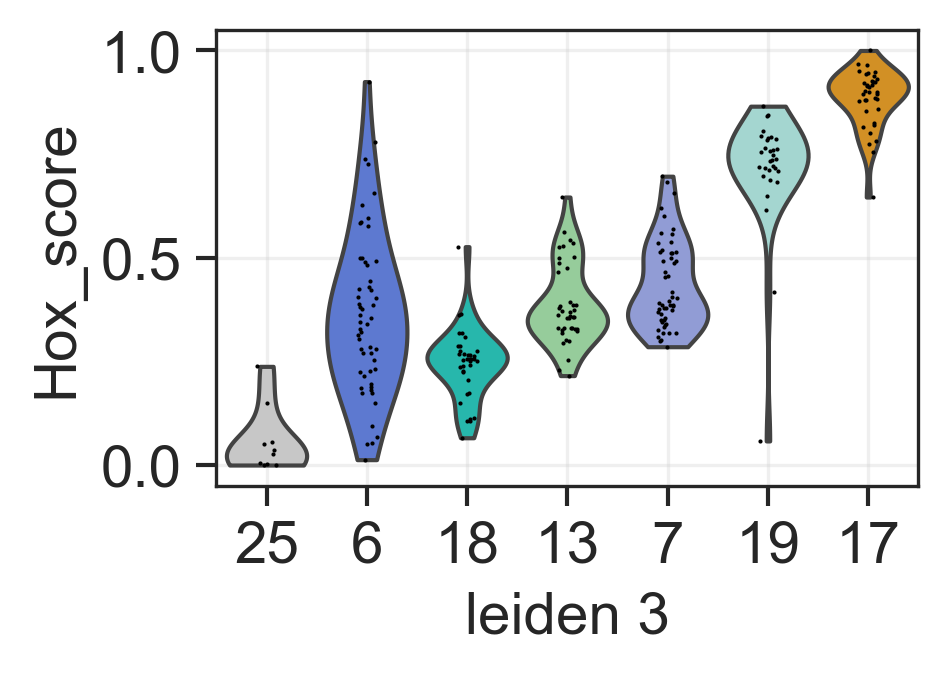

In [217]:
clones_NC_expr.obs["leiden_3"] = (
    clones_NC_expr.obs["leiden_3"]
    .astype("category")
    .cat
    .reorder_categories(["25", "6", "18", "13", "7", "19", "17"])
)
d = dict(zip(clones.obs.leiden_3.cat.categories, clones.uns["leiden_3_colors"]))
clones_NC_expr.uns["leiden_3_colors"] = [d[i] for i in clones_NC_expr.obs.leiden_3.cat.categories]

fig, ax = plt.subplots(figsize=(3, 2))
sc.pl.violin(clones_NC_expr, groupby="leiden_3", keys="Hox_score", ax=ax, show=False)
ax.grid(alpha=0.3)

plt.savefig("figures/violin_HOX_NC.pdf")

In [338]:
mapping = {"E7.5": {}, "E8.5": {}}

for clonename in clones.obs_names:
    timepoint = clonename.split(":")[0]
    clone = ":".join(clonename.split(":")[1:])
    leiden = dict(zip(
        ["0.5", "1", "2", "3"],
        [clones.obs.loc[clonename][f"leiden_{i}"] for i in ["0.5", "1", "2", "3"]]
    ))
    mapping[timepoint][clone] = leiden
    
clusters = {"0.5": [], "1": [], "2": [], "3": []}

for i, bc in adata_NC.obs.iterrows():
    if (bc["E8.5:clones"] in mapping["E8.5"]) and (bc["E7.5:clones"] in mapping["E7.5"]):
        if mapping["E8.5"][bc["E8.5:clones"]] != mapping["E7.5"][bc["E7.5:clones"]]:
            for cluster in clusters:
                clusters[cluster].append("conflict")
        else:
            for cluster in clusters:
                clusters[cluster].append(mapping["E8.5"][bc["E8.5:clones"]][cluster])
    elif bc["E8.5:clones"] in mapping["E8.5"]:
        for cluster in clusters:
            clusters[cluster].append(mapping["E8.5"][bc["E8.5:clones"]][cluster])
    elif bc["E7.5:clones"] in mapping["E7.5"]:
        for cluster in clusters:
            clusters[cluster].append(mapping["E7.5"][bc["E7.5:clones"]][cluster])
    else:
        for cluster in clusters:
            clusters[cluster].append("NA")
            
clusters = pd.DataFrame(clusters, index=adata_NC.obs_names)

for leiden in ["0.5", "1", "2", "3"]:
    adata_NC.obs[f"clones_clusters_{leiden}"] = clusters[leiden]

In [526]:
clones_NC_expr.uns["leiden_3_colors"]

['#c7c7c7', '#4a6fe3', '#0fcfc0', '#8dd593', '#8595e1', '#9cded6', '#ef9708']

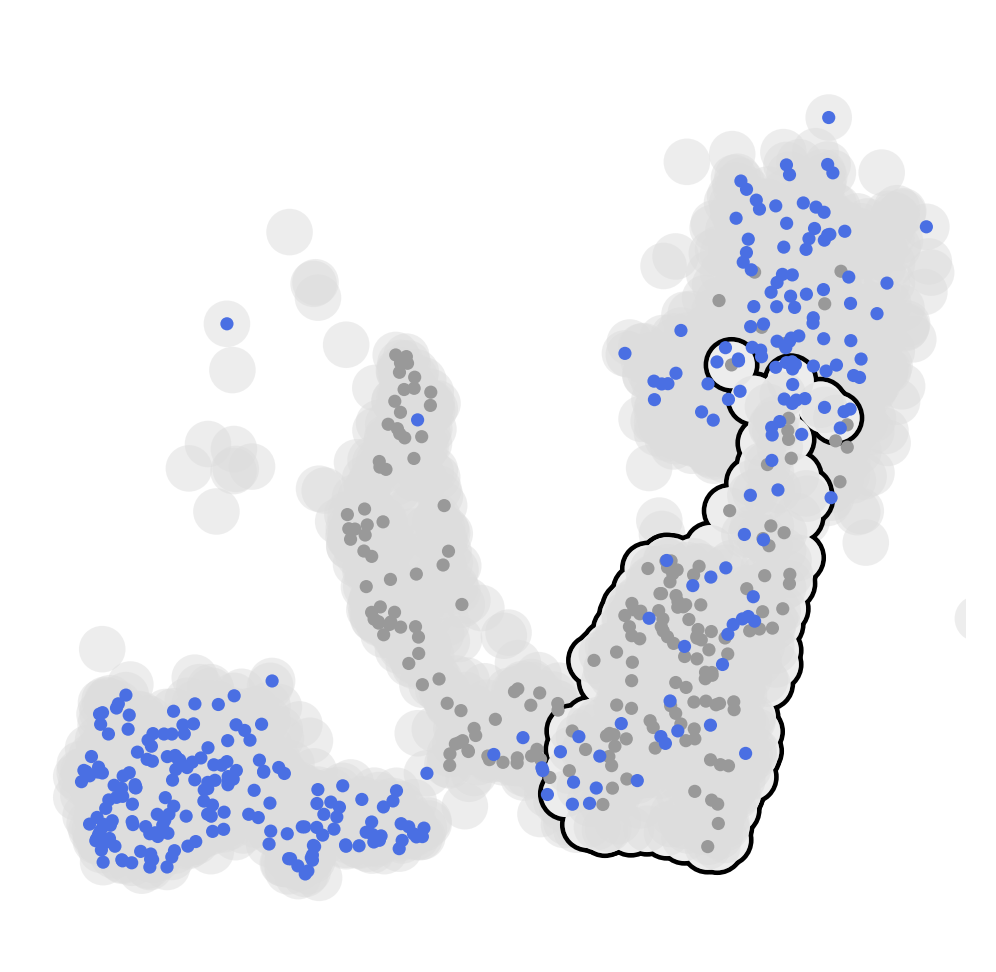

In [572]:
fig, ax = plt.subplots(figsize=(4, 4))

adata_draw = adata_NC[adata_NC.obs.celltype_NC_l2.isin([
    "Autonomic glia",
    "SCP",
    "Enteric neurons",
    "Chromaffin cells",
])]
adata_draw.uns["celltype_NC_l2_colors"] = [l2_colors[i] for i in adata_draw.obs.celltype_NC_l2.cat.categories]

sc.pl.umap(adata_draw, ax=ax, show=False, frameon=False, s=500, alpha=0.5, na_color="#DDDDDD")
sc.pl.umap(adata_draw[adata_draw.obs.celltype_NC_l2 == "Autonomic glia"], ax=ax, show=False, frameon=False, s=500, alpha=0.5,
           add_outline=True, outline_width=(0.1, 0), na_color="#DDDDDD")
sc.pl.umap(adata_draw[adata_draw.obs.clones_clusters_3 == "25"], ax=ax, show=False, frameon=False, s=40, na_color="#999999")
sc.pl.umap(adata_draw[adata_draw.obs.clones_clusters_3 == "6"], ax=ax, show=False, frameon=False, s=40, na_color="#4a6fe3")

ax.set_ylim(-0, 10)
ax.set_xlim(-6, 10.5)

plt.savefig("figures/SCP_trajectories.pdf", bbox_inches="tight")

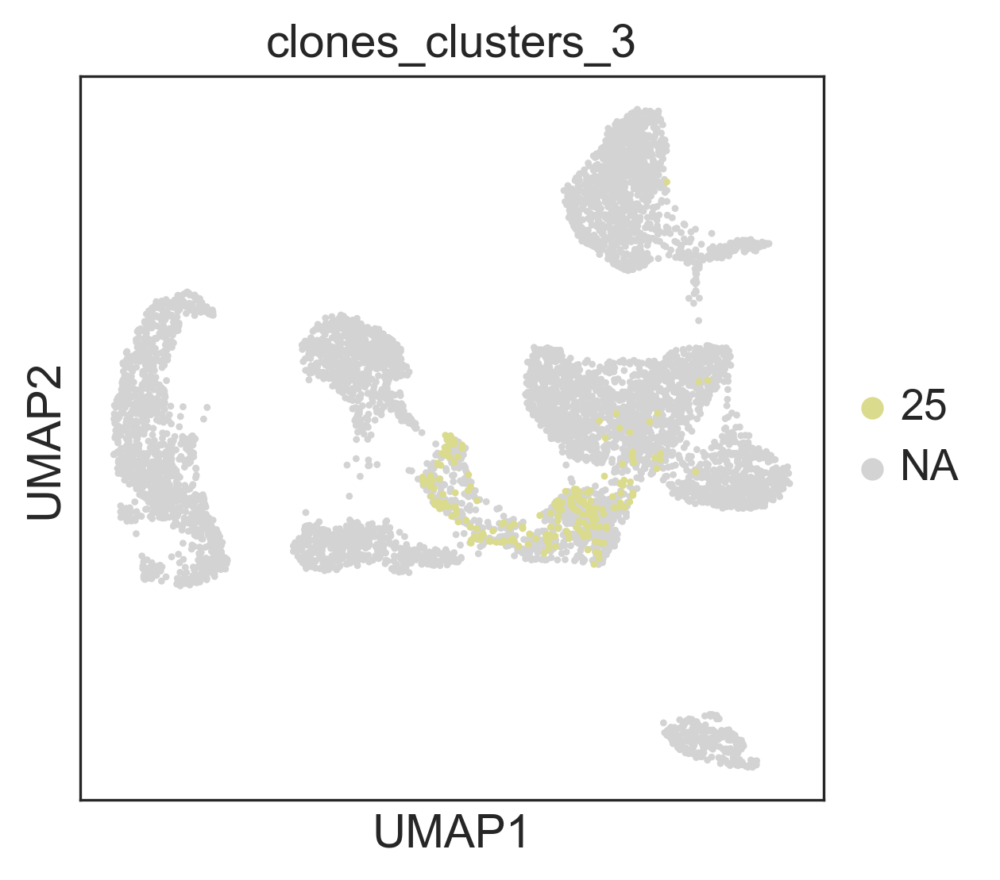

In [524]:
sc.pl.umap(adata_NC, color="clones_clusters_3", groups="25")

In [592]:
adata_de = adata_draw[adata_draw.obs.clones_clusters_3.isin(["25", "6"])]
adata_de = adata_de[adata_de.obs.celltype_NC_l2 == "Autonomic glia"]

adata_de.uns["log1p"]["base"] = None
sc.tl.rank_genes_groups(adata_de, groupby="clones_clusters_3", group="25", reference="6", method="t-test")
de = sc.get.rank_genes_groups_df(adata_de, group="25")

sc.pp.scale(adata_de, max_value=10)
genes = de[(de.logfoldchanges > 5) & (de.pvals_adj < 1e-5)].names

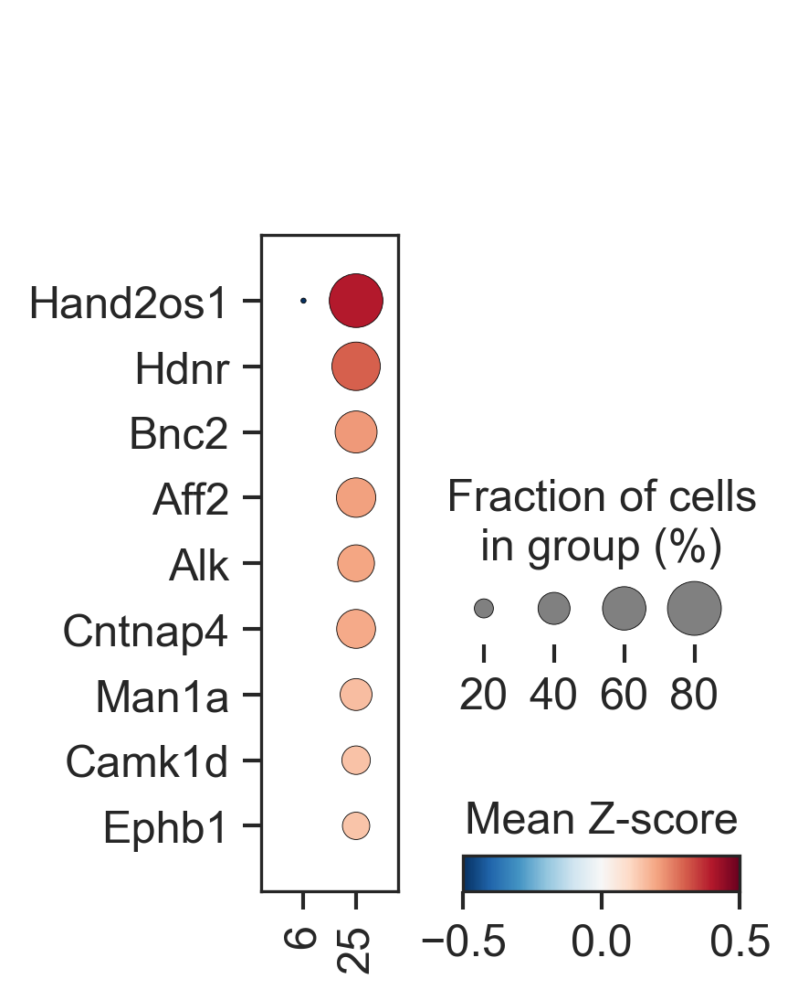

In [596]:
sc.pl.dotplot(
    adata_de,
    groupby="clones_clusters_3",
    var_names=genes,
    vmin=-0.5,
    vmax=0.5,
    cmap="RdBu_r",
    colorbar_title="Mean Z-score",
    swap_axes=True,
    save="enteric_markers.pdf"
)

In [607]:
from tqdm import tqdm

min_clonesize = 3

clones_whitelist_E7 = adata_NC_pert.obs["E7.5:clones"].value_counts()[
    adata_NC_pert.obs["E7.5:clones"].value_counts() >= min_clonesize
][1:].index

for_alek_E7 = {}

for clone in tqdm(clones_whitelist_E7):
    for_alek_E7[clone] = {}
    for ct in set(adata_NC_pert.obs.celltype_NC_l1):
        for_alek_E7[clone][ct] = sum((adata_NC_pert.obs["E7.5:clones"] == clone) & (adata_NC_pert.obs.celltype_NC_l1 == ct))

100%|██████████| 267/267 [00:01<00:00, 171.34it/s]


In [608]:
E7_clones_NC = sc.AnnData(pd.DataFrame(for_alek_E7)).T
clone_to_gRNA = dict(adata_NC_pert.obs[["E7.5:clones", "CRISPR:predicted"]].values)

E7_clones_NC.obs["gRNA"] = [clone_to_gRNA[i] for i in E7_clones_NC.obs_names]
E7_clones_NC = E7_clones_NC[~E7_clones_NC.obs.gRNA.isna()]
E7_clones_NC = E7_clones_NC[E7_clones_NC.obs.gRNA != "NA"]
E7_clones_NC = E7_clones_NC[E7_clones_NC.obs.gRNA.apply(lambda x: "|" not in x)]
E7_clones_NC = E7_clones_NC[E7_clones_NC.obs.gRNA != "uncertain"]

E7_clones_NC.layers["fraction"] = (E7_clones_NC.X.T / E7_clones_NC.X.sum(axis=1)).T
E7_clones_NC.layers["log1p"] = np.log1p(E7_clones_NC.X)

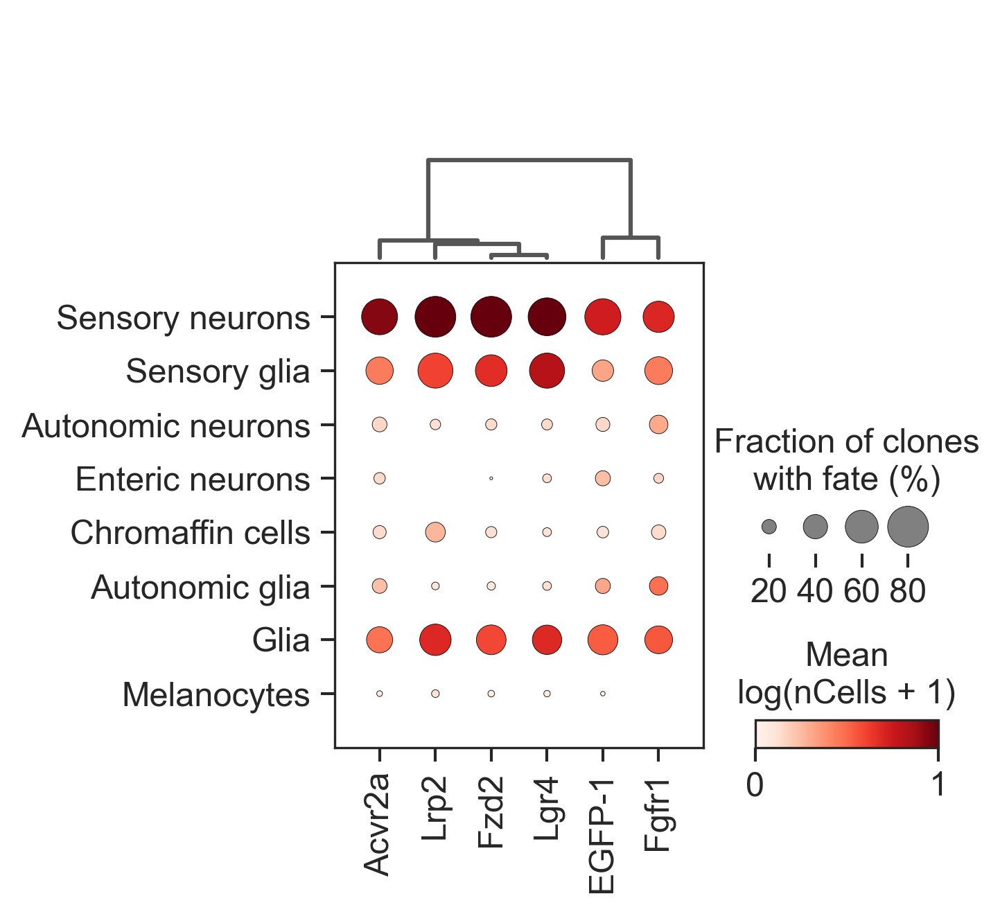

In [634]:
sc.pl.dotplot(E7_clones_NC, var_names=E7_clones_NC.var_names, groupby="gRNA", dendrogram=True, dot_max=0.8, vmax=1, swap_axes=True,
              size_title="Fraction of clones\nwith fate (%)", layer="log1p", colorbar_title="Mean\nlog(nCells + 1)", save="pert_dot_E7.pdf")

In [622]:
from tqdm import tqdm

min_clonesize = 3

clones_whitelist_E8 = adata_NC_pert.obs["E8.5:clones"].value_counts()[
    adata_NC_pert.obs["E8.5:clones"].value_counts() >= min_clonesize
][1:].index

for_alek_E8 = {}

for clone in tqdm(clones_whitelist_E8):
    for_alek_E8[clone] = {}
    for ct in set(adata_NC_pert.obs.celltype_NC_l1):
        for_alek_E8[clone][ct] = sum((adata_NC_pert.obs["E8.5:clones"] == clone) & (adata_NC_pert.obs.celltype_NC_l1 == ct))

100%|██████████| 288/288 [00:01<00:00, 168.85it/s]


In [623]:
E8_clones_NC = sc.AnnData(pd.DataFrame(for_alek_E8)).T
clone_to_gRNA = dict(adata_NC_pert.obs[["E8.5:clones", "CRISPR:predicted"]].values)

E8_clones_NC.obs["gRNA"] = [clone_to_gRNA[i] for i in E8_clones_NC.obs_names]
E8_clones_NC = E8_clones_NC[~E8_clones_NC.obs.gRNA.isna()]
E8_clones_NC = E8_clones_NC[E8_clones_NC.obs.gRNA != "NA"]
E8_clones_NC = E8_clones_NC[E8_clones_NC.obs.gRNA.apply(lambda x: "|" not in x)]
E8_clones_NC = E8_clones_NC[E8_clones_NC.obs.gRNA != "uncertain"]

E8_clones_NC.layers["fraction"] = (E8_clones_NC.X.T / E8_clones_NC.X.sum(axis=1)).T
E8_clones_NC.layers["log1p"] = np.log1p(E8_clones_NC.X)

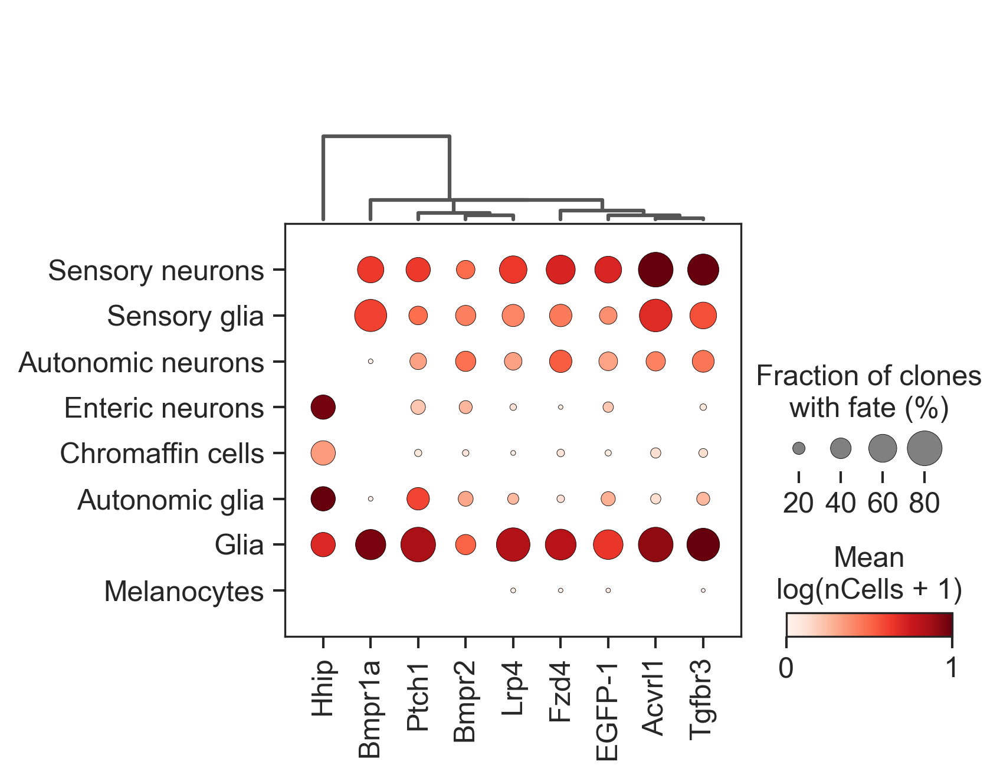

In [633]:
sc.pl.dotplot(E8_clones_NC, var_names=E8_clones_NC.var_names, groupby="gRNA", dendrogram=True, dot_max=0.8, swap_axes=True,
              size_title="Fraction of clones\nwith fate (%)", layer="log1p", colorbar_title="Mean\nlog(nCells + 1)", vmax=1,
              save="pert_dot_E8.pdf")

## Topic modelling

In [ ]:
adata_raw = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas_counts/reference_E13.h5ad")
adata_ref = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/mesenchyme_trunk_E13_noncycling_reference.h5ad")
adata_mes = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/trunk_mes_E13_clonal_clusters.h5ad")

adata_mes.layers["counts"] = adata_raw[adata_mes.obs_names, adata_mes.var_names].X.copy()
adata_mes.raw = adata_mes
adata_mes = adata_mes[:, adata_ref.var_names]

del adata_raw, adata_ref

adata_mes = adata_mes.copy()

In [4]:
import scvi

n_topics = 15

scvi.model.AmortizedLDA.setup_anndata(adata_mes, layer="counts")
model = scvi.model.AmortizedLDA(adata_mes, n_topics=n_topics)

An NVIDIA GPU may be present on this machine, but a CUDA-enabled jaxlib is not installed. Falling back to cpu.


In [5]:
model.train()

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 323/323: 100%|██████████| 323/323 [1:01:42<00:00,  8.99s/it, v_num=1, elbo_train=4.76e+8]

`Trainer.fit` stopped: `max_epochs=323` reached.


Epoch 323/323: 100%|██████████| 323/323 [1:01:42<00:00, 11.46s/it, v_num=1, elbo_train=4.76e+8]


In [7]:
topic_prop = model.get_latent_representation()
topic_prop.head()

,topic_0,topic_1,topic_2,topic_3,topic_4,topic_5,topic_6,topic_7,topic_8,topic_9,topic_10,topic_11,topic_12,topic_13,topic_14
10x70:AAACCCAGTCATCGGC,0.010771,0.006691,0.251784,0.157984,0.030755,0.007421,0.006632,0.003375,0.031852,0.456570,0.004603,0.003662,0.005138,0.015442,0.007319
10x70:AAACCCAGTCCCGTGA,0.059236,0.002807,0.008329,0.169605,0.120227,0.000788,0.030821,0.077758,0.003012,0.183564,0.001549,0.001592,0.020505,0.045670,0.274539
10x70:AAACCCAGTCGCAACC,0.004040,0.000952,0.002073,0.105851,0.242596,0.009740,0.003532,0.004577,0.020790,0.005160,0.003225,0.577332,0.000908,0.016981,0.002242
10x70:AAACCCAGTCGCGTTG,0.041070,0.021445,0.016504,0.246991,0.086393,0.018336,0.034046,0.024655,0.023261,0.056558,0.019715,0.017237,0.320396,0.045059,0.028334
10x70:AAACCCAGTGTATTGC,0.055726,0.003755,0.003145,0.027601,0.264771,0.003331,0.003146,0.003367,0.213699,0.005598,0.003467,0.388746,0.006152,0.014389,0.003106


In [9]:
adata_mes.obsm["X_LDA"] = topic_prop
for i in range(n_topics):
    adata_mes.obs[f"LDA_topic_{i}"] = topic_prop[[f"topic_{i}"]]

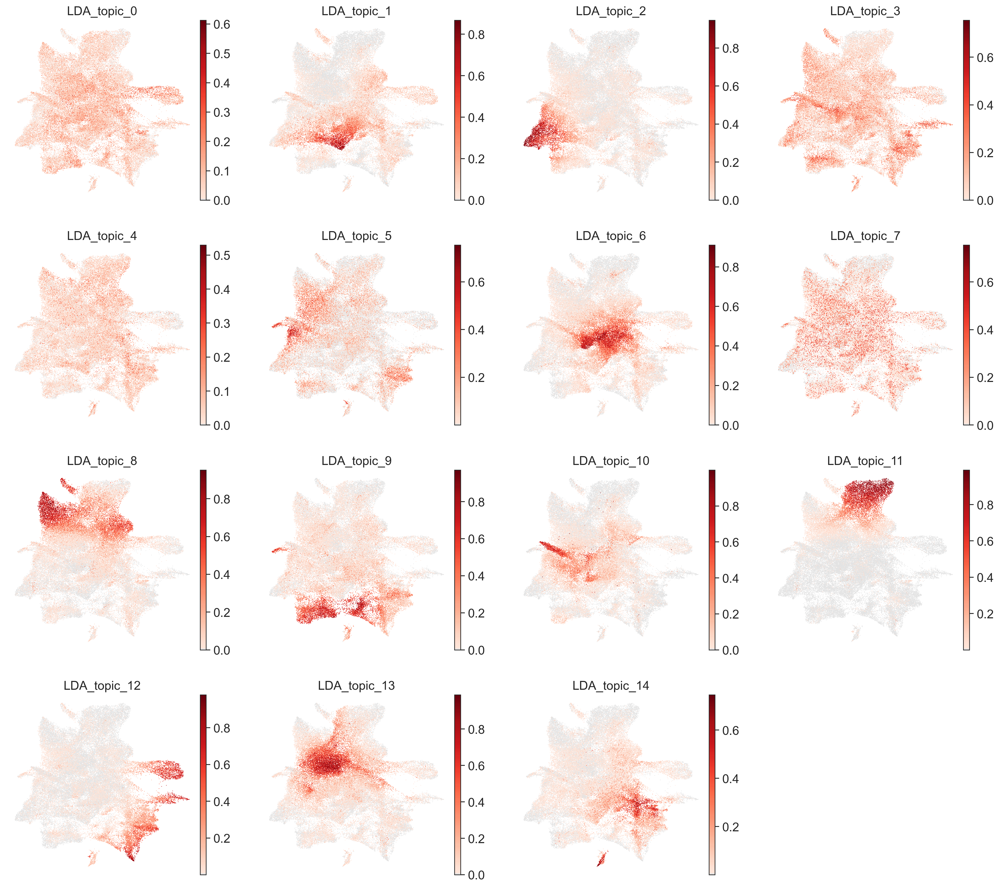

In [11]:
sc.pl.umap(
    adata_mes,
    color=[f"LDA_topic_{i}" for i in range(n_topics)],
    frameon=False,
    cmap=mb.pl.beautiful_cmap()
)

In [12]:
feature_by_topic = model.get_feature_by_topic()
feature_by_topic.head()

,topic_0,topic_1,topic_2,topic_3,topic_4,topic_5,topic_6,topic_7,topic_8,topic_9,topic_10,topic_11,topic_12,topic_13,topic_14
0610025J13Rik,1.079657e-06,1.398610e-05,6.268486e-07,1.882405e-05,1.623982e-06,3.686478e-06,2.781229e-05,1.044673e-05,3.218221e-07,8.608694e-07,6.678994e-06,1.351180e-07,2.343529e-07,1.614133e-06,2.530047e-06
1200007C13Rik,1.612401e-07,1.936044e-07,2.576564e-07,5.000626e-07,2.923065e-06,3.234130e-07,1.193189e-07,3.723796e-07,1.250014e-07,1.427601e-07,8.771182e-07,6.510637e-07,1.508384e-05,1.501532e-07,8.846752e-06
1500015L24Rik,7.612084e-07,2.420240e-05,1.669956e-07,2.588960e-06,1.642055e-05,2.610841e-07,3.058279e-07,2.371951e-07,5.793574e-06,1.757735e-07,3.815607e-07,7.185391e-06,1.373653e-06,2.492223e-07,1.562777e-05
1600014C10Rik,6.918699e-06,1.296694e-06,3.218714e-05,8.337099e-05,3.694592e-06,5.103346e-05,3.539378e-05,9.387288e-05,4.163616e-05,5.566939e-05,2.861139e-05,3.305861e-05,3.916537e-05,6.166844e-05,2.965240e-05
1600027J07Rik,2.502385e-07,6.436298e-07,5.557015e-06,1.288722e-05,3.140937e-07,5.946734e-05,1.046010e-07,2.623633e-05,6.411148e-07,3.324930e-07,2.566558e-07,1.229483e-07,2.166383e-07,4.990927e-05,1.550810e-07


In [21]:
topic_prop.to_csv("control_mes_topics_probs.csv")
feature_by_topic.to_csv("control_mes_topics_genes.csv")

In [17]:
rank_by_topic = pd.DataFrame()

for i in range(n_topics):
    topic_name = f"topic_{i}"
    topic = feature_by_topic[topic_name].sort_values(ascending=False)
    rank_by_topic[topic_name] = topic.index
    rank_by_topic[f"{topic_name}_prop"] = topic.values

In [68]:
rank_by_topic

,topic_0,topic_0_prop,topic_1,topic_1_prop,topic_2,topic_2_prop,topic_3,topic_3_prop,topic_4,topic_4_prop,...,topic_10,topic_10_prop,topic_11,topic_11_prop,topic_12,topic_12_prop,topic_13,topic_13_prop,topic_14,topic_14_prop
0,Malat1,5.612403e-01,Col3a1,4.008959e-02,Malat1,4.412613e-02,mt-Co3,1.328933e-01,Fos,1.073837e-01,...,Malat1,3.052122e-02,Col2a1,5.378541e-02,mt-Co3,3.730593e-02,Malat1,6.311151e-02,Ptn,7.250361e-02
1,Meg3,1.299765e-02,Malat1,3.261226e-02,mt-Co3,2.961519e-02,Rpsa,7.973478e-02,mt-Co3,8.483354e-02,...,Zfhx3,2.798785e-02,Malat1,3.602824e-02,Malat1,2.696474e-02,mt-Co3,3.353979e-02,Malat1,3.255307e-02
2,Cdkn1c,1.179657e-02,Ptn,3.075158e-02,Rpsa,1.870022e-02,Tmsb10,4.866226e-02,Jun,5.154746e-02,...,mt-Co3,1.834561e-02,Col11a1,3.593602e-02,Acta2,1.868677e-02,Ebf1,2.589061e-02,Tmsb4x,1.919664e-02
3,Ptn,9.743265e-03,Col1a2,3.055297e-02,Tcf4,1.716906e-02,Tmsb4x,4.399768e-02,Malat1,5.066887e-02,...,Epha3,1.516598e-02,mt-Co3,2.821051e-02,Gpc6,1.624345e-02,Galntl6,2.297012e-02,mt-Co3,1.803600e-02
4,Gnas,9.473521e-03,Cdkn1c,2.839590e-02,Tmem132c,1.421377e-02,Lgals1,3.411022e-02,Ier2,3.306808e-02,...,Hbb-bs,1.502409e-02,Cdkn1c,2.627885e-02,Rpsa,1.364677e-02,Rpsa,1.365848e-02,Col3a1,1.775127e-02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2995,Insl3,1.098881e-07,Il18rap,7.872642e-08,Potefam2,1.168073e-07,Gm15906,8.492992e-08,Cst8,1.727441e-07,...,Gm1527,1.205490e-07,Prl8a8,8.433506e-08,Mtnr1b,1.049196e-07,D330037F02Rik,7.665345e-08,Cst8,9.652716e-08
2996,Gm15906,1.069536e-07,Gpr139,7.699835e-08,Cst11,1.162475e-07,Gm15891,8.166243e-08,Cst11,1.720253e-07,...,Gpr55,1.177877e-07,Gm32815,8.243531e-08,Gm41492,1.013495e-07,Insl3,7.493031e-08,Cst11,9.472590e-08
2997,Cst8,1.041928e-07,Olfr569,7.650436e-08,ENSMUSG00000120246,1.157670e-07,Gm47777,8.003592e-08,Potefam2,1.697403e-07,...,Gdf2,1.168101e-07,Fam240b,8.217926e-08,Abca15,9.914612e-08,Gp1ba,7.410755e-08,Xlr5c,9.431199e-08
2998,Cst11,1.025004e-07,Potefam2,7.392760e-08,Gm15906,1.149067e-07,Potefam2,7.698023e-08,Gm15906,1.684721e-07,...,Gm28516,1.148592e-07,Gm28516,7.930307e-08,Ttll8,9.597399e-08,Gm11209,7.376153e-08,Gm48664,9.022565e-08


In [25]:
adata_all = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/trunk_E13_clonal_clusters.h5ad")

Text(0, 0.5, 'Number of clones')

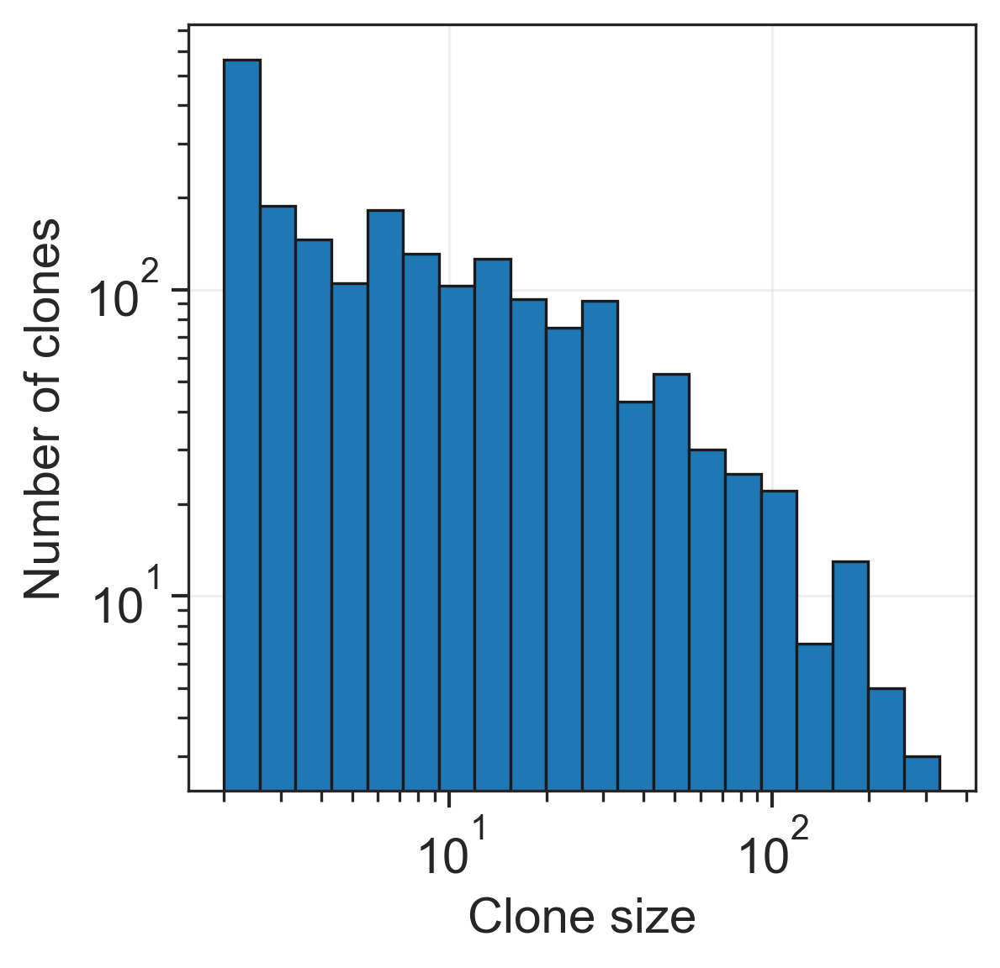

In [69]:
clone_sizes = adata_all.obs["E7.5:clones"].value_counts()[adata_all.obs["E7.5:clones"].value_counts() > 1][1:]

ax = sns.histplot(
    clone_sizes,
    bins=20,
    log_scale=True,
    edgecolor="k",
    alpha=1,
)

ax.grid(alpha=0.3)
ax.set_yscale("log")
ax.set_xlabel("Clone size")
ax.set_ylabel("Number of clones")

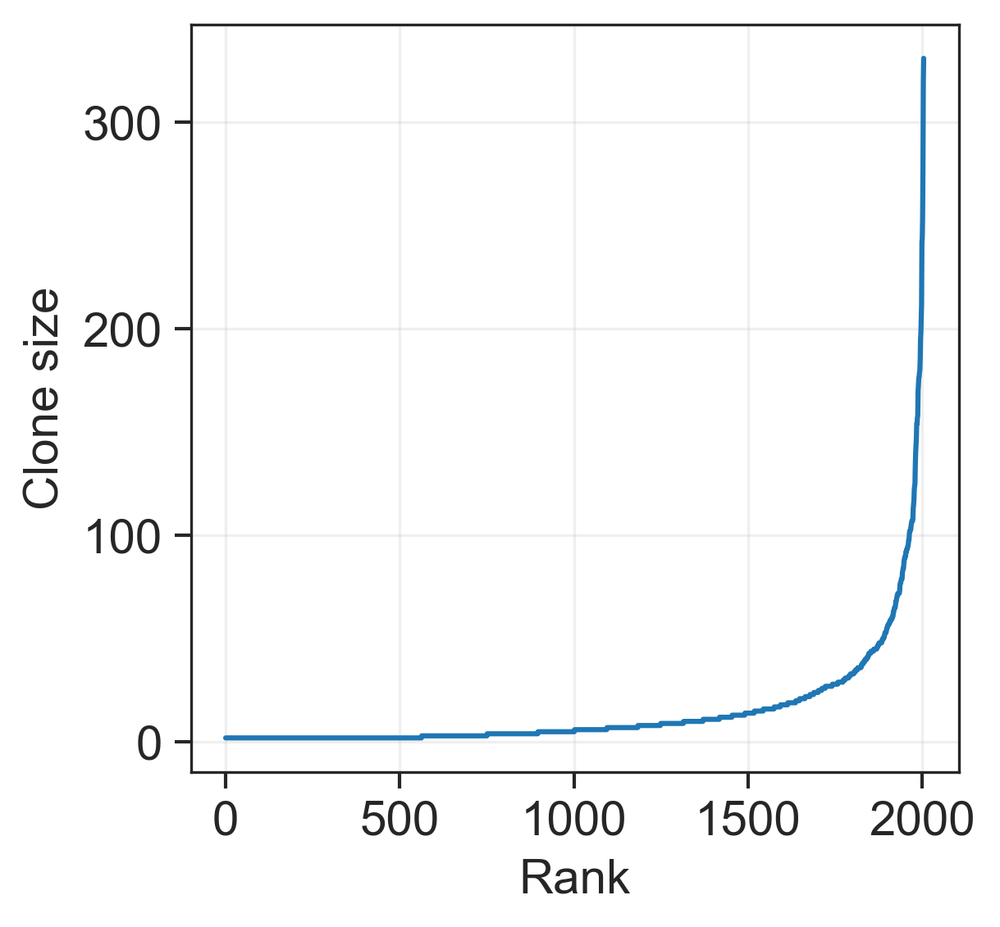

In [65]:
ax = sns.lineplot(
    x=np.arange(len(clone_sizes)),
    y=clone_sizes[::-1],
)
ax.set_ylabel("Clone size")
ax.set_xlabel("Rank")
ax.grid(alpha=0.3)

In [106]:
clones_expr = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/E13_clonal_embedding_expr.h5ad")
clones = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/E13_clonal_embedding.h5ad")
clones.obs["clone_size"] = clones.X.sum(axis=1)

clones_expr_mes = clones_expr[clones_expr.obs["leiden_0.5"].isin(["0", "1", "3", "4", "5"])]

In [115]:
clones[clones.obs["leiden_0.5"] == "1"].obs.sort_values("clone_size")

,injection_time,leiden_0.5,leiden_1,leiden_2,leiden_3,clone_size
clones,,,,,,
E7.5:injection6:clone_103,E7.5,1,6,13,16,10.0
E7.5:injection5:clone_462,E7.5,1,6,13,16,10.0
E8.5:injection2:clone_1388,E8.5,1,6,13,16,10.0
E7.5:injection5:clone_983,E7.5,1,6,13,16,10.0
E8.5:injection5:clone_342,E8.5,1,2,10,26,10.0
...,...,...,...,...,...,...
E7.5:injection5:clone_35,E7.5,1,2,10,8,107.0
E7.5:injection5:clone_61,E7.5,1,2,10,8,117.0
E7.5:injection5:clone_377,E7.5,1,2,10,8,154.0


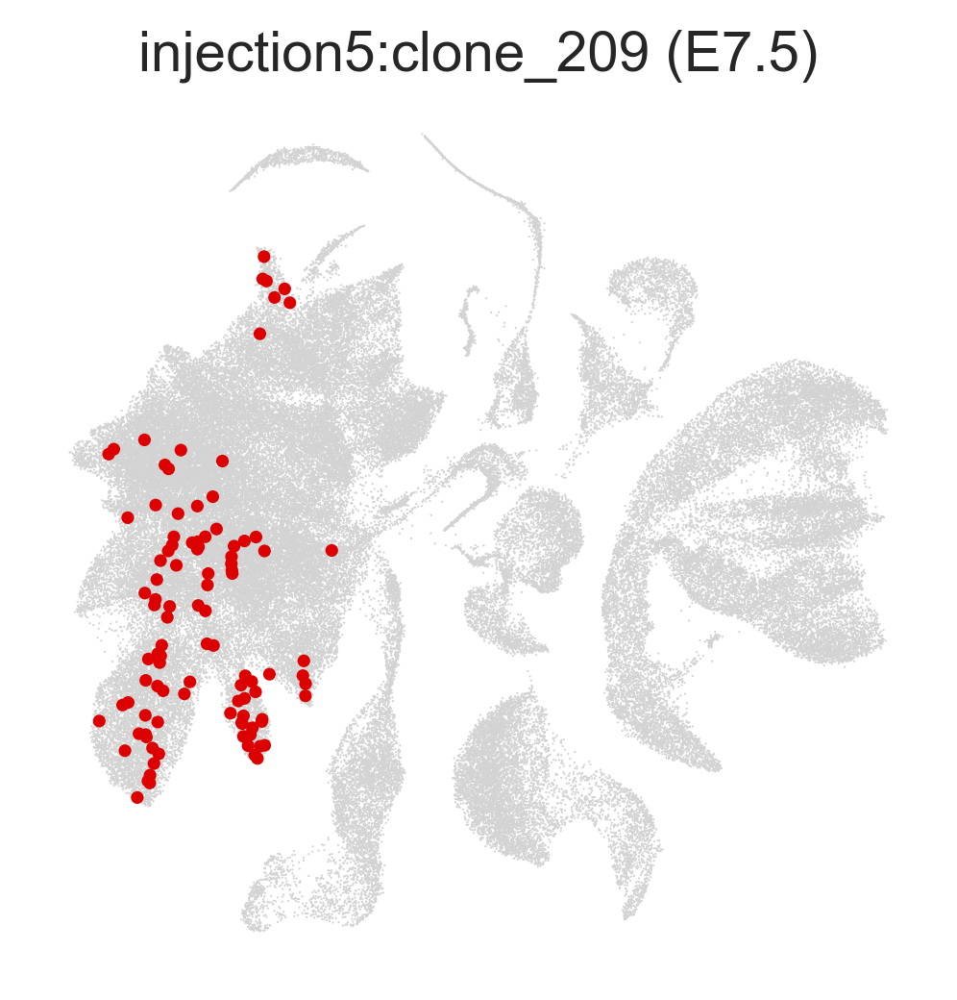

In [122]:
fig, ax = plt.subplots(figsize=(4, 4))

timepoint = "E7.5"
clone = "injection5:clone_209"

sc.pl.umap(adata_all, ax=ax, show=False, frameon=False)
sc.pl.umap(
    adata_all[
        adata_all.obs[f"{timepoint}:clones"] == clone
    ],
    ax=ax,
    show=False,
    frameon=False,
    s=40,
    na_color="#DD0000",
    title=f"{clone} ({timepoint})",
)

plt.savefig("../figures/fig1/example_clone_1.pdf", bbox_inches="tight")

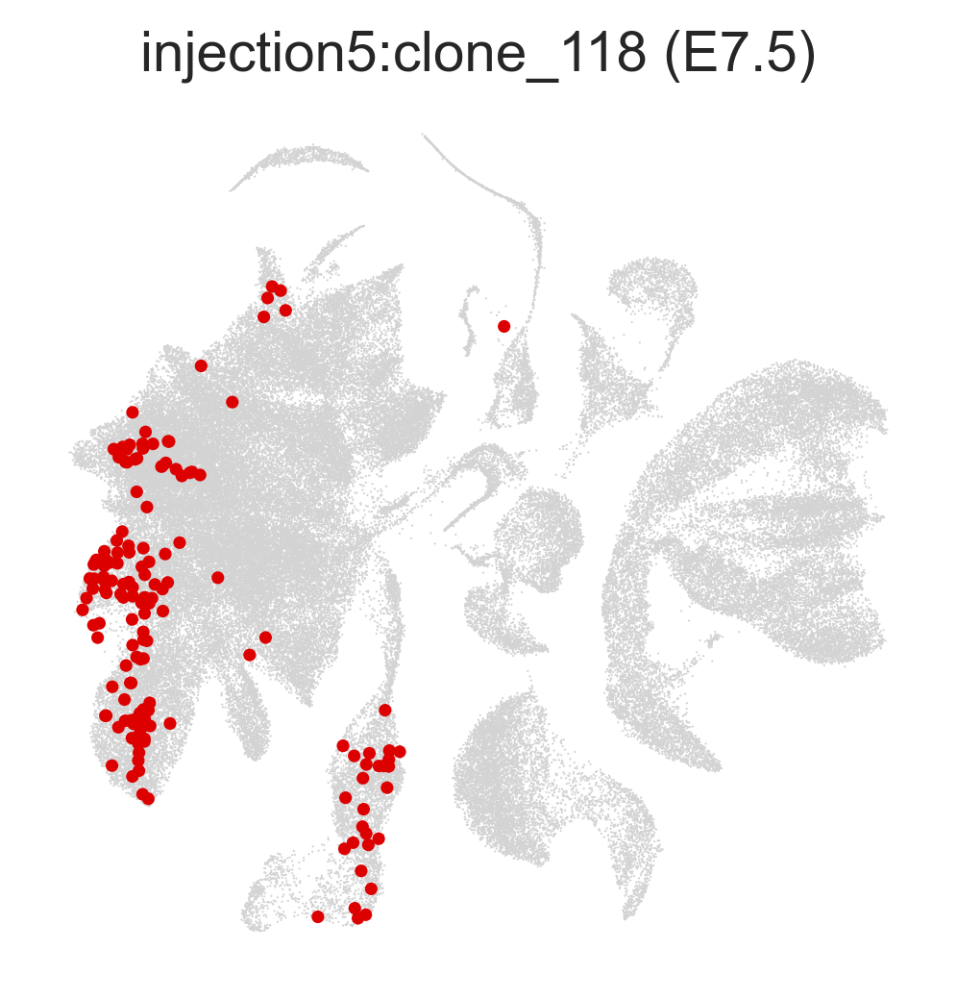

In [123]:
fig, ax = plt.subplots(figsize=(4, 4))

timepoint = "E7.5"
clone = "injection5:clone_118"

sc.pl.umap(adata_all, ax=ax, show=False, frameon=False)
sc.pl.umap(
    adata_all[
        adata_all.obs[f"{timepoint}:clones"] == clone
    ],
    ax=ax,
    show=False,
    frameon=False,
    s=40,
    na_color="#DD0000",
    title=f"{clone} ({timepoint})",
)

plt.savefig("../figures/fig1/example_clone_2.pdf", bbox_inches="tight")

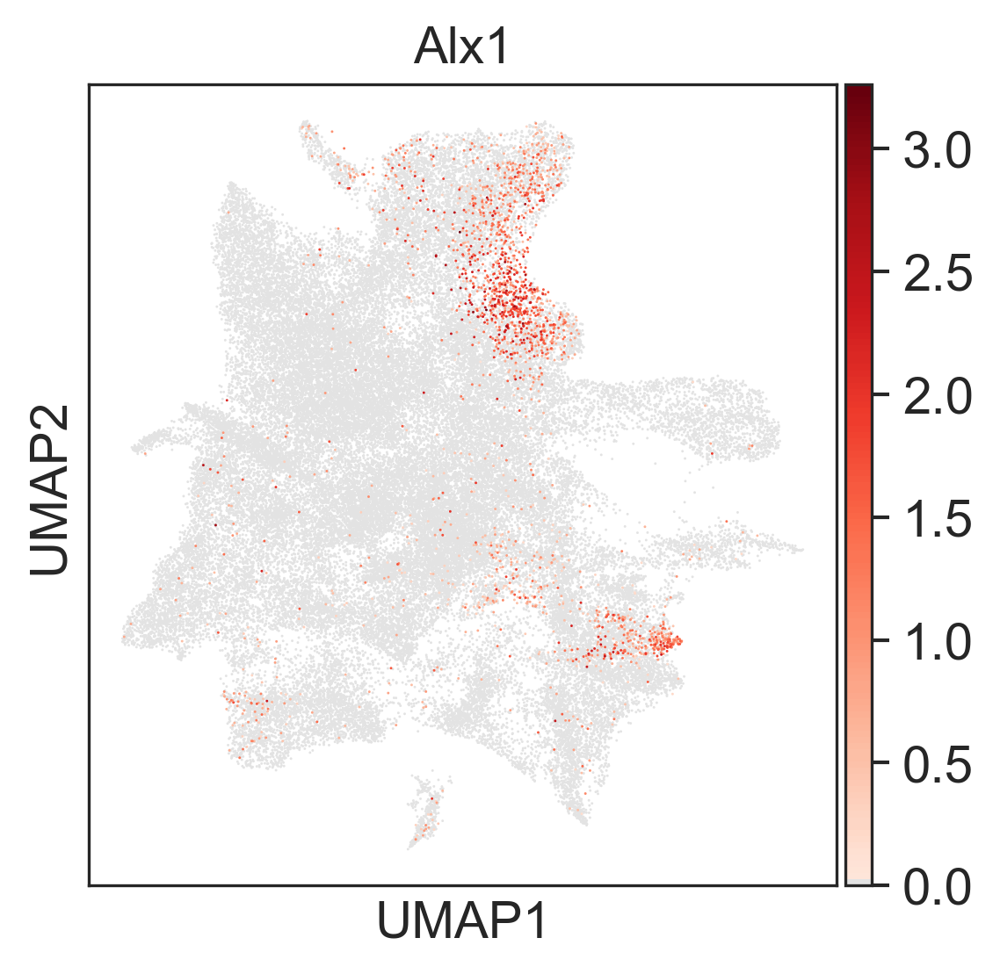

In [618]:
sc.pl.umap(adata_mes, color="Alx1", cmap=mb.pl.beautiful_cmap())

In [179]:
E7_distribution = adata_all[adata_all.obs.batch == "injection5"].obs.groupby(["E7.5:clones", "celltype_l0"]).size().unstack().iloc[1:]
E8_distribution = adata_all[adata_all.obs.batch == "injection5"].obs.groupby(["E8.5:clones", "celltype_l0"]).size().unstack().iloc[1:]

In [371]:
bin_step = 5
min_clones = 10

E7_props = pd.DataFrame({
    "n_fates": (E7_distribution > 0).sum(axis=1),
    "size": E7_distribution.sum(axis=1),
})

E8_props = pd.DataFrame({
    "n_fates": (E8_distribution > 0).sum(axis=1),
    "size": E8_distribution.sum(axis=1),
})

E7_props["bin"] = (E7_props["size"] // bin_step * bin_step)
E7_props.index = "E7.5:" + E7_props.index.astype(str)
E7_props["time"] = "E7.5"
E8_props["bin"] = (E8_props["size"] // bin_step * bin_step)
E8_props.index = "E7.5:" + E8_props.index.astype(str)
E8_props["time"] = "E8.5"

E7E8_props = pd.concat([E7_props, E8_props])

bins_whitelist = list(set(
    E7_props.bin.value_counts()[E7_props.bin.value_counts() > min_clones].index
).intersection(set(
    E8_props.bin.value_counts()[E8_props.bin.value_counts() > min_clones].index
)))

E7E8_props = E7E8_props[E7E8_props.bin.isin(bins_whitelist)]

Text(0.5, 1.0, 'Multipotency restriction')

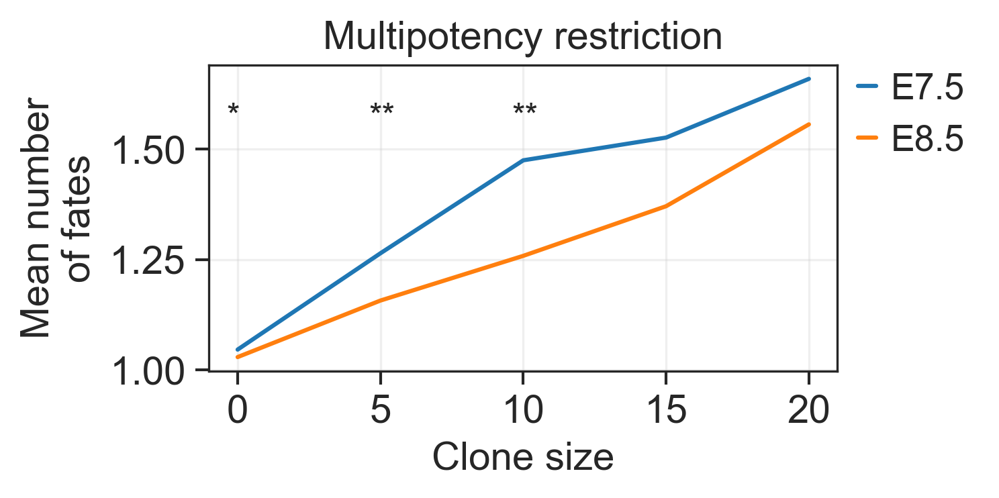

In [373]:
fig, ax = plt.subplots(figsize=(4, 2))

sns.lineplot(
    x="bin",
    y="n_fates",
    hue="time",
    data=E7E8_props.groupby(["bin", "time"]).mean()["n_fates"].reset_index(),
    ax=ax,
)

from scipy.stats import mannwhitneyu

for b in bins_whitelist:
    p = mannwhitneyu(
        E7E8_props[(E7E8_props.bin == b) & (E7E8_props.time == "E7.5")].n_fates,
        E7E8_props[(E7E8_props.bin == b) & (E7E8_props.time == "E8.5")].n_fates,
    ).pvalue
    if p < 0.001:
        p = "***"
    elif p < 0.01:
        p = "**"
    elif p < 0.05:
        p = "*"
    else:
        p = " "
    ax.text(x=b - 0.4, y=1.55, s=p, size=12)
    
ax.legend(loc=(1.01, 0.65), edgecolor="white")
ax.set_xlabel("Clone size")
ax.set_ylabel("Mean number\nof fates")
ax.grid(alpha=0.3)

ax.set_title("Multipotency restriction")

In [490]:
clones_expr_mes.obsm["word2vec_pca"] = sc.pp.pca(clones_expr_mes.obsm["word2vec"], n_comps=3)

In [ ]:
genes = np.array([
    "Hoxc13", "Hoxb13", "Hoxc12", "Hoxc11",
    "Hoxd11", "Hoxa10", "Hoxc10", "Hoxd9",
    "Hoxc8", "Hoxa7", "Hoxc6", "Hoxb5",
    "Hoxb4", "Hoxb3"
])

Text(0.5, 103.87500000000004, 'clone2vec PC2')

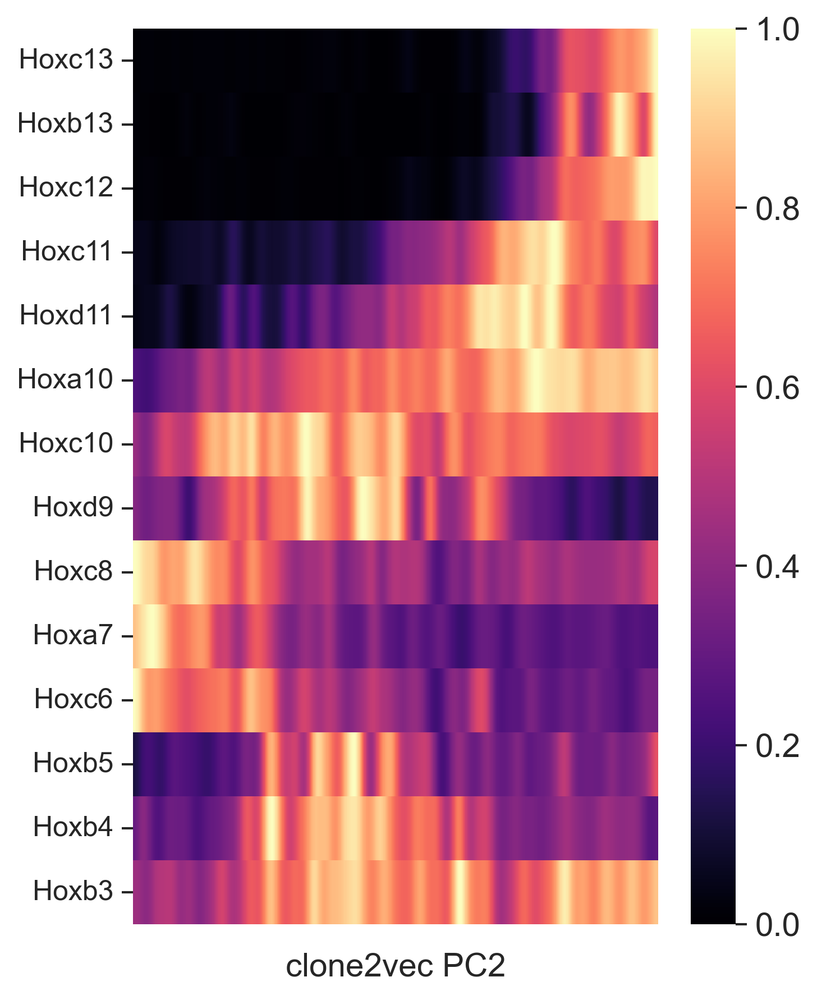

In [617]:
from scipy.ndimage.filters import gaussian_filter


genes = np.array([
    "Hoxc13", "Hoxb13", "Hoxc12", "Hoxc11",
    "Hoxd11", "Hoxa10", "Hoxc10", "Hoxd9",
    "Hoxc8", "Hoxa7", "Hoxc6", "Hoxb5",
    "Hoxb4", "Hoxb3"
])
PC = 1
sigma = 10

fig, ax = plt.subplots(figsize=(5, 0.5 * len(genes)))

order = np.argsort(clones_expr_mes.obsm["word2vec_pca"][:, PC])
heatmap = pd.DataFrame(clones_expr_mes[:, genes].X.A[order, :].T)
heatmap = pd.DataFrame([gaussian_filter(heatmap.iloc[i], sigma=sigma) for i in range(heatmap.shape[0])])
heatmap = (heatmap.T / heatmap.max(axis=1)).T
heatmap.index = genes

sns.heatmap(
    heatmap,
    cmap="magma",
    yticklabels=genes,
)

ax.tick_params(left=True, bottom=False, labelsize=12)
_ = ax.set_xticklabels([])
ax.set_xlabel(f"clone2vec PC{PC + 1}")

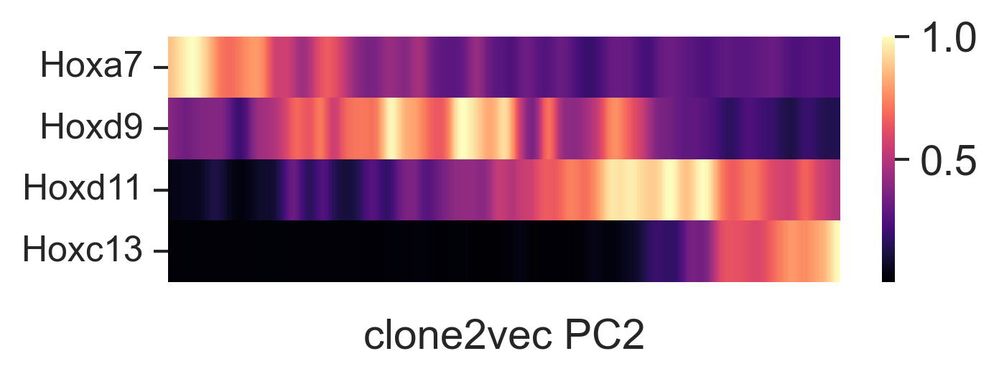

In [610]:
from scipy.ndimage.filters import gaussian_filter

fig, ax = plt.subplots(figsize=(5, 1.5))

genes = ["Hoxa7", "Hoxd9", "Hoxd11", "Hoxc13"]
PC = 1
sigma = 10

order = np.argsort(clones_expr_mes.obsm["word2vec_pca"][:, PC])
heatmap = pd.DataFrame(clones_expr_mes[:, genes].X.A[order, :].T)
heatmap = pd.DataFrame([gaussian_filter(heatmap.iloc[i], sigma=sigma) for i in range(heatmap.shape[0])])
heatmap = (heatmap.T / heatmap.max(axis=1)).T
heatmap.index = genes

sns.heatmap(
    heatmap,
    cmap="magma",
    yticklabels=genes,
)

ax.tick_params(left=True, bottom=False, labelsize=12)
_ = ax.set_xticklabels([])
ax.set_xlabel(f"clone2vec PC{PC + 1}")

plt.savefig("../figures/fig2/heatmap_pc2_hox.pdf", bbox_inches="tight")

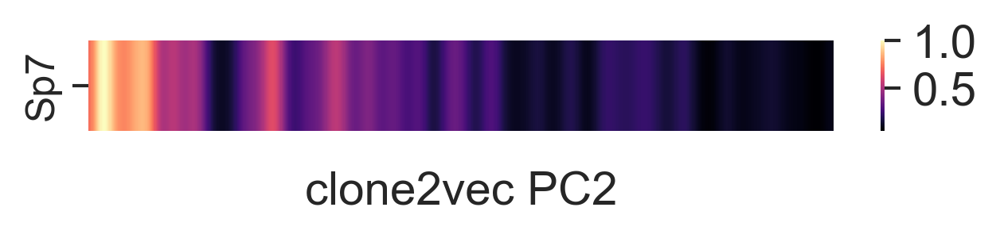

In [611]:
genes = ["Sp7"]
PC = 1
sigma = 10

fig, ax = plt.subplots(figsize=(5, len(genes) * 0.5))

order = np.argsort(clones_expr_mes.obsm["word2vec_pca"][:, PC])
heatmap = pd.DataFrame(clones_expr_mes[:, genes].X.A[order, :].T)
heatmap = pd.DataFrame([gaussian_filter(heatmap.iloc[i], sigma=sigma) for i in range(heatmap.shape[0])])
heatmap = (heatmap.T / heatmap.max(axis=1)).T
heatmap.index = genes

sns.heatmap(
    heatmap,
    cmap="magma",
    yticklabels=genes,
)

ax.tick_params(left=True, bottom=False, labelsize=12)
_ = ax.set_xticklabels([])
ax.set_xlabel(f"clone2vec PC{PC + 1}")

plt.savefig("../figures/fig2/heatmap_pc2_sp7.pdf", bbox_inches="tight")

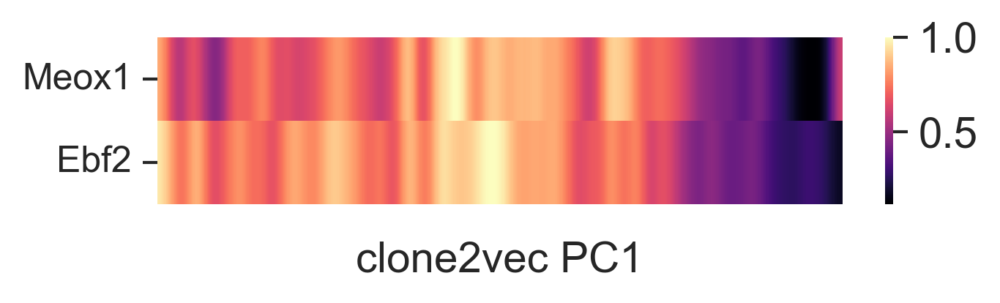

In [612]:
genes = ["Meox1", "Ebf2"]
PC = 0
sigma = 10

fig, ax = plt.subplots(figsize=(5, len(genes) * 0.5))

order = np.argsort(clones_expr_mes.obsm["word2vec_pca"][:, PC])
heatmap = pd.DataFrame(clones_expr_mes[:, genes].X.A[order, :].T)
heatmap = pd.DataFrame([gaussian_filter(heatmap.iloc[i], sigma=sigma) for i in range(heatmap.shape[0])])
heatmap = (heatmap.T / heatmap.max(axis=1)).T
heatmap.index = genes

sns.heatmap(
    heatmap,
    cmap="magma",
    yticklabels=genes,
)

ax.tick_params(left=True, bottom=False, labelsize=12)
_ = ax.set_xticklabels([])
ax.set_xlabel(f"clone2vec PC{PC + 1}")

plt.savefig("../figures/fig2/heatmap_pc1_prog.pdf", bbox_inches="tight")

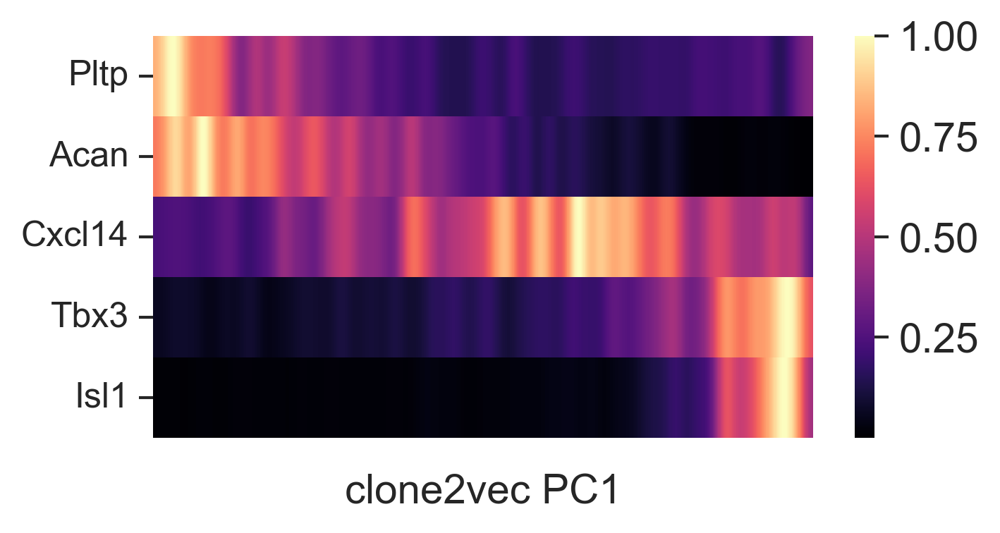

In [613]:
genes = ["Pltp", "Acan", "Cxcl14", "Tbx3", "Isl1"]
PC = 0
sigma = 10

fig, ax = plt.subplots(figsize=(5, len(genes) * 0.5))

order = np.argsort(clones_expr_mes.obsm["word2vec_pca"][:, PC])
heatmap = pd.DataFrame(clones_expr_mes[:, genes].X.A[order, :].T)
heatmap = pd.DataFrame([gaussian_filter(heatmap.iloc[i], sigma=sigma) for i in range(heatmap.shape[0])])
heatmap = (heatmap.T / heatmap.max(axis=1)).T
heatmap.index = genes

sns.heatmap(
    heatmap,
    cmap="magma",
    yticklabels=genes,
)

ax.tick_params(left=True, bottom=False, labelsize=12)
_ = ax.set_xticklabels([])
ax.set_xlabel(f"clone2vec PC{PC + 1}")

plt.savefig("../figures/fig2/heatmap_pc1_celltype.pdf", bbox_inches="tight")

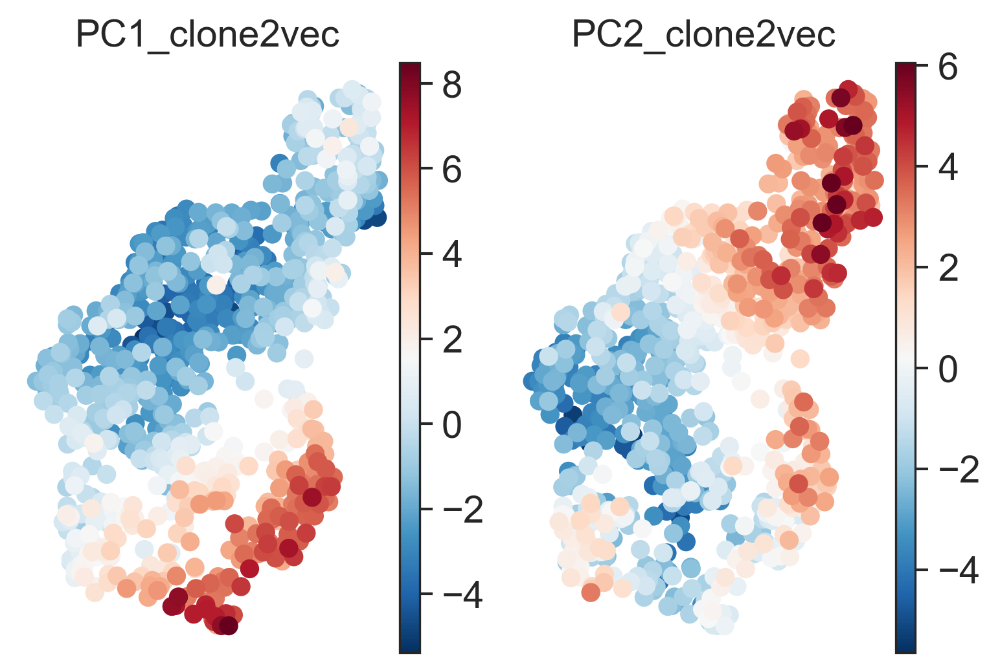

In [744]:
fig, axes = plt.subplots(ncols=2, figsize=(6, 4))

clones_expr_mes.obs["PC1_clone2vec"] = clones_expr_mes.obsm["word2vec_pca"][:, 0]
clones_expr_mes.obs["PC2_clone2vec"] = clones_expr_mes.obsm["word2vec_pca"][:, 1]

sc.pl.umap(clones_expr_mes, color="PC1_clone2vec", ax=axes[0], show=False, frameon=False, s=200, cmap="RdBu_r")
sc.pl.umap(clones_expr_mes, color="PC2_clone2vec", ax=axes[1], show=False, frameon=False, s=200, cmap="RdBu_r")

plt.savefig("../figures/fig2/PC_UMAP_mes.pdf", bbox_inches="tight")

In [579]:
ct2_ct0 = dict(adata_all.obs[["celltype_l2", "celltype_l0"]].values)
ct0_ct2 = {}

for ct2 in ct2_ct0:
    if ct2_ct0[ct2] not in ct0_ct2:
        ct0_ct2[ct2_ct0[ct2]] = []
    ct0_ct2[ct2_ct0[ct2]].append(ct2)
    
for ct0 in ct0_ct2:
    clones.obs[f"total_{ct0}"] = clones[:, ct0_ct2[ct0]].X.sum(axis=1)

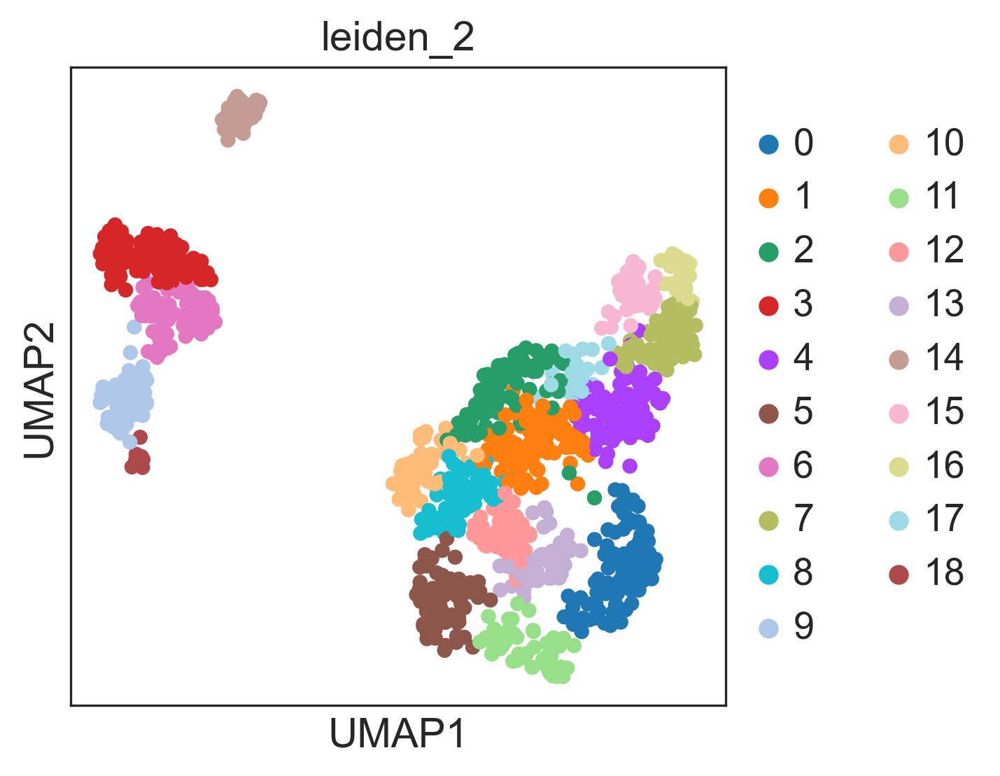

In [581]:
sc.pl.umap(clones, color="leiden_2")

In [602]:
cluster = "16"

df = clones[clones.obs.leiden_2 == cluster].obs[["total_Mesenchyme", "total_Neurons", "total_Glia"]]

Glia_Neur_Mes = sum((df.total_Mesenchyme > 0) & (df.total_Neurons > 0) & (df.total_Glia > 0))

Glia_Neur_notMes = sum((df.total_Mesenchyme == 0) & (df.total_Neurons > 0) & (df.total_Glia > 0))
Glia_notNeur_Mes = sum((df.total_Mesenchyme > 0) & (df.total_Neurons == 0) & (df.total_Glia > 0))
notGlia_Neur_Mes = sum((df.total_Mesenchyme > 0) & (df.total_Neurons > 0) & (df.total_Glia == 0))

onlyMes = sum((df.total_Mesenchyme > 0) & (df.total_Neurons == 0) & (df.total_Glia == 0))
onlyNeur = sum((df.total_Mesenchyme == 0) & (df.total_Neurons > 0) & (df.total_Glia == 0))
onlyGlia = sum((df.total_Mesenchyme == 0) & (df.total_Neurons == 0) & (df.total_Glia > 0))

total = len(df)

print(f"Only glia: {onlyGlia} ({onlyGlia / total * 100:.2f}%)")
print(f"Only mesenchyme: {onlyMes} ({onlyMes / total * 100:.2f}%)")
print(f"Only neurons: {onlyNeur} ({onlyNeur / total * 100:.2f}%)")

print(f"Glia + mesenchyme: {Glia_notNeur_Mes} ({Glia_notNeur_Mes / total * 100:.2f}%)")
print(f"Glia + neurons: {Glia_Neur_notMes} ({Glia_Neur_notMes / total * 100:.2f}%)")
print(f"Neurons + mesenchyme: {notGlia_Neur_Mes} ({notGlia_Neur_Mes / total * 100:.2f}%)")

print(f"Neurons + mesenchyme + glia: {Glia_Neur_Mes} ({Glia_Neur_Mes / total * 100:.2f}%)")

Only glia: 0 (0.00%)
Only mesenchyme: 23 (79.31%)
Only neurons: 0 (0.00%)
Glia + mesenchyme: 3 (10.34%)
Glia + neurons: 0 (0.00%)
Neurons + mesenchyme: 1 (3.45%)
Neurons + mesenchyme + glia: 2 (6.90%)


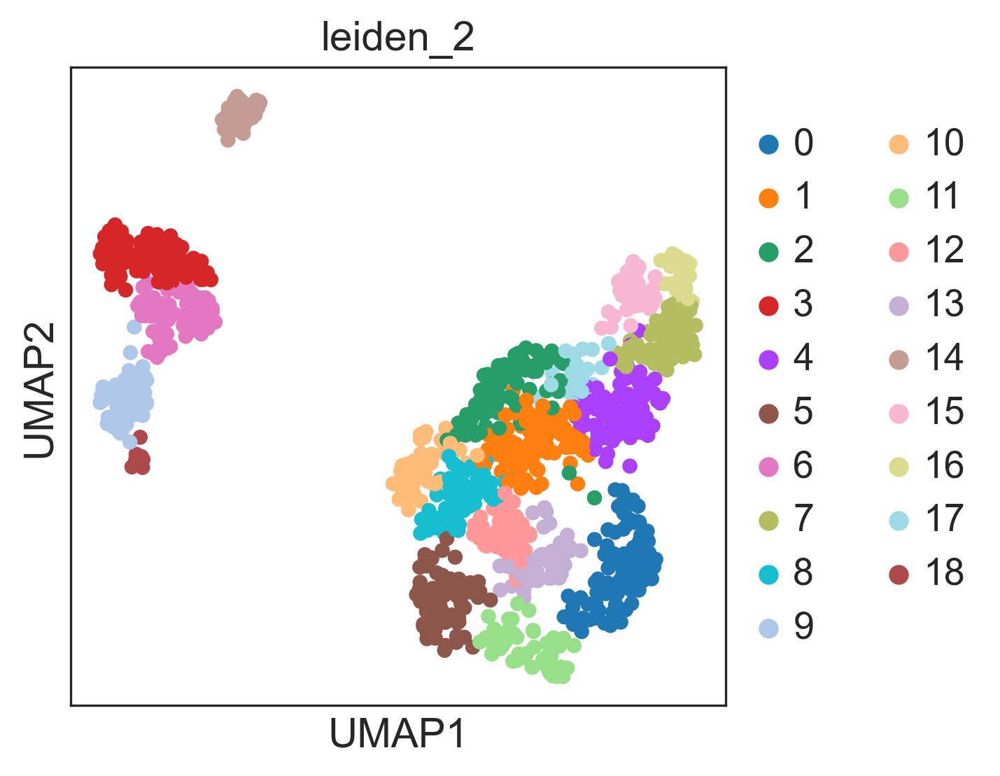

In [785]:
sc.pl.umap(clones, color="leiden_2")

In [794]:
clones.obs["total_Mesenchyme+Other"] = clones.obs[["total_Mesenchyme", "total_Other"]].sum(axis=1)
clones.obs["total_Neurons+Glia"] = clones.obs[["total_Neurons", "total_Glia"]].sum(axis=1)

In [877]:
from skbio.diversity.alpha import shannon

clones.obs["shannon_l2"] = [
    shannon(
        clones.X[i, :]
    ) for i in range(len(clones))
]

clones.obs["shannon_l0"] = [
    shannon(
        clones.obs[["total_Mesenchyme", "total_Neurons", "total_Other", "total_Glia"]].values[i, :]
    ) for i in range(len(clones))
]

clones.obs["lg_clone_size"] = np.log10(clones.obs["clone_size"])

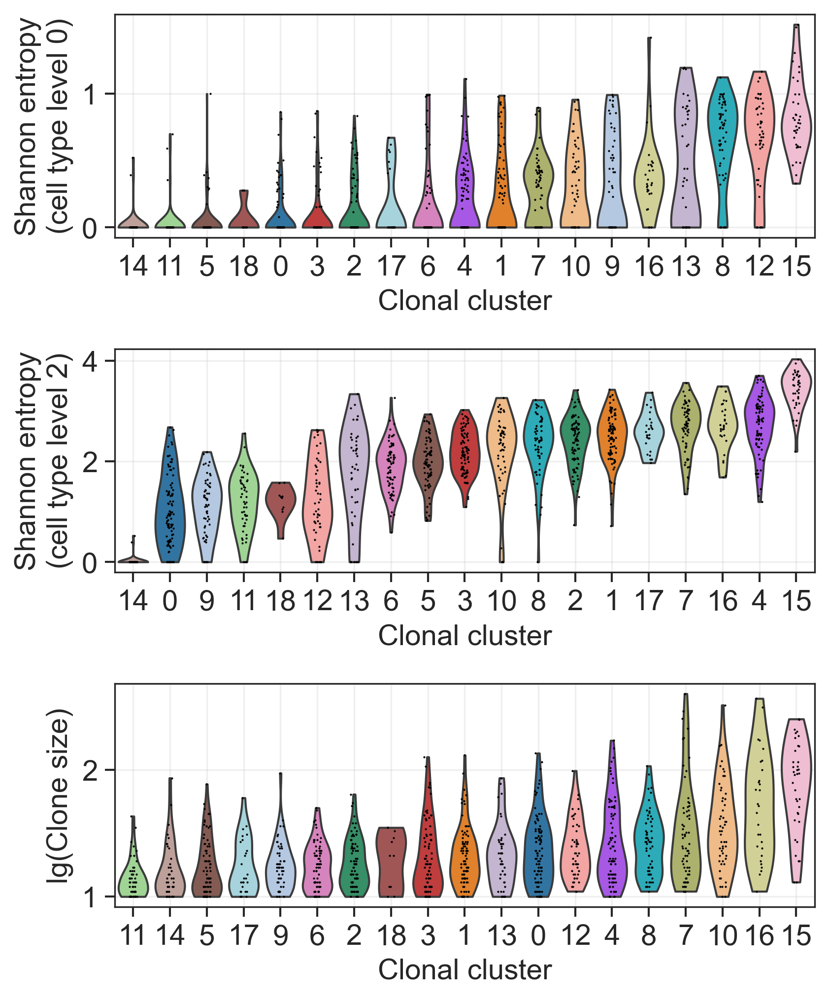

In [983]:
fig, axes = plt.subplots(nrows=3, figsize=(6, 7))

ax = axes[0]
order = clones.obs[["leiden_2", "shannon_l0"]].groupby("leiden_2").mean().sort_values("shannon_l0").index
sc.pl.violin(clones, keys=["shannon_l0"], groupby="leiden_2", ax=ax, show=False, order=order)
ax.grid(alpha=0.3)
ax.set_xlabel("Clonal cluster")
ax.set_ylabel("Shannon entropy\n(cell type level 0)")

ax = axes[1]
order = clones.obs[["leiden_2", "shannon_l2"]].groupby("leiden_2").mean().sort_values("shannon_l2").index
sc.pl.violin(clones, keys=["shannon_l2"], groupby="leiden_2", ax=ax, show=False, order=order)
ax.grid(alpha=0.3)
ax.set_xlabel("Clonal cluster")
ax.set_ylabel("Shannon entropy\n(cell type level 2)")

ax = axes[2]
order = clones.obs[["leiden_2", "lg_clone_size"]].groupby("leiden_2").mean().sort_values("lg_clone_size").index
sc.pl.violin(clones, keys=["lg_clone_size"], groupby="leiden_2", ax=ax, show=False, order=order)
ax.grid(alpha=0.3)
ax.set_xlabel("Clonal cluster")
ax.set_ylabel("lg(Clone size)")

fig.tight_layout()
plt.savefig("../figures/fig2/shannon_violin.pdf", bbox_inches="tight")

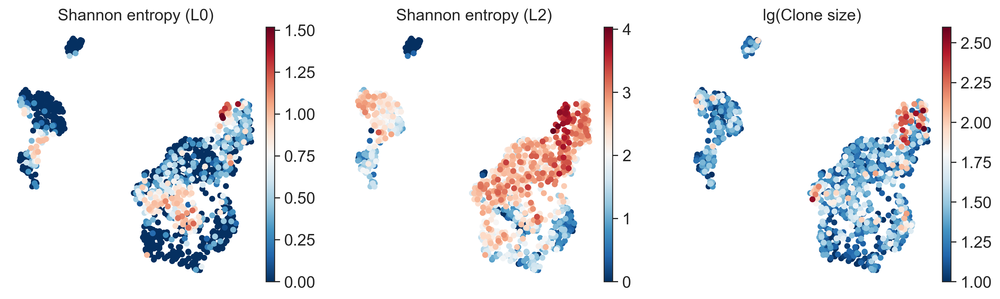

In [985]:
sc.pl.umap(
    clones,
    color=["shannon_l0", "shannon_l2", "lg_clone_size"],
    title=["Shannon entropy (L0)", "Shannon entropy (L2)", "lg(Clone size)"],
    cmap="RdBu_r",
    save="shannon_umap.pdf",
    frameon=False,
)

In [1010]:
!rm ../figures/NMPs_part_UMAP.pdf

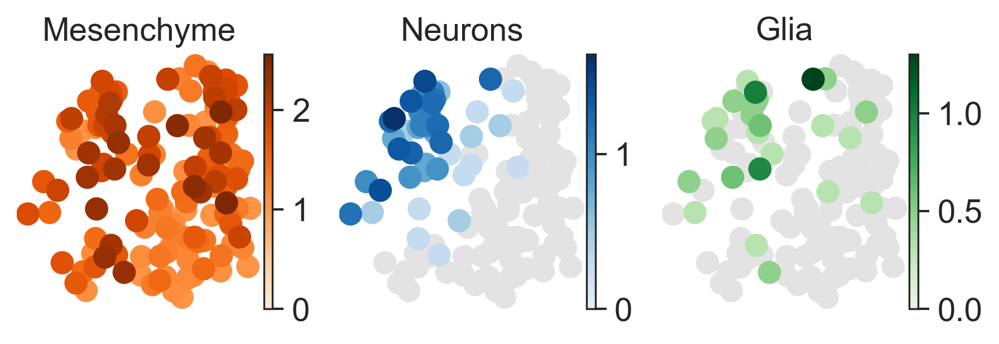

In [1009]:
clones_subset = clones[clones.obs.leiden_2.isin(["15", "16", "7"])]

fig, axes = plt.subplots(figsize=(7, 2), ncols=3)

sc.pl.umap(clones_subset, color="log_total_Mesenchyme", ax=axes[0], show=False, s=400,
           frameon=False, vmin=0, title="Mesenchyme", cmap=mb.pl.beautiful_cmap("Oranges"))
sc.pl.umap(clones_subset, color="log_total_Neurons", ax=axes[1], show=False, s=400,
           frameon=False, vmin=0, title="Neurons", cmap=mb.pl.beautiful_cmap("Blues"))
sc.pl.umap(clones_subset, color="log_total_Glia", ax=axes[2], show=False, s=400,
           frameon=False, vmin=0, title="Glia", cmap=mb.pl.beautiful_cmap("Greens"))

plt.savefig("../figures/fig2/NMPs_part_UMAP.pdf", bbox_inches="tight")

In [892]:
for ct_l0 in ["Mesenchyme", "Glia", "Neurons", "Other"]:
    clones.obs[f"log_total_{ct_l0}"] = np.log10(clones.obs[f"total_{ct_l0}"] + 1)

In [1016]:
clones_face = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_face_E13/E13_face_clonal_embedding.h5ad")
adata_face_mes = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_face_E13/face_mes_E13_clonal_clusters.h5ad")

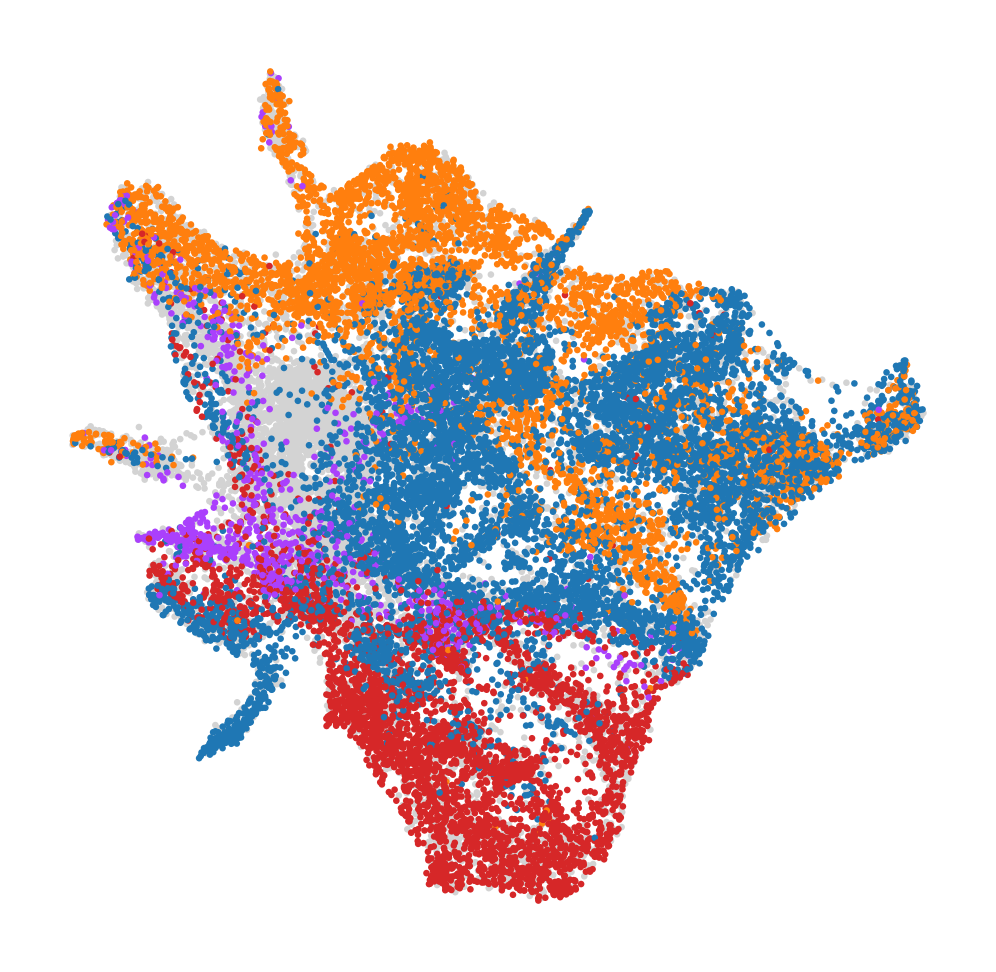

In [1036]:
sc.pl.umap(adata_face_mes, color="clones_clusters_0.5", groups=["0", "1", "3", "4"],
           na_in_legend=False, s=10, frameon=False, title="", legend_loc=None,
           save="facial_umap_clonal_clusters.pdf")

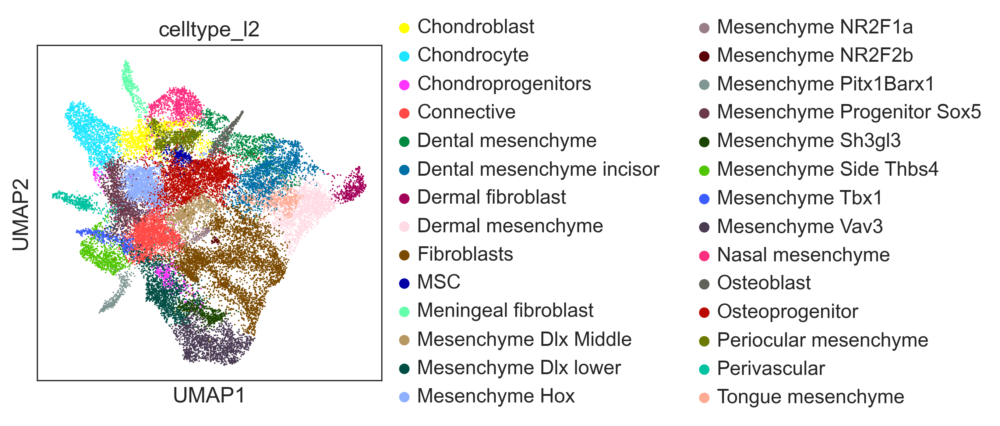

In [1046]:
sc.pl.umap(adata_face_mes, color="celltype_l2")

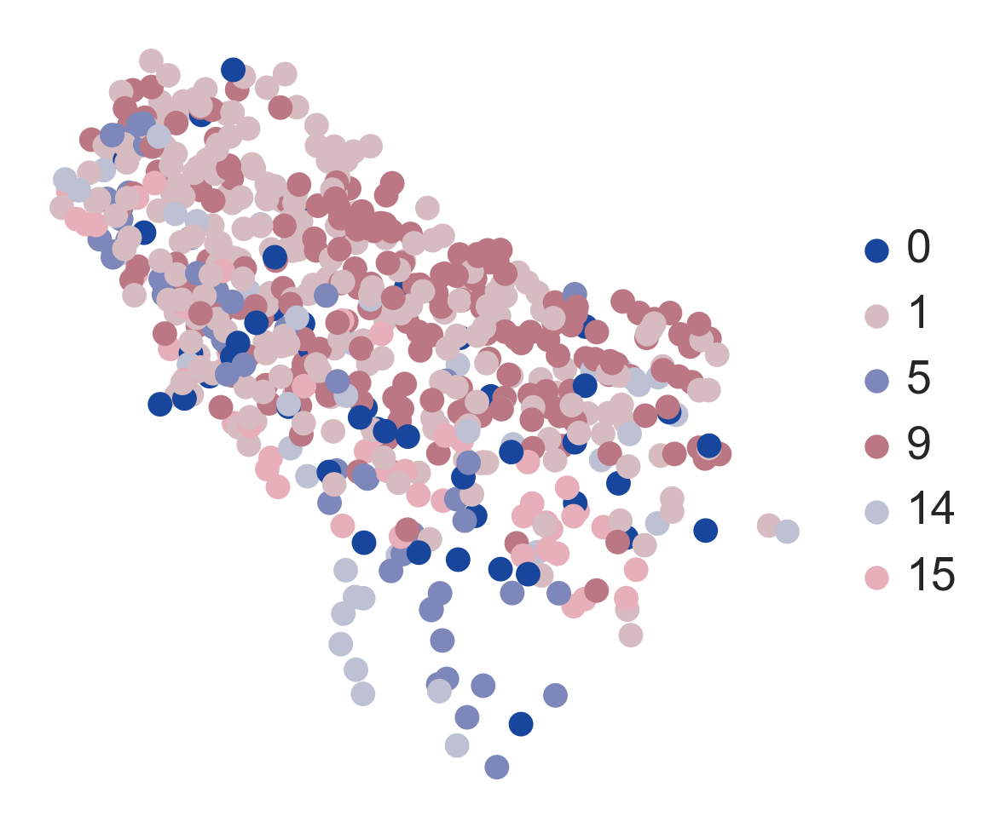

In [1055]:
adata_face_mes_subset = adata_face_mes[
    (adata_face_mes.obs.celltype_l2 == "Chondrocyte") &
    adata_face_mes.obs.clones_clusters_2.isin(["0", "5", "14", "1", "9", "15"])
]

adata_face_mes_subset.uns["clones_clusters_2_colors"] = [
    "#18469D", "#D6BCC0", "#7D87B9", "#BB7783", "#BEC1D4", "#E6AFB9"
]
sc.pl.umap(adata_face_mes_subset, color="clones_clusters_2", frameon=False, title="",
           save="cartilage_UMAP_new.pdf")

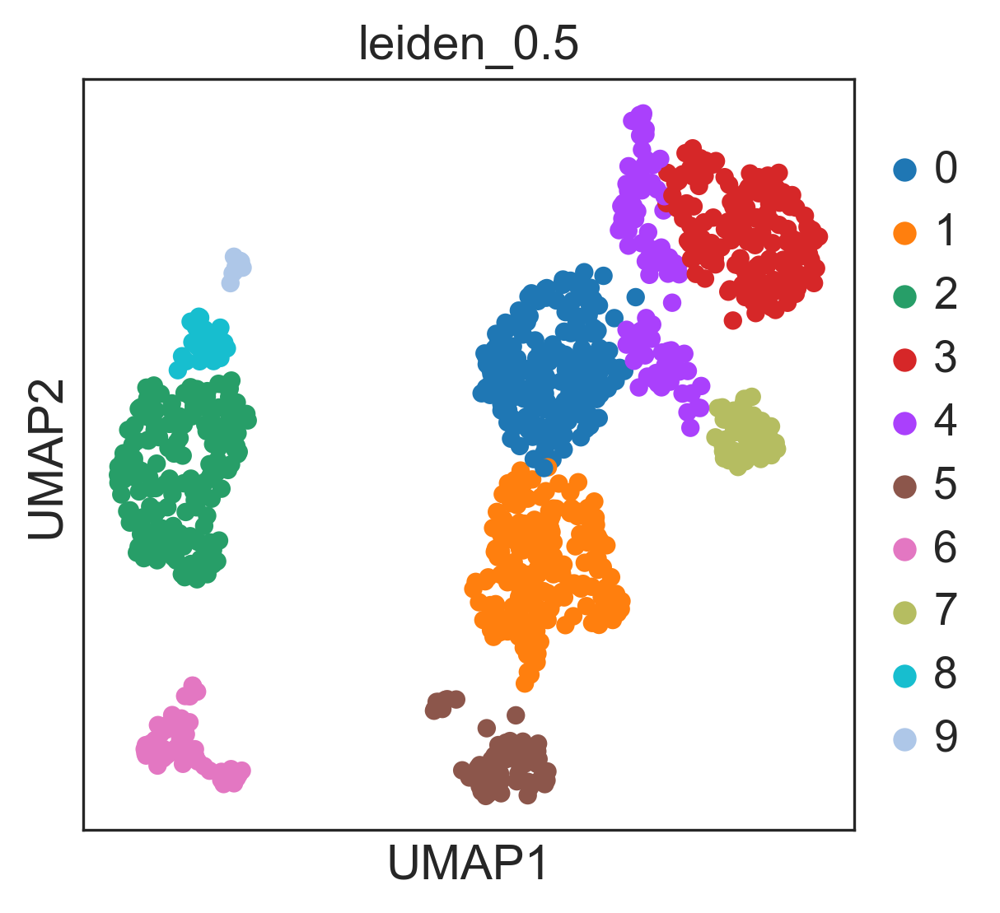

In [1025]:
sc.pl.umap(adata_face_mes, color="clones_clusters_0.5", groups=["0", "1", "3", "4"],
           na_in_legend=False, s=10, frameon=False, title="", legend_loc=None,
           save="facial_umap_clonal_clusters.pdf")

## CLiNC

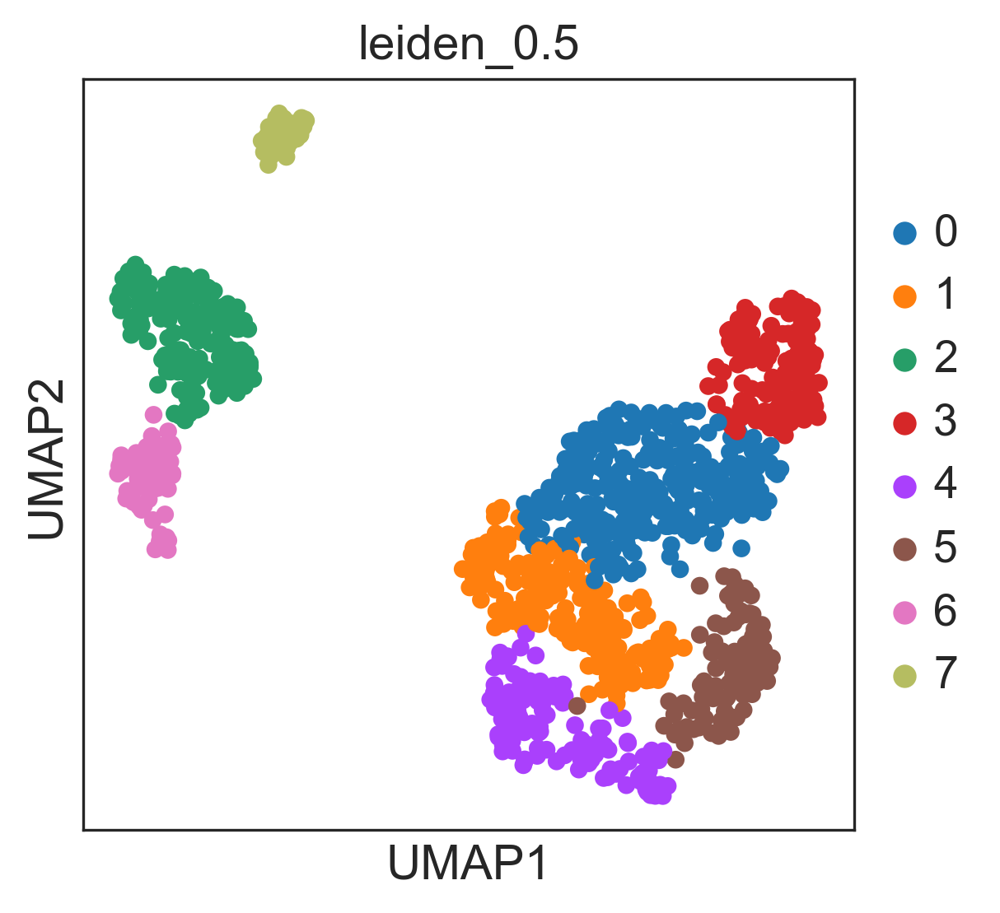

In [721]:
sc.pl.umap(clones, color="leiden_0.5")

In [728]:
import clinc.clinc_util as cu

df_clones = clones.to_df().astype(int)
df_clones = df_clones[df_clones.columns[df_clones.sum(axis=0) > 5]]
X = cu.get_normalized_covariance(df_clones.values)
parent_map, node_groups, plot_data = cu.build_hierarchy(df_clones.values)
cu.print_hierarchy(parent_map, df_clones.columns)


                        /-VSMC
                     /-|
                  /-|   \-Duct mesenchyme
                 |  |
                 |   \-Cardiac fibroblasts
                 |
               /-|         /-Kidney
              |  |      /-|
              |  |   /-|   \-Epicardium
              |  |  |  |
            /-|   \-|   \-Endothelial cells
           |  |     |
           |  |      \-Epithelial cells
         /-|  |
        |  |   \-Visceral mesenchyme
        |  |
        |  |   /-Immune cells
        |   \-|
        |      \-Erythrocytes
        |
        |                              /-Tenocytes
        |                           /-|
        |                        /-|   \-Dermal mesenchyme
        |                       |  |
        |                     /-|   \-Preskeletal chondro IVD
        |                    |  |
        |                  /-|   \-IVD
        |                 |  |
        |               /-|   \-Connective mesenchyme
      /-|              